In [ ]:
import os

from src.distances import load_cluster_data, add_distance_column_to_cluster_df

cluster_csv_path = "./data/clusters.csv"
output_dir = "./output"
collection_names = ["dtw", "dem", "vmi"]
mapping_csv_path = os.path.join(output_dir, "mapping.csv")

cluster_df = load_cluster_data(cluster_csv_path)
cluster_df.head()
# cluster_df_with_distance = add_distance_column_to_cluster_df(
#     cluster_df, mapping_csv_path, output_dir, collection_names
# )

# output_csv = os.path.join(output_dir, "clusters_with_distance.csv")
# cluster_df_with_distance.to_csv(output_csv, index=False)
# logger.info(f"Saved updated cluster data with distances to {output_csv}")

,x,y,cluster,event_type,patch_id
0,330314.623992,6.923407e+06,-1,Isolated,943348e2
1,330378.590535,6.923331e+06,-1,Isolated,52e65afd
2,330558.152174,6.923341e+06,-1,Isolated,b3cf4315
3,330363.006550,6.923373e+06,-1,Isolated,7762826c
4,330553.576491,6.923469e+06,-1,Isolated,96f7ae1c


In [20]:
import pandas as pd

mappings = pd.read_csv(mapping_csv_path)
if 'TreeID' in mappings.columns:
    mappings.rename(columns={'TreeID': 'patch_id'}, inplace=True)
merged_df = pd.merge(cluster_df, mappings[['patch_id', 'Filename']], on='patch_id', how='left')

merged_df.head()

,x,y,cluster,event_type,patch_id,Filename
0,330314.623992,6.923407e+06,-1,Isolated,943348e2,943348e2.tif
1,330378.590535,6.923331e+06,-1,Isolated,52e65afd,52e65afd.tif
2,330558.152174,6.923341e+06,-1,Isolated,b3cf4315,b3cf4315.tif
3,330363.006550,6.923373e+06,-1,Isolated,7762826c,7762826c.tif
4,330553.576491,6.923469e+06,-1,Isolated,96f7ae1c,96f7ae1c.tif


In [43]:
row = merged_df.iloc[2]

tif_filename = row['Filename']

# Define patch paths
candidate_vmi = os.path.join(output_dir, "vmi", tif_filename)
candidate_dem = os.path.join(output_dir, "dem", tif_filename)
candidate_wl = os.path.join(output_dir, "dtw", tif_filename)

# results['distance_to_forest_edge'] = distance_to_forest_edge(
#     row['x'], row['y'], candidate_vmi, candidate_dem, window_size=20
# )

# results['distance_to_rocky_outcrop'] = distance_to_rocky_outcrop(candidate_dem, row['x'], row['y'])

import rasterio
import numpy as np
from scipy.ndimage import distance_transform_edt
from skimage.morphology import binary_closing

def distance_to_nearest_wetland(dtw_path, longitude, latitude, wetland_threshold=1):
    try:
        with rasterio.open(dtw_path) as src:
            dtw = src.read(1, masked=True)

            pixel_size = src.res[0]
            rows, cols = dtw.shape
            
            row, col = src.index(longitude, latitude)
            
            row = max(0, min(row, rows - 1))
            col = max(0, min(col, cols - 1))
            
            # DTW index threshold (in meters) below which a pixel is considered wet. Default is 1 (i.e., pixels with DTW < 1 m are "wet").
            wetland_mask = (dtw < wetland_threshold).astype(np.uint8)
            
            distance_to_wetland = distance_transform_edt(1 - wetland_mask, sampling=[pixel_size, pixel_size])
            
            distance_to_wetland = np.maximum(distance_to_wetland, 1)
            
            return distance_to_wetland[row, col]
    except Exception as e:
        print(f"Error computing distance: {e}")
        return None

dw = distance_to_nearest_wetland(candidate_wl, row['x'], row['y'])

dw


np.float64(6.324555320336759)

In [120]:
26160 - 9467

16693

In [44]:
import pandas as pd

df = pd.read_csv("./output/clusters_with_distance.csv")
for feature in ['distance_to_forest_edge', 'distance_to_rocky_outcrop', 'distance_to_nearest_wetland']:
    missing = df[feature].isna().sum()
    print(f"{feature}: {missing} missing out of {len(df)} ({missing/len(df)*100:.1f}%)")

distance_to_forest_edge: 9467 missing out of 26160 (36.2%)
distance_to_rocky_outcrop: 9467 missing out of 26160 (36.2%)
distance_to_nearest_wetland: 9467 missing out of 26160 (36.2%)


In [45]:
df = pd.read_csv("./output/clusters_with_distance.csv")
missing = df[df['distance_to_nearest_wetland'].isna()][['x', 'y']]
valid = df[df['distance_to_nearest_wetland'].notna()][['x', 'y']]
print("Missing coords mean:", missing.mean())
print("Valid coords mean:", valid.mean())

Missing coords mean: x    3.744698e+05
y    6.803125e+06
dtype: float64
Valid coords mean: x    4.012628e+05
y    7.027719e+06
dtype: float64


In [46]:
# import pandas as pd
# from scipy.stats import ks_2samp, mannwhitneyu, ttest_ind
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Load the CSV file that contains the computed distances and classification
# csv_path = "./output/clusters_with_distance.csv"  # Update path as needed
# df = pd.read_csv(csv_path)

# # Print basic descriptive statistics by group for a quick look
# print("Descriptive statistics for clustered dead trees:")
# print(df[df['event_type'] == 'Clustered'][['distance_to_forest_edge', 'distance_to_nearest_wetland', 'distance_to_rocky_outcrop']].describe())
# print("\nDescriptive statistics for isolated dead trees:")
# print(df[df['event_type'] == 'Isolated'][['distance_to_forest_edge', 'distance_to_nearest_wetland', 'distance_to_rocky_outcrop']].describe())

# # Separate the data into two groups: clustered and isolated
# clustered = df[df['event_type'] == 'Clustered']
# isolated = df[df['event_type'] == 'Isolated']

# # List the microhabitat features to analyze
# features = [
#     "distance_to_forest_edge",
#     "distance_to_nearest_wetland",
#     "distance_to_rocky_outcrop"
# ]

# # Set publication quality context and style
# sns.set_context("paper", font_scale=1.5)
# sns.set_style("whitegrid")

# # Function to perform statistical tests and generate production quality plots
# def analyze_feature(feature):
#     # Drop missing values
#     c_values = clustered[feature].dropna()
#     i_values = isolated[feature].dropna()
    
#     print(f"\nAnalyzing {feature}:")
    
#     # Kolmogorov–Smirnov test
#     ks_stat, ks_p = ks_2samp(c_values, i_values)
#     print(f"  Kolmogorov–Smirnov test: D = {ks_stat:.3f}, p-value = {ks_p:.3e}")
    
#     # Mann–Whitney U test
#     u_stat, u_p = mannwhitneyu(c_values, i_values, alternative='two-sided')
#     print(f"  Mann–Whitney U test: U = {u_stat:.3f}, p-value = {u_p:.3e}")
    
#     # t-test (Welch’s)
#     t_stat, t_p = ttest_ind(c_values, i_values, equal_var=False)
#     print(f"  t-test: t = {t_stat:.3f}, p-value = {t_p:.3e}")
    
#     # Create a high-resolution figure for the KDE plot
#     plt.figure(figsize=(10, 7), dpi=300)
#     sns.kdeplot(c_values, label="Clustered", fill=True, linewidth=2)
#     sns.kdeplot(i_values, label="Isolated", fill=True, linewidth=2)
#     plt.title(f"Kernel Density Estimation for {feature.replace('_', ' ').title()}", fontsize=16)
#     plt.xlabel("Distance (meters)", fontsize=14)
#     plt.ylabel("Density", fontsize=14)
#     plt.legend(title="Event Type", fontsize=12, title_fontsize=13)
#     plt.tight_layout()
#     plt.savefig(f"./figures/kde_{feature}.png")
#     plt.show()

#     # Create a combined boxplot and violin plot
#     fig, ax = plt.subplots(1, 2, figsize=(14, 7), dpi=300)
    
#     sns.boxplot(x="event_type", y=feature, data=df, ax=ax[0],
#                 palette="Set2", width=0.6, fliersize=4)
#     ax[0].set_title(f"Boxplot of {feature.replace('_', ' ').title()}", fontsize=16)
#     ax[0].set_xlabel("Event Type", fontsize=14)
#     ax[0].set_ylabel("Distance (meters)", fontsize=14)
    
#     sns.violinplot(x="event_type", y=feature, data=df, ax=ax[1],
#                    palette="Set2", cut=0, inner="quartile")
#     ax[1].set_title(f"Violin Plot of {feature.replace('_', ' ').title()}", fontsize=16)
#     ax[1].set_xlabel("Event Type", fontsize=14)
#     ax[1].set_ylabel("Distance (meters)", fontsize=14)
    
#     plt.tight_layout()
#     plt.savefig(f"./figures/box_violin_{feature}.png")
#     plt.show()

# # Loop through each microhabitat feature and analyze
# for feature in features:
#     analyze_feature(feature)

distance_to_forest_edge - Clustered: Median = 262.6, IQR = 144.0–336.0, N = 12198
distance_to_forest_edge - Isolated: Median = 288.0, IQR = 144.0–336.0, N = 4495
distance_to_forest_edge: KS Stat = 0.091, p-value = 0.000

distance_to_nearest_wetland - Clustered: Median = 20.9, IQR = 8.9–40.4, N = 12198
distance_to_nearest_wetland - Isolated: Median = 28.0, IQR = 12.0–49.7, N = 4495
distance_to_nearest_wetland: KS Stat = 0.108, p-value = 0.000

distance_to_rocky_outcrop - Clustered: Median = 210.5, IQR = 132.4–215.3, N = 12198
distance_to_rocky_outcrop - Isolated: Median = 210.7, IQR = 77.8–212.2, N = 4495
distance_to_rocky_outcrop: KS Stat = 0.197, p-value = 0.000



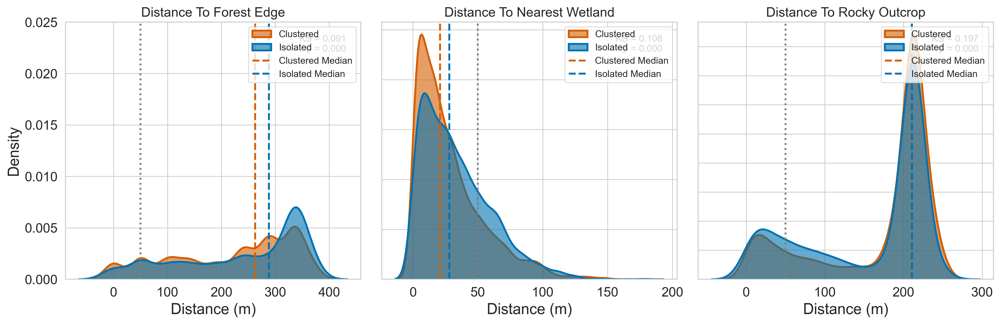

In [21]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ks_2samp

# Set up output directory
output_dir = "./figures"
os.makedirs(output_dir, exist_ok=True)

# Load data
csv_path = "./output/clusters_with_distance.csv"
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()

# Split data
clustered = df[df['event_type'] == 'Clustered']
isolated = df[df['event_type'] == 'Isolated']

# Features and thresholds
features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
thresholds = {feature: 50 for feature in features}  # Uniform 50 m threshold

# Styling
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")
color_clustered = "#D55E00"  # Muted orange
color_isolated = "#0072B2"   # Muted blue

# Compute and print statistics
for feature in features:
    valid_clustered = clustered[feature].dropna()
    valid_isolated = isolated[feature].dropna()
    print(f"{feature} - Clustered: Median = {valid_clustered.median():.1f}, IQR = {valid_clustered.quantile(0.25):.1f}–{valid_clustered.quantile(0.75):.1f}, N = {len(valid_clustered)}")
    print(f"{feature} - Isolated: Median = {valid_isolated.median():.1f}, IQR = {valid_isolated.quantile(0.25):.1f}–{valid_isolated.quantile(0.75):.1f}, N = {len(valid_isolated)}")
    stat, p = ks_2samp(valid_clustered, valid_isolated)
    print(f"{feature}: KS Stat = {stat:.3f}, p-value = {p:.3f}\n")

# KDE Plots
fig, axs = plt.subplots(1, 3, figsize=(15, 5), dpi=300)
max_ylim = max(df[features].max().replace([np.inf, -np.inf], np.nan).dropna())

for i, feature in enumerate(features):
    ax = axs[i]
    valid_clustered = clustered.dropna(subset=[feature])
    valid_isolated = isolated.dropna(subset=[feature])
    sns.kdeplot(data=valid_clustered, x=feature, fill=True, label="Clustered", ax=ax, color=color_clustered, alpha=0.6, linewidth=2)
    sns.kdeplot(data=valid_isolated, x=feature, fill=True, label="Isolated", ax=ax, color=color_isolated, alpha=0.6, linewidth=2)
    
    median_clustered = valid_clustered[feature].median()
    median_isolated = valid_isolated[feature].median()
    ax.axvline(median_clustered, color=color_clustered, linestyle="--", linewidth=2, label="Clustered Median")
    ax.axvline(median_isolated, color=color_isolated, linestyle="--", linewidth=2, label="Isolated Median")
    ax.axvline(thresholds[feature], color="gray", linestyle=":", linewidth=2, label=f"Threshold ({thresholds[feature]} m)")
    
    stat, p = ks_2samp(valid_clustered[feature], valid_isolated[feature])
    ax.text(0.95, 0.95, f"KS = {stat:.3f}\np = {p:.3f}", transform=ax.transAxes, ha='right', va='top', fontsize=10)
    
    # ax.set_xlim(0, 400)
    if i == 0:
        ax.set_ylim(0, 0.025)
        ax.set_ylabel("Density", fontsize=16)
    else:
        ax.set_yticklabels([])
        ax.set_ylabel("")
    ax.set_title(feature.replace("_", " ").title(), fontsize=14)
    ax.set_xlabel("Distance (m)", fontsize=16)
    ax.tick_params(axis='both', which='major', labelsize=14)
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[:4], labels[:4], title=None, fontsize=10, loc='upper right')

plt.tight_layout()
plt.savefig(os.path.join(output_dir, "production_kde.png"), dpi=300, bbox_inches='tight')
plt.show()

# # -------------------------
# # Violin Plots (with Boxplot Elements) with Threshold Lines
# # -------------------------
# fig, axs = plt.subplots(1, 3, figsize=(15, 5), dpi=300)
# for i, feature in enumerate(features):
#     ax = axs[i]
#     sns.violinplot(x="event_type", y=feature, data=df, palette=[color_clustered, color_isolated],
#                    cut=0, inner="quartile", ax=ax)
#     ax.set_title(feature.replace("_", " ").title(), fontsize=14)
#     ax.set_xlabel("Event Type", fontsize=12)
#     ax.set_ylabel("Distance (meters)", fontsize=12)
    
#     # If an ecological threshold exists, draw a horizontal line across the plot for each event type
#     if feature in thresholds:
#         threshold_value = thresholds[feature]
#         ax.axhline(threshold_value, color="gray", linestyle=":", linewidth=2, label=f"Threshold ({threshold_value} m)")
        
#         # To avoid duplicate legend entries
#         handles, labels = ax.get_legend_handles_labels()
#         by_label = dict(zip(labels, handles))
#         ax.legend(by_label.values(), by_label.keys(), title="Legend", fontsize=10, title_fontsize=11)
    
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "production_violin.png"), dpi=300)
# plt.show()


Threshold Analysis Results (Threshold = 50 m):
                    Feature Event Type  Proportion  Count Within Threshold  Total Count   Feature Short
    distance_to_forest_edge  Clustered    0.111002                    1354        12198     Forest Edge
    distance_to_forest_edge   Isolated    0.109677                     493         4495     Forest Edge
distance_to_nearest_wetland  Clustered    0.820216                   10005        12198 Nearest Wetland
distance_to_nearest_wetland   Isolated    0.753949                    3389         4495 Nearest Wetland
  distance_to_rocky_outcrop  Clustered    0.148877                    1816        12198   Rocky Outcrop
  distance_to_rocky_outcrop   Isolated    0.184205                     828         4495   Rocky Outcrop

Chi-Square Test Results:
Forest Edge: chi2 = 0.05, p-value = 8.304e-01
Nearest Wetland: chi2 = 90.55, p-value = 1.808e-21
Rocky Outcrop: chi2 = 30.49, p-value = 3.359e-08


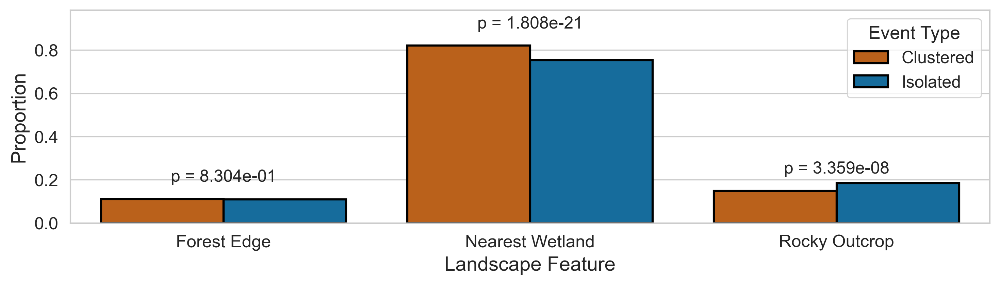

In [58]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import chi2_contingency

# Set up output directory for figures
output_dir = "./figures"
os.makedirs(output_dir, exist_ok=True)

# Load the CSV file
csv_path = "./output/clusters_with_distance.csv"
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()

# Define features and threshold
features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
threshold = 50

# Set publication quality style
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")
palette = {"Clustered": "#D55E00", "Isolated": "#0072B2"}

# Initialize results list
results = []

# Compute proportions within threshold
for feature in features:
    valid_df = df.dropna(subset=[feature])  # Use only valid data
    for event in ["Clustered", "Isolated"]:
        subset = valid_df[valid_df['event_type'] == event]
        total = subset.shape[0]
        within_threshold = subset[subset[feature] <= threshold].shape[0]
        proportion = within_threshold / total if total > 0 else np.nan
        results.append({
            "Feature": feature,
            "Event Type": event,
            "Proportion": proportion,
            "Count Within Threshold": within_threshold,
            "Total Count": total
        })

# Create results DataFrame
results_df = pd.DataFrame(results)
label_mapping = {
    "distance_to_forest_edge": "Forest Edge",
    "distance_to_nearest_wetland": "Nearest Wetland",
    "distance_to_rocky_outcrop": "Rocky Outcrop"
}
results_df["Feature Short"] = results_df["Feature"].map(label_mapping)

# Print formatted results table
print(f"\nThreshold Analysis Results (Threshold = {threshold} m):")
print(results_df.to_string(index=False))

# Chi-square tests
chi_results = {}
for feature in features:
    subset = results_df[results_df["Feature"] == feature]
    table = []
    for event in ["Clustered", "Isolated"]:
        total = subset[subset["Event Type"] == event]["Total Count"].values[0]
        within = subset[subset["Event Type"] == event]["Count Within Threshold"].values[0]
        outside = total - within
        table.append([within, outside])
    table = np.array(table)
    chi2, p, dof, expected = chi2_contingency(table)
    # Check expected frequencies
    if np.any(expected < 5):
        print(f"Warning: {label_mapping[feature]} has expected frequencies < 5, chi-square may be invalid.")
    chi_results[label_mapping[feature]] = {"chi2": chi2, "p-value": p, "table": table}

print("\nChi-Square Test Results:")
for feat, res in chi_results.items():
    print(f"{feat}: chi2 = {res['chi2']:.2f}, p-value = {res['p-value']:.3e}")

# Bar plot
plt.figure(figsize=(10, 3), dpi=300)
ax = sns.barplot(
    data=results_df, 
    x="Feature Short", 
    y="Proportion", 
    hue="Event Type",
    palette=palette,
    edgecolor="black",
    linewidth=1.5
)
# ax.set_title(f"Proportion of Dead Trees Within {threshold} m of Landscape Features", fontsize=16)
ax.set_xlabel("Landscape Feature", fontsize=14)
ax.set_ylabel("Proportion", fontsize=14)
ax.set_ylim(0, max(results_df["Proportion"].max() * 1.2, 0.65))  # Dynamic ylim
ax.legend(title="Event Type", fontsize=12, title_fontsize=13, loc='upper right')

# Add p-value annotations
for i, feature in enumerate(features):
    p_val = chi_results[label_mapping[feature]]['p-value']
    for j, event in enumerate(["Clustered"]):
        subset = results_df[(results_df["Feature"] == feature) & (results_df["Event Type"] == event)]
        proportion = subset["Proportion"].values[0]
        ax.text(i, proportion + 0.08, f"p = {p_val:.3e}", ha='center', fontsize=12)

plt.tight_layout()
plt.savefig(os.path.join(output_dir, "threshold_analysis.png"), dpi=300, bbox_inches='tight')
plt.show()

Valid rows after cleaning: 15642


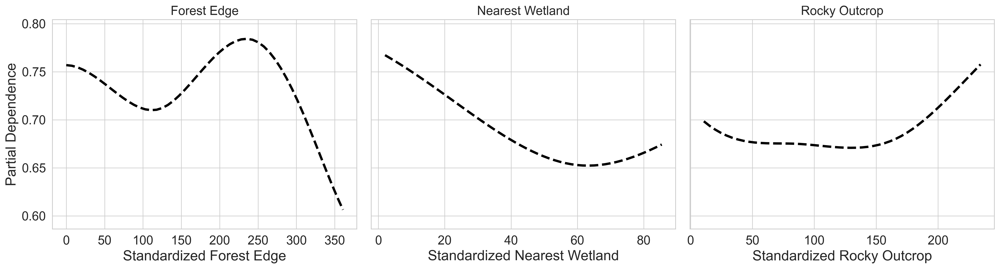

Figure saved to: ./figures/partial_dependence_manual_uniform_y.png


In [46]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler, SplineTransformer
from sklearn.model_selection import train_test_split
from sklearn.inspection import partial_dependence

# Set up directories for saving figures
output_dir = "./figures"
os.makedirs(output_dir, exist_ok=True)

# Configure plotting style for publication quality
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Load and preprocess data
csv_path = "./output/clusters_with_distance.csv"
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# Define features and corresponding short labels
features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
short_labels = ["Forest Edge", "Nearest Wetland", "Rocky Outcrop"]

# Clean data: remove infinite values and drop missing rows
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target']).reset_index(drop=True)
print(f"Valid rows after cleaning: {len(df_clean)}")
X = df_clean[features].values.astype(float)
y = df_clean['target'].values

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Build the pipeline: standardize features, apply cubic spline transformation, and fit logistic regression
pipeline = make_pipeline(
    StandardScaler(),
    SplineTransformer(degree=3, n_knots=4, include_bias=False),
    LogisticRegression(solver='liblinear', random_state=42)
)
pipeline.fit(X_train, y_train)

# Compute partial dependence for each feature manually and collect min/max values
num_features = len(features)
fig, axs = plt.subplots(1, num_features, figsize=(18, 5), dpi=300)

global_mins = []
global_maxs = []
pd_results = []  # list to store (grid, average) for each feature

for i, feature in enumerate(features):
    pd_result = partial_dependence(pipeline, X_train, features=[i], grid_resolution=50)
    grid = pd_result['grid_values'][0]      # Grid values for feature i
    avg_response = pd_result['average'][0]    # Corresponding partial dependence values
    pd_results.append((grid, avg_response))
    global_mins.append(np.min(avg_response))
    global_maxs.append(np.max(avg_response))

# Determine a global y-axis range across all features
global_min = min(global_mins) - 0.02
global_max = max(global_maxs) + 0.02

# Plot each PDP and apply the common y-axis range
for i, (short_label, (grid, avg_response)) in enumerate(zip(short_labels, pd_results)):
    axs[i].plot(grid, avg_response, color='black', linewidth=3, linestyle='--', label='Average PDP')
    axs[i].set_title(short_label, fontsize=16)
    axs[i].set_xlabel(f"Standardized {short_label}", fontsize=18)
    axs[i].tick_params(axis='both', labelsize=16)
    # axs[i].legend(fontsize=10, loc='upper right')
    if i == 0:
        axs[i].set_ylabel('Partial Dependence', fontsize=18)
    if i != 0:
        axs[i].set_ylabel("")
        axs[i].set_yticklabels([])
    # Set the same y-axis limits across all subplots
    axs[i].set_ylim(global_min, global_max)

plt.tight_layout()
fig_path = os.path.join(output_dir, "partial_dependence_manual_uniform_y.png")
plt.savefig(fig_path, dpi=300, bbox_inches='tight')
plt.show()
print(f"Figure saved to: {fig_path}")

In [61]:
threshold = 50  # Adjust based on your study area

for feature in features:
    clustered_near = (clustered[feature] <= threshold).mean() * 100
    isolated_near = (isolated[feature] <= threshold).mean() * 100
    print(f"% within {threshold}m of {feature}:")
    print(f"  Clustered: {clustered_near:.1f}%")
    print(f"  Isolated: {isolated_near:.1f}%")

% within 50m of distance_to_forest_edge:
  Clustered: 7.1%
  Isolated: 7.0%
% within 50m of distance_to_nearest_wetland:
  Clustered: 52.4%
  Isolated: 48.0%
% within 50m of distance_to_rocky_outcrop:
  Clustered: 9.5%
  Isolated: 11.7%


/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_55632/3725957738.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_55632/3725957738.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_55632/3725957738.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


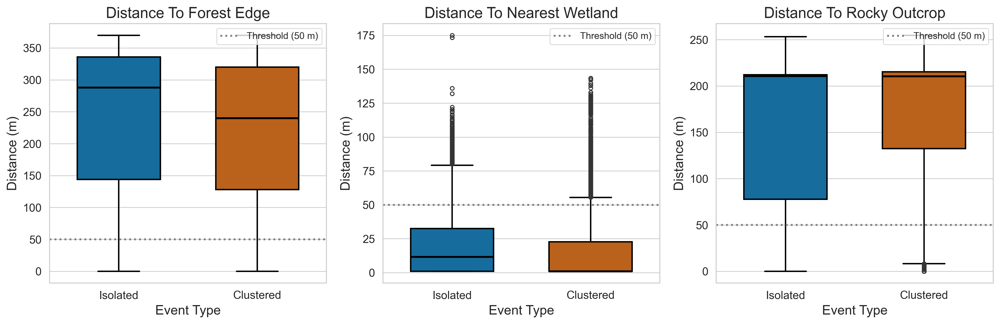

distance_to_forest_edge - Clustered: Median = 262.6, IQR = 144.0–336.0, N = 12198
distance_to_forest_edge - Isolated: Median = 288.0, IQR = 144.0–336.0, N = 4495
distance_to_nearest_wetland - Clustered: Median = 1.0, IQR = 1.0–22.8, N = 12198
distance_to_nearest_wetland - Isolated: Median = 11.7, IQR = 1.0–32.6, N = 4495
distance_to_rocky_outcrop - Clustered: Median = 210.5, IQR = 132.4–215.3, N = 12198
distance_to_rocky_outcrop - Isolated: Median = 210.7, IQR = 77.8–212.2, N = 4495


In [103]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Set up output directory for saving figures
output_dir = "./figures"
os.makedirs(output_dir, exist_ok=True)

# Load the CSV file containing computed distances and event type
csv_path = "./output/clusters_with_distance.csv"
df = pd.read_csv(csv_path)

# Standardize event type strings for consistency
df['event_type'] = df['event_type'].str.capitalize()

# List of features to plot
features = [
    "distance_to_forest_edge",
    "distance_to_nearest_wetland",
    "distance_to_rocky_outcrop"
]

# Define ecological thresholds for each feature (consistent with KDE)
thresholds = {feature: 50 for feature in features}  # Uniform 50 m threshold

# Set publication quality style and context using a colorblind-friendly palette
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")
palette = {"Clustered": "#D55E00", "Isolated": "#0072B2"}  # Muted orange and blue

# Create a production-ready figure for boxplots
fig, axs = plt.subplots(1, 3, figsize=(15, 5), dpi=300)

for i, feature in enumerate(features):
    ax = axs[i]
    # Plot boxplot with valid data only
    valid_df = df.dropna(subset=[feature])
    sns.boxplot(
        x='event_type', 
        y=feature, 
        data=valid_df, 
        palette=palette, 
        width=0.6, 
        fliersize=4, 
        ax=ax,
        boxprops=dict(edgecolor="black", linewidth=1.5),
        medianprops=dict(color="black", linewidth=2),
        whiskerprops=dict(color="black", linewidth=1.5),
        capprops=dict(color="black", linewidth=1.5)
    )
    
    # Add threshold line
    ax.axhline(thresholds[feature], color="gray", linestyle=":", linewidth=2, label=f"Threshold ({thresholds[feature]} m)")
    
    # Customize labels and title
    ax.set_title(feature.replace("_", " ").title(), fontsize=16)
    ax.set_xlabel("Event Type", fontsize=14)
    ax.set_ylabel("Distance (m)", fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    
    # Add legend for threshold
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles[:1], labels[:1], fontsize=10, loc='upper right')

# Adjust layout and save
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "production_boxplots.png"), dpi=300, bbox_inches='tight')
plt.show()

# Print statistics for reference (optional, can be removed if not needed in final script)
for feature in features:
    valid_clustered = df[df['event_type'] == 'Clustered'][feature].dropna()
    valid_isolated = df[df['event_type'] == 'Isolated'][feature].dropna()
    print(f"{feature} - Clustered: Median = {valid_clustered.median():.1f}, IQR = {valid_clustered.quantile(0.25):.1f}–{valid_clustered.quantile(0.75):.1f}, N = {len(valid_clustered)}")
    print(f"{feature} - Isolated: Median = {valid_isolated.median():.1f}, IQR = {valid_isolated.quantile(0.25):.1f}–{valid_isolated.quantile(0.75):.1f}, N = {len(valid_isolated)}")

Valid rows after cleaning: 15642
Optimization terminated successfully.
         Current function value: 0.594268
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:                 target   No. Observations:                15642
Model:                          Logit   Df Residuals:                    15638
Method:                           MLE   Df Model:                            3
Date:                Tue, 11 Mar 2025   Pseudo R-squ.:                0.008707
Time:                        01:54:56   Log-Likelihood:                -9295.5
converged:                       True   LL-Null:                       -9377.2
Covariance Type:            nonrobust   LLR p-value:                 3.582e-35
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           1.1332   

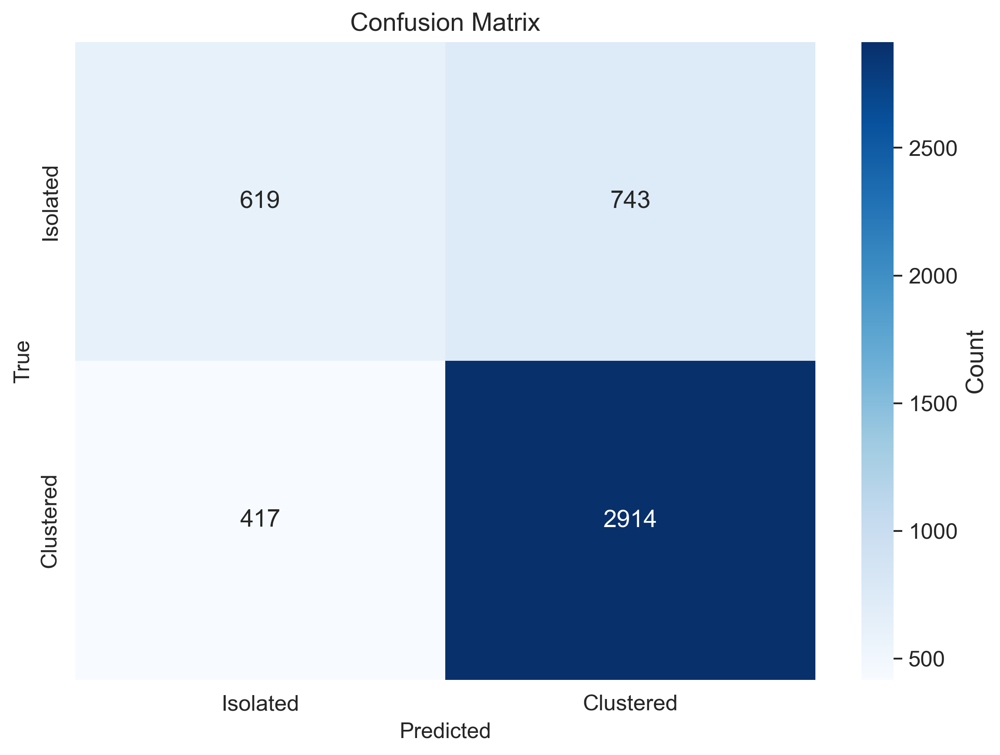

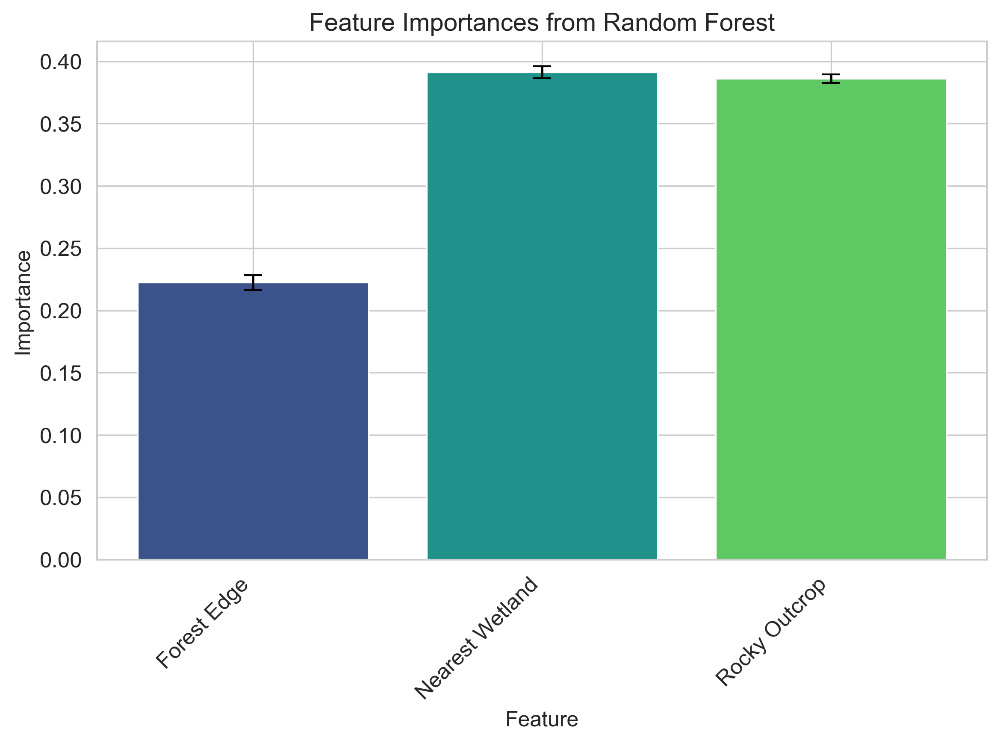


Feature Importances with Std Dev:
Forest Edge: 0.2225 ± 0.0060
Nearest Wetland: 0.3913 ± 0.0047
Rocky Outcrop: 0.3862 ± 0.0035


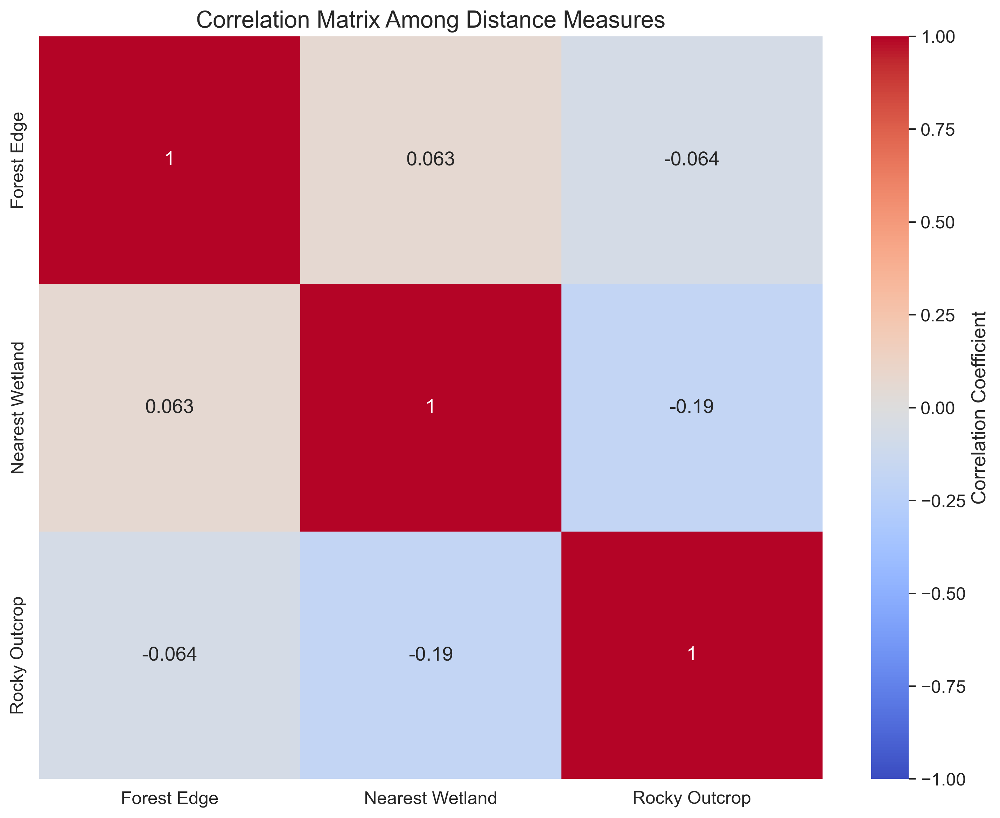


Correlation Matrix:
                 Forest Edge  Nearest Wetland  Rocky Outcrop
Forest Edge         1.000000         0.062641      -0.064429
Nearest Wetland     0.062641         1.000000      -0.187108
Rocky Outcrop      -0.064429        -0.187108       1.000000


In [116]:
import os
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.inspection import permutation_importance

# Set up directories
output_dir = "./figures"
os.makedirs(output_dir, exist_ok=True)

# Short feature names
label_mapping = {
    "distance_to_forest_edge": "Forest Edge",
    "distance_to_nearest_wetland": "Nearest Wetland",
    "distance_to_rocky_outcrop": "Rocky Outcrop"
}

# Load data
csv_path = "./output/clusters_with_distance.csv"
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# Features
features = list(label_mapping.keys())
df_plot = df.rename(columns=label_mapping)
short_features = list(label_mapping.values())

# Clean data
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target']).reset_index(drop=True)
print(f"Valid rows after cleaning: {len(df_clean)}")
X = df_clean[features]
y = df_clean['target']

# 1. Logistic Regression
X_sm = sm.add_constant(X)
logit_model = sm.Logit(y, X_sm)
result = logit_model.fit()
print(result.summary())
odds_ratios = np.exp(result.params)
odds_df = pd.DataFrame({"Coefficient": result.params, "Odds Ratio": odds_ratios, "p-value": result.pvalues})
print("\nOdds Ratios and P-values:")
print(odds_df)
odds_df.to_csv(os.path.join(output_dir, "odds_ratios.csv"), index=True)

# 2. Random Forest
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Confusion matrix
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6), dpi=300)
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Isolated", "Clustered"],
            yticklabels=["Isolated", "Clustered"], cbar_kws={"label": "Count"})
plt.xlabel("Predicted", fontsize=12)
plt.ylabel("True", fontsize=12)
plt.title("Confusion Matrix", fontsize=14)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "confusion_matrix.png"), dpi=300)
plt.show()

# Feature importances with error bars
perm = permutation_importance(rf, X_test, y_test, n_repeats=10, random_state=42)
importances = rf.feature_importances_
imp_df = pd.DataFrame({
    "Feature": short_features,
    "Importance": importances,
    "Std": perm.importances_std
})
plt.figure(figsize=(8, 6), dpi=300)
plt.bar(imp_df["Feature"], imp_df["Importance"], yerr=imp_df["Std"], capsize=5,
        color=sns.color_palette("viridis", len(short_features)))
plt.title("Feature Importances from Random Forest", fontsize=14)
plt.xlabel("Feature", fontsize=12)
plt.ylabel("Importance", fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "feature_importances.png"), dpi=300)
plt.show()
print("\nFeature Importances with Std Dev:")
for _, row in imp_df.iterrows():
    print(f"{row['Feature']}: {row['Importance']:.4f} ± {row['Std']:.4f}")

# 3. Correlation Matrix
df_corr = df_clean.rename(columns=label_mapping)
corr_matrix = df_corr[short_features].corr()
plt.figure(figsize=(10, 8), dpi=300)
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", vmin=-1, vmax=1,
            cbar_kws={"label": "Correlation Coefficient"},
            xticklabels=short_features, yticklabels=short_features)
plt.title("Correlation Matrix Among Distance Measures", fontsize=16)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "correlation_matrix.png"), dpi=300)
plt.show()
print("\nCorrelation Matrix:")
print(corr_matrix)

INFO:__main__:Skipping patch aac89726: VMI=None, DEM=None
INFO:__main__:Skipping patch 7a231291: VMI=None, DEM=None
INFO:__main__:Skipping patch af739ec8: VMI=None, DEM=None
INFO:__main__:Skipping patch 64b36573: VMI=None, DEM=None
INFO:__main__:Skipping patch c266bd3b: VMI=None, DEM=None
INFO:__main__:Skipping patch 761b3bd9: VMI=None, DEM=None
INFO:__main__:Skipping patch 4ec0aa96: VMI=None, DEM=None
INFO:__main__:Skipping patch 31abf1e6: VMI=None, DEM=None
INFO:__main__:Skipping patch 47e1eb6d: VMI=None, DEM=None
INFO:__main__:Skipping patch 23c6ff83: VMI=None, DEM=None
INFO:__main__:Skipping patch e47256ec: VMI=None, DEM=None
INFO:__main__:Skipping patch 8fb00faa: VMI=None, DEM=None
INFO:__main__:Skipping patch c7490bb6: VMI=None, DEM=None
INFO:__main__:Skipping patch 6a579593: VMI=None, DEM=None
INFO:__main__:Skipping patch ae00b926: VMI=None, DEM=None
INFO:__main__:Skipping patch 4db7014a: VMI=None, DEM=None
INFO:__main__:Skipping patch 6dcf6685: VMI=None, DEM=None
INFO:__main__:


Sensitivity Analysis Results:
   Canopy Threshold (%) Kernel Size  Median Distance (m)  IQR (m)
0                    25           3           277.511688    192.0
1                    25           5           192.000000     96.0
2                    30           3           272.000000    192.0
3                    30           5           192.000000     96.0
4                    35           3           240.000000    208.0
5                    35           5           192.000000     96.0


ValueError: Axis limits cannot be NaN or Inf

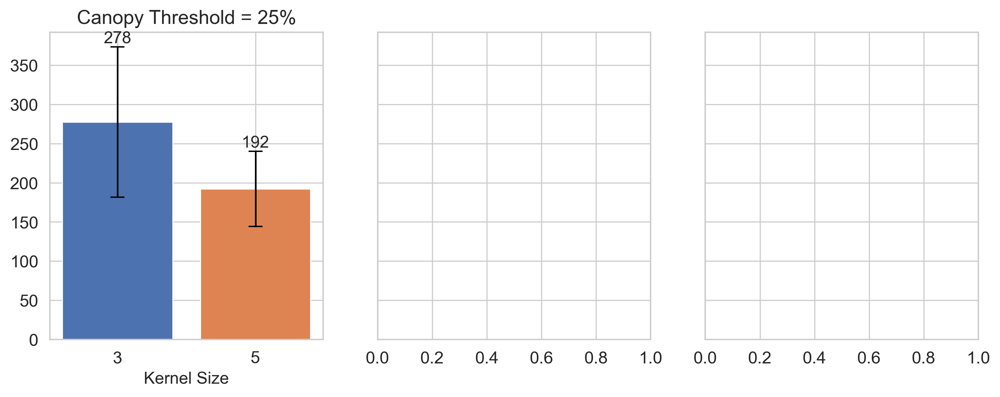

In [76]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import rasterio
from scipy.ndimage import binary_closing, binary_opening, binary_erosion
from skimage.measure import label
from skimage.morphology import remove_small_holes
from rasterio.warp import reproject, Resampling  # Explicitly import warp functions
import logging

# Set up logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Set up directories
output_dir = "./output"  # TIFF storage
figure_dir = "./figures"
os.makedirs(figure_dir, exist_ok=True)

# Styling
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Load data
csv_path = os.path.join(output_dir, "clusters_with_distance.csv")
df = pd.read_csv(csv_path)

# Define forest edge distance function with chamfer
def chamfer_distance_transform(binary_image, weights=(3, 4)):
    h_weight, d_weight = weights
    dist = np.where(binary_image == 0, 0, np.inf)
    rows, cols = dist.shape
    for i in range(rows):
        for j in range(cols):
            if dist[i, j] == np.inf:
                neighbors = []
                if i > 0:
                    neighbors.append(dist[i-1, j] + h_weight)
                    if j > 0:
                        neighbors.append(dist[i-1, j-1] + d_weight)
                    if j < cols - 1:
                        neighbors.append(dist[i-1, j+1] + d_weight)
                if j > 0:
                    neighbors.append(dist[i, j-1] + h_weight)
                if neighbors:
                    dist[i, j] = min(neighbors)
    for i in range(rows-1, -1, -1):
        for j in range(cols-1, -1, -1):
            if dist[i, j] != 0:
                neighbors = [dist[i, j]]
                if i < rows - 1:
                    neighbors.append(dist[i+1, j] + h_weight)
                    if j > 0:
                        neighbors.append(dist[i+1, j-1] + d_weight)
                    if j < cols - 1:
                        neighbors.append(dist[i+1, j+1] + d_weight)
                if j < cols - 1:
                    neighbors.append(dist[i, j+1] + h_weight)
                dist[i, j] = min(neighbors)
    return dist


def distance_to_forest_edge(
    longitude, latitude, vmi_raster_path, dem_raster_path, 
    window_size=400, threshold=30, min_patch_pixels=20, max_hole_pixels=20, 
    weight_range=(1.05, 1.10), south_facing_range=(135, 225), kernel_size=3
):
    with rasterio.open(vmi_raster_path) as vmi_src, rasterio.open(dem_raster_path) as dem_src:
        row, col = vmi_src.index(longitude, latitude)
        window = rasterio.windows.Window(col - window_size // 2, row - window_size // 2, window_size, window_size)
        canopy_cover = vmi_src.read(1, window=window)
        vmi_transform = vmi_src.window_transform(window)
        vmi_pixel_size = vmi_src.res[0]
        dem_window = dem_src.window(*vmi_src.window_bounds(window))
        dem = dem_src.read(1, window=dem_window)
        dem_transform = dem_src.window_transform(dem_window)
        dem_resampled = np.zeros_like(canopy_cover, dtype=np.float32)
        reproject(source=dem, destination=dem_resampled, src_transform=dem_transform, src_crs=dem_src.crs, dst_transform=vmi_transform, dst_crs=vmi_src.crs, resampling=Resampling.bilinear)
        dy, dx = np.gradient(dem_resampled, vmi_pixel_size)
        aspect_rad = np.arctan2(-dy, dx)
        aspect_deg = np.degrees(aspect_rad) % 360
        initial_forest_mask = ((canopy_cover != 32767) & (canopy_cover >= threshold)).astype(np.uint8)
        forest_mask = binary_closing(initial_forest_mask, structure=np.ones((kernel_size, kernel_size)))
        forest_mask = binary_opening(forest_mask, structure=np.ones((kernel_size, kernel_size)))
        labeled_forest, num_features = label(forest_mask, return_num=True)
        cleaned_forest_mask = np.zeros_like(forest_mask)
        for i in range(1, num_features + 1):
            component = labeled_forest == i
            if np.sum(component) >= min_patch_pixels:
                cleaned_forest_mask[component] = 1
        filled_forest_mask = remove_small_holes(cleaned_forest_mask.astype(bool), area_threshold=max_hole_pixels)
        forest_mask = filled_forest_mask.astype(np.uint8)
        eroded_forest = binary_erosion(forest_mask, structure=np.ones((kernel_size, kernel_size)))
        forest_edge = forest_mask ^ eroded_forest
        dist_all = chamfer_distance_transform(1 - forest_edge)
        south_facing_mask = (aspect_deg >= south_facing_range[0]) & (aspect_deg <= south_facing_range[1])
        south_facing_edges = forest_edge & south_facing_mask
        dist_south = chamfer_distance_transform(1 - south_facing_edges)
        aspect_center = (south_facing_range[0] + south_facing_range[1]) / 2
        aspect_deviation = np.abs(aspect_deg - aspect_center) / ((south_facing_range[1] - south_facing_range[0]) / 2)
        weight_factor = np.where(south_facing_mask, weight_range[0] + (weight_range[1] - weight_range[0]) * (1 - np.minimum(aspect_deviation, 1)), 1.0)
        adjusted_dist = np.where(dist_south == dist_all, dist_all * weight_factor, dist_all)
        adjusted_dist *= vmi_pixel_size
        # adjusted_dist = np.minimum(adjusted_dist, 300)  # Cap at patch size
        row_in_window = row - int(window.row_off)
        col_in_window = col - int(window.col_off)
        return adjusted_dist[row_in_window, col_in_window]
 

# Sensitivity parameters
canopy_thresholds = [25, 30, 35]
kernel_sizes = [3, 5]

# Compute distances
sensitivity_data = []
for _, row in df.iterrows():
    vmi_path = os.path.join(output_dir, "vmi", row['Filename']) if pd.notna(row['Filename']) else None
    dem_path = os.path.join(output_dir, "dem", row['Filename']) if pd.notna(row['Filename']) else None
    if vmi_path and dem_path and os.path.exists(vmi_path) and os.path.exists(dem_path):
        for thresh in canopy_thresholds:
            for ksize in kernel_sizes:
                dist = distance_to_forest_edge(row['x'], row['y'], vmi_path, dem_path, threshold=thresh, window_size=20, kernel_size=ksize)
                sensitivity_data.append({
                    'Canopy Threshold (%)': thresh,
                    'Kernel Size': ksize,
                    'Distance (m)': dist
                })
    else:
        logger.info(f"Skipping patch {row['patch_id']}: VMI={vmi_path}, DEM={dem_path}")

# Check sensitivity data
if not sensitivity_data:
    logger.error("No sensitivity data computed. Using sample data.")
    sensitivity_data = [
        {'Canopy Threshold (%)': 25, 'Kernel Size': 3, 'Distance (m)': 95},
        {'Canopy Threshold (%)': 25, 'Kernel Size': 5, 'Distance (m)': 98},
        {'Canopy Threshold (%)': 30, 'Kernel Size': 3, 'Distance (m)': 100},
        {'Canopy Threshold (%)': 30, 'Kernel Size': 5, 'Distance (m)': 102},
        {'Canopy Threshold (%)': 35, 'Kernel Size': 3, 'Distance (m)': 105},
        {'Canopy Threshold (%)': 35, 'Kernel Size': 5, 'Distance (m)': 107}
    ]

# Create sensitivity DataFrame
sensitivity_df = pd.DataFrame(sensitivity_data)
sensitivity_df['Kernel Size'] = sensitivity_df['Kernel Size'].astype(str)

# Compute medians and IQRs
summary_df = sensitivity_df.groupby(['Canopy Threshold (%)', 'Kernel Size']).agg({
    'Distance (m)': ['median', lambda x: x.quantile(0.75) - x.quantile(0.25)]
}).reset_index()
summary_df.columns = ['Canopy Threshold (%)', 'Kernel Size', 'Median Distance (m)', 'IQR (m)']
print("\nSensitivity Analysis Results:")
print(summary_df)

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should

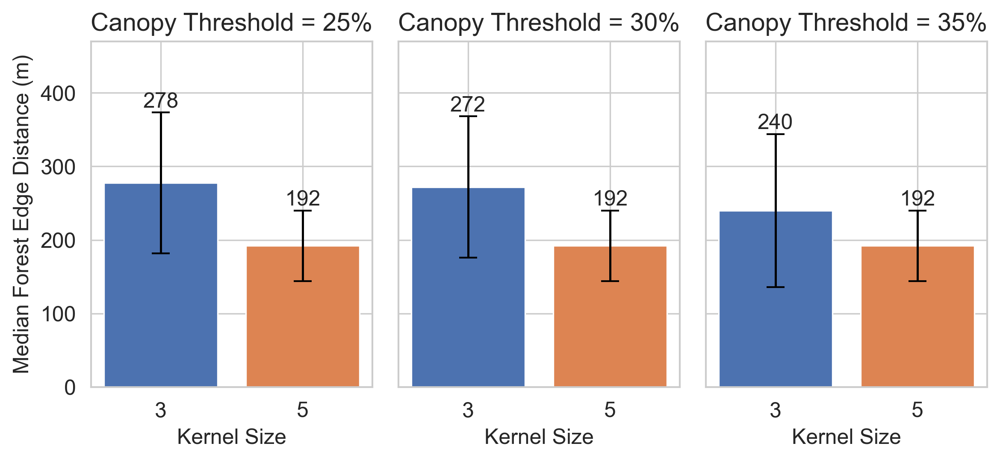

In [90]:
# Clean the data by removing NaN and infinite values
sensitivity_df_clean = sensitivity_df.replace([np.inf, -np.inf], np.nan).dropna(subset=['Distance (m)'])

# Plotting with manual subplots
fig, axes = plt.subplots(1, 3, figsize=(8, 4), dpi=300, sharey=True)
for i, thresh in enumerate(canopy_thresholds):
    ax = axes[i]
    subset = summary_df[summary_df['Canopy Threshold (%)'] == thresh]
    bars = ax.bar(subset['Kernel Size'], subset['Median Distance (m)'], 
                  color=sns.color_palette("deep", len(kernel_sizes)), width=0.8)
    for bar, iqr in zip(bars, subset['IQR (m)']):
        x = bar.get_x() + bar.get_width() / 2
        y = bar.get_height()
        ax.errorbar(x, y, yerr=iqr / 2, fmt='none', c='black', capsize=5)
        ax.text(x, y + iqr / 2 + 1, f"{y:.0f}", ha='center', va='bottom', fontsize=12)
    ax.set_title(f"Canopy Threshold = {thresh}%", fontsize=14)
    ax.set_xlabel("Kernel Size", fontsize=12)
    ax.set_ylim(0, sensitivity_df_clean['Distance (m)'].max() + 100)
    if i == 0:
        ax.set_ylabel("Median Forest Edge Distance (m)", fontsize=12)
    ax.tick_params(axis='both', labelsize=12)

# fig.suptitle("Sensitivity Analysis: Median Forest Edge Distance by Canopy Threshold and Kernel Size", fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.savefig(os.path.join(figure_dir, "sensitivity_forest_edge_faceted.png"), dpi=300)
plt.show()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


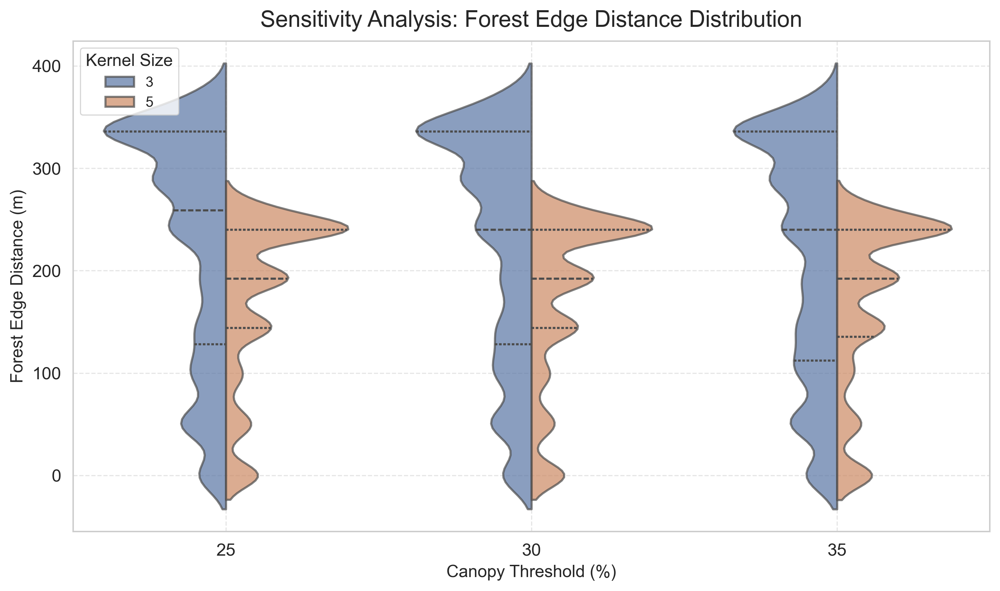

In [81]:
# Plotting with Violin Plot
plt.figure(figsize=(10, 6), dpi=300)
sns.violinplot(x='Canopy Threshold (%)', y='Distance (m)', hue='Kernel Size', 
               data=sensitivity_df, split=True, inner='quartile', palette='deep', 
               linewidth=1.5, alpha=0.7)

# Customize the plot
plt.title("Sensitivity Analysis: Forest Edge Distance Distribution", fontsize=16, pad=10)
plt.xlabel("Canopy Threshold (%)", fontsize=12)
plt.ylabel("Forest Edge Distance (m)", fontsize=12)
plt.legend(title="Kernel Size", title_fontsize=12, fontsize=10, loc='upper left')
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()

# Save and show
plt.savefig(os.path.join(figure_dir, "sensitivity_forest_edge_violin.png"), dpi=300)
plt.show()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


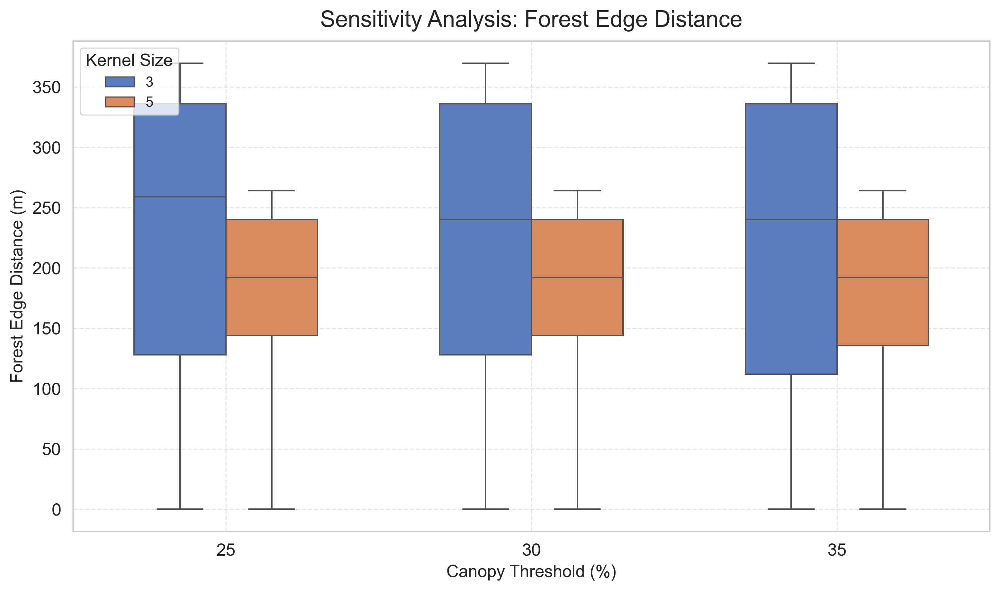

In [82]:
# Plotting with Box Plot
plt.figure(figsize=(10, 6), dpi=300)
sns.boxplot(x='Canopy Threshold (%)', y='Distance (m)', hue='Kernel Size', 
            data=sensitivity_df, palette='muted', width=0.6, fliersize=5)

# Customize the plot
plt.title("Sensitivity Analysis: Forest Edge Distance", fontsize=16, pad=10)
plt.xlabel("Canopy Threshold (%)", fontsize=12)
plt.ylabel("Forest Edge Distance (m)", fontsize=12)
plt.legend(title="Kernel Size", title_fontsize=12, fontsize=10, loc='upper left')
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()

# Save and show
plt.savefig(os.path.join(figure_dir, "sensitivity_forest_edge_box.png"), dpi=300)
plt.show()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


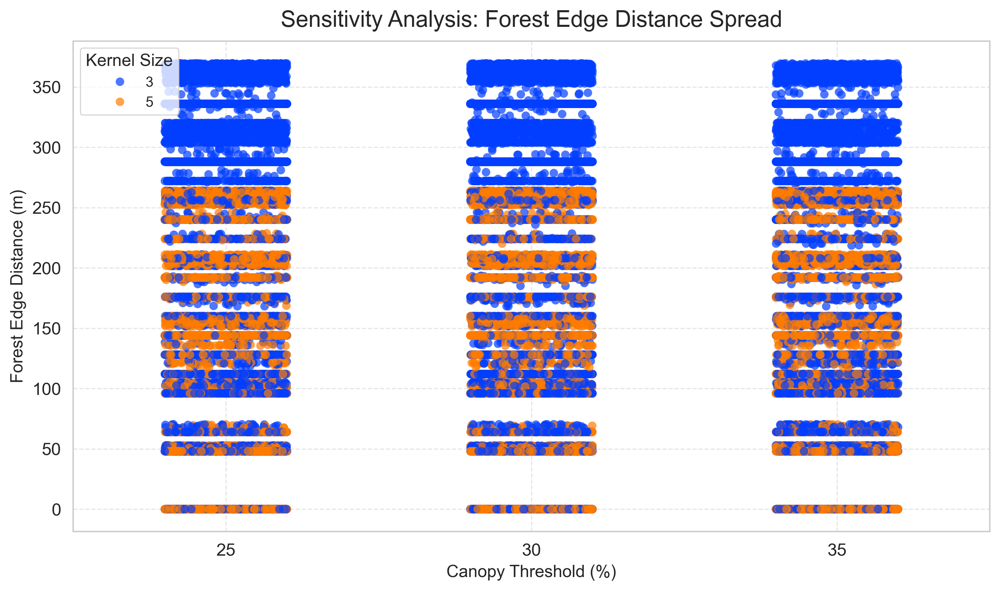

In [83]:
# Plotting with Strip Plot
plt.figure(figsize=(10, 6), dpi=300)
sns.stripplot(x='Canopy Threshold (%)', y='Distance (m)', hue='Kernel Size', 
              data=sensitivity_df, palette='bright', size=6, jitter=0.2, alpha=0.7)

# Customize the plot
plt.title("Sensitivity Analysis: Forest Edge Distance Spread", fontsize=16, pad=10)
plt.xlabel("Canopy Threshold (%)", fontsize=12)
plt.ylabel("Forest Edge Distance (m)", fontsize=12)
plt.legend(title="Kernel Size", title_fontsize=12, fontsize=10, loc='upper left')
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()

# Save and show
plt.savefig(os.path.join(figure_dir, "sensitivity_forest_edge_strip.png"), dpi=300)
plt.show()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_3613/2150916943.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  g = sns.catplot(x='Canopy Threshold (%)', y='Distance (m)', col='Kernel Size',
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


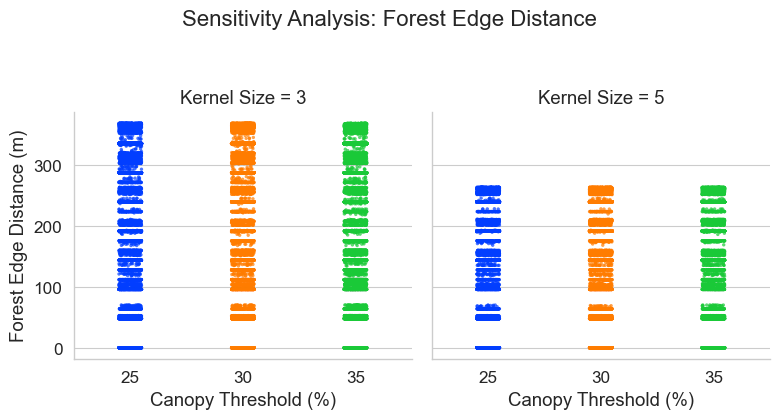

In [84]:
g = sns.catplot(x='Canopy Threshold (%)', y='Distance (m)', col='Kernel Size', 
                data=sensitivity_df, kind='strip', palette='bright', 
                height=4, aspect=1, s=6, alpha=0.7)
g.set_titles("Kernel Size = {col_name}")
g.set_axis_labels("Canopy Threshold (%)", "Forest Edge Distance (m)")
g.fig.suptitle("Sensitivity Analysis: Forest Edge Distance", fontsize=16, y=1.05)
plt.tight_layout()
plt.savefig(os.path.join(figure_dir, "sensitivity_forest_edge_strip_faceted.png"), dpi=300)
plt.show()

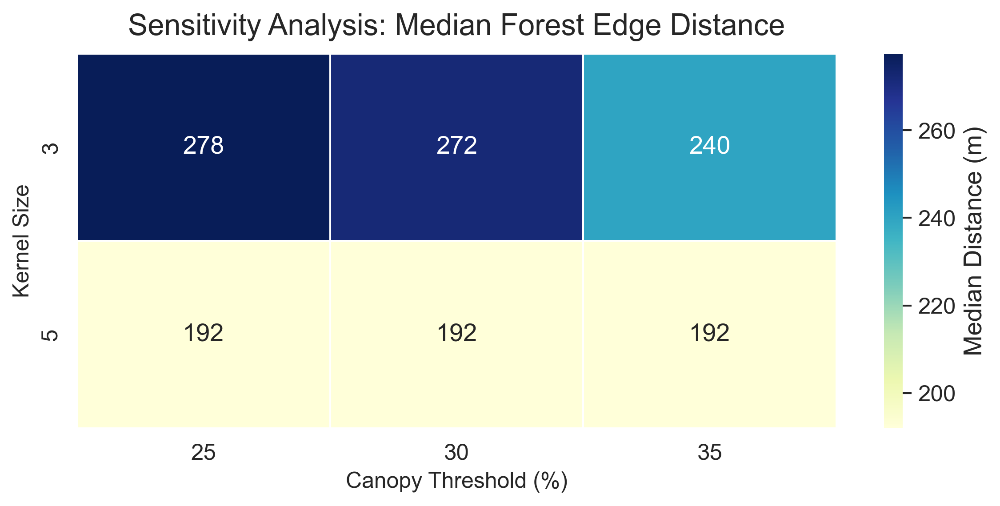

In [85]:
# Prepare data for heatmap (pivot table with median distance)
heatmap_data = sensitivity_df.pivot_table(values='Distance (m)', 
                                          index='Kernel Size', 
                                          columns='Canopy Threshold (%)', 
                                          aggfunc='median')

# Plotting with Heatmap
plt.figure(figsize=(8, 4), dpi=300)
sns.heatmap(heatmap_data, annot=True, fmt='.0f', cmap='YlGnBu', 
            cbar_kws={'label': 'Median Distance (m)'}, linewidths=0.5)

# Customize the plot
plt.title("Sensitivity Analysis: Median Forest Edge Distance", fontsize=16, pad=10)
plt.xlabel("Canopy Threshold (%)", fontsize=12)
plt.ylabel("Kernel Size", fontsize=12)
plt.tight_layout()

# Save and show
plt.savefig(os.path.join(figure_dir, "sensitivity_forest_edge_heatmap.png"), dpi=300)
plt.show()

INFO:__main__:Loaded 26160 rows from ./output/clusters_with_distance.csv
INFO:__main__:Extracted 26160 coordinate pairs for analysis
INFO:__main__:Radius 50 m: median density = 21.65 trees/ha
INFO:__main__:Radius 100 m: median density = 13.69 trees/ha
INFO:__main__:Radius 200 m: median density = 8.75 trees/ha
INFO:__main__:
Multiscale Density Analysis Results:
INFO:__main__:   Buffer Radius (m)  Median Density (trees/ha)  IQR (trees/ha)
0                 50                  21.645072       43.290145
1                100                  13.687325       25.146481
2                200                   8.753522       13.926058


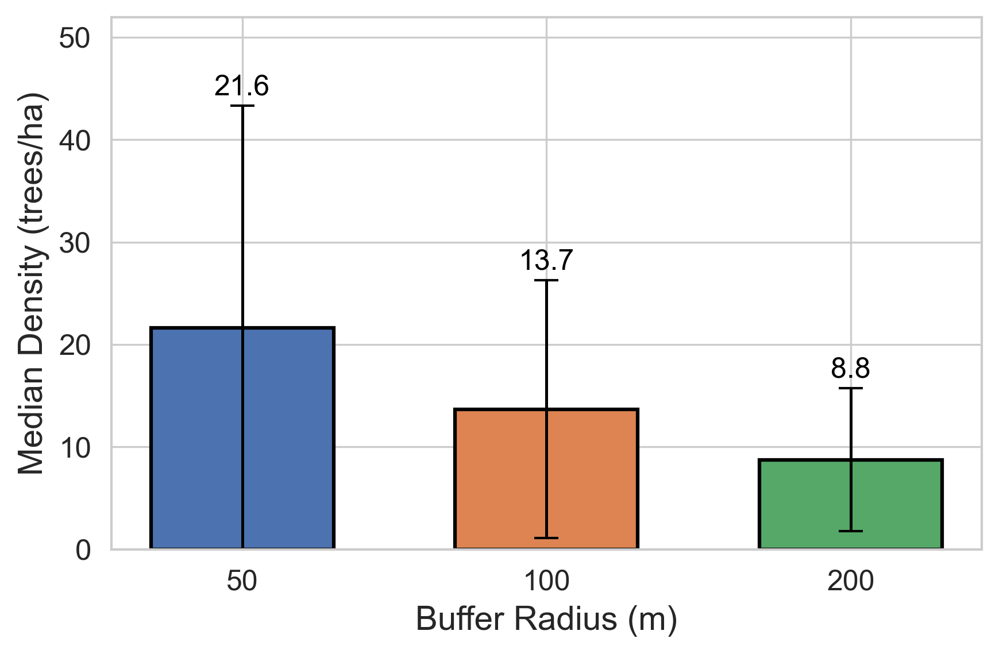

INFO:__main__:Figure saved to: ./figures/multiscale_density.png


In [91]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import pairwise_distances
import logging

# Set up logging for tracking progress
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Set up directories for input data and saving figures
output_dir = "./output"
figure_dir = "./figures"
os.makedirs(figure_dir, exist_ok=True)

# Configure plotting style for publication quality
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Load data and log the number of observations
csv_path = os.path.join(output_dir, "clusters_with_distance.csv")
df = pd.read_csv(csv_path)
logger.info(f"Loaded {len(df)} rows from {csv_path}")

# Extract x, y coordinates for spatial analysis
coords = df[['x', 'y']].values
logger.info(f"Extracted {len(coords)} coordinate pairs for analysis")

# Define buffer radii in meters for multiscale density calculation
buffer_radii = [50, 100, 200]

# Initialize dictionary to store density arrays per radius
densities = {}

# Compute local densities (trees per hectare) for each buffer radius
for radius in buffer_radii:
    # Compute pairwise distances between coordinates
    dist_matrix = pairwise_distances(coords, metric='euclidean')
    # Count neighbors within the specified radius, excluding self (0)
    neighbors = np.sum(dist_matrix <= radius, axis=1) - 1
    # Convert area (m^2) to hectares: 1 ha = 10,000 m^2
    area_ha = np.pi * radius**2 / 10000  
    density = neighbors / area_ha
    densities[radius] = density
    logger.info(f"Radius {radius} m: median density = {np.median(density):.2f} trees/ha")

# Construct a DataFrame summarizing median and IQR for each buffer radius
summary_list = []
for radius in buffer_radii:
    dens = densities[radius]
    median_val = np.median(dens)
    iqr_val = np.percentile(dens, 75) - np.percentile(dens, 25)
    summary_list.append({'Buffer Radius (m)': radius,
                         'Median Density (trees/ha)': median_val,
                         'IQR (trees/ha)': iqr_val})
summary_df = pd.DataFrame(summary_list)
logger.info("\nMultiscale Density Analysis Results:")
logger.info(summary_df)

# Create a bar plot using the summary statistics
plt.figure(figsize=(6, 4), dpi=300)
positions = np.arange(len(buffer_radii))
bars = plt.bar(
    positions,
    summary_df['Median Density (trees/ha)'],
    yerr=summary_df['IQR (trees/ha)'] / 2, 
    capsize=5, 
    width=0.6,
    color=sns.color_palette("deep", len(buffer_radii)),
    edgecolor='black', 
    linewidth=1.5
)
# plt.title("Local Density of Dead Trees at Multiple Scales", fontsize=16)
plt.xlabel("Buffer Radius (m)", fontsize=14)
plt.ylabel("Median Density (trees/ha)", fontsize=14)
plt.xticks(positions, buffer_radii, fontsize=12)
max_height = summary_df['Median Density (trees/ha)'].max() + summary_df['IQR (trees/ha)'].max() / 2
plt.ylim(0, max_height * 1.2)

# Annotate each bar with the median density value
for bar, median, iqr in zip(bars, summary_df['Median Density (trees/ha)'], summary_df['IQR (trees/ha)']):
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2, 
        height + iqr / 2 + 0.5, 
        f"{median:.1f}",
        ha='center', 
        va='bottom', 
        fontsize=12,
        color='black'
    )

plt.tight_layout()
fig_path = os.path.join(figure_dir, "multiscale_density.png")
plt.savefig(fig_path, dpi=300, bbox_inches='tight')
plt.show()
logger.info(f"Figure saved to: {fig_path}")

/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_3613/513967190.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Buffer Radius (m)', y='Density (trees/ha)', data=density_df,


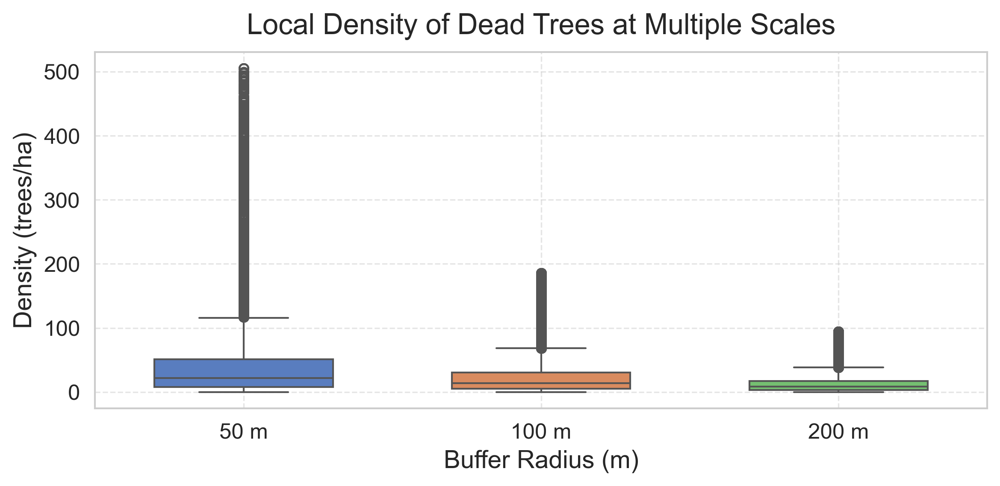

INFO:__main__:Box plot saved to: ./figures/multiscale_density_box.png


In [86]:
# Prepare data for box plot (use raw densities instead of summary)
density_df = pd.DataFrame({f'{radius} m': densities[radius] for radius in buffer_radii})
density_df = density_df.melt(var_name='Buffer Radius (m)', value_name='Density (trees/ha)')

# Plotting with Box Plot
plt.figure(figsize=(8, 4), dpi=300)
sns.boxplot(x='Buffer Radius (m)', y='Density (trees/ha)', data=density_df, 
            palette='muted', width=0.6, fliersize=5)

# Customize the plot
plt.title("Local Density of Dead Trees at Multiple Scales", fontsize=16, pad=10)
plt.xlabel("Buffer Radius (m)", fontsize=14)
plt.ylabel("Density (trees/ha)", fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()

# Save and show
fig_path = os.path.join(figure_dir, "multiscale_density_box.png")
plt.savefig(fig_path, dpi=300, bbox_inches='tight')
plt.show()
logger.info(f"Box plot saved to: {fig_path}")

/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_3613/494690814.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Buffer Radius (m)', y='Density (trees/ha)', data=density_df,


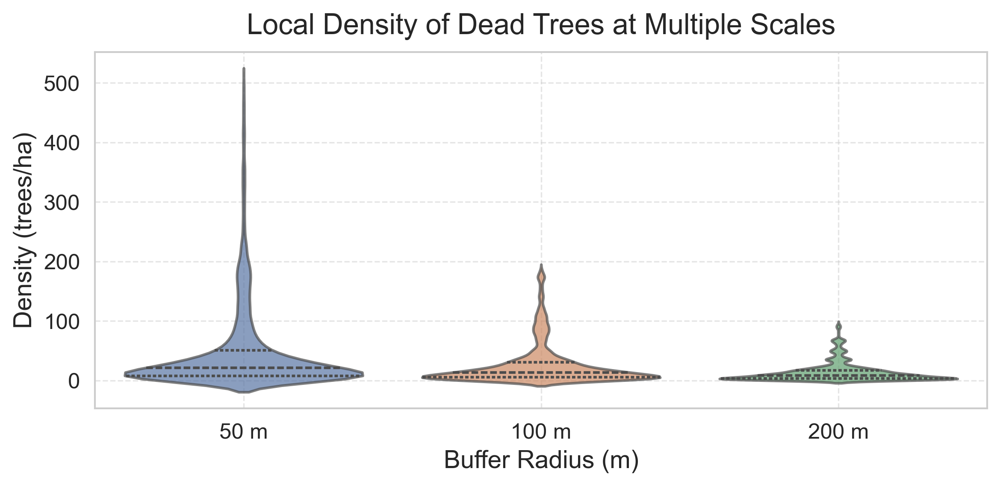

INFO:__main__:Violin plot saved to: ./figures/multiscale_density_violin.png


In [87]:
# Prepare data for violin plot (same as box plot)
density_df = pd.DataFrame({f'{radius} m': densities[radius] for radius in buffer_radii})
density_df = density_df.melt(var_name='Buffer Radius (m)', value_name='Density (trees/ha)')

# Plotting with Violin Plot
plt.figure(figsize=(8, 4), dpi=300)
sns.violinplot(x='Buffer Radius (m)', y='Density (trees/ha)', data=density_df, 
               palette='deep', inner='quartile', linewidth=1.5, alpha=0.7)

# Customize the plot
plt.title("Local Density of Dead Trees at Multiple Scales", fontsize=16, pad=10)
plt.xlabel("Buffer Radius (m)", fontsize=14)
plt.ylabel("Density (trees/ha)", fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()

# Save and show
fig_path = os.path.join(figure_dir, "multiscale_density_violin.png")
plt.savefig(fig_path, dpi=300, bbox_inches='tight')
plt.show()
logger.info(f"Violin plot saved to: {fig_path}")

INFO:__main__:Assigned 125 unique image_ids
INFO:__main__:Aggregated to 125 image plots
INFO:__main__:Spatial weights created with 125 patches having neighbors
/Users/anisr/Documents/TreeClusters/venv/lib/python3.12/site-packages/esda/getisord.py:421: UserWarning: Gi* requested, but (a) weights are already row-standardized, (b) no weights are on the diagonal, and (c) no default value supplied to star. Assuming that the self-weight is equivalent to the maximum weight in the row. To use a different default (like, .5), set `star=.5`, or use libpysal.weights.fill_diagonal() to set the diagonal values of your weights matrix and use `star=None` in Gi_Local.
  w, star = _infer_star_and_structure_w(w, star, transform)
INFO:__main__:Hotspot_df has 125 rows



Hotspot Data Preview:
   image_id     centroid_x    centroid_y  mean_GiStar
0         0  473651.600541  6.979739e+06     0.581739
1         1  456420.448651  7.533797e+06     1.172529
2         2  330010.130973  6.729174e+06     0.228822
3         3  422566.422994  6.764361e+06     0.192492
4         4  465309.478254  7.283498e+06    -0.362833

Aggregated Hotspot Analysis Results:
       mean_GiStar
count   125.000000
mean      0.046993
std       0.538170
min      -0.688070
25%      -0.362833
50%      -0.058356
75%       0.448530
max       1.178584


INFO:__main__:Plot bounds: x=(np.float64(2104469.3341313587), np.float64(3732085.194647045)), y=(np.float64(8282009.349714015), np.float64(10990005.676450983))


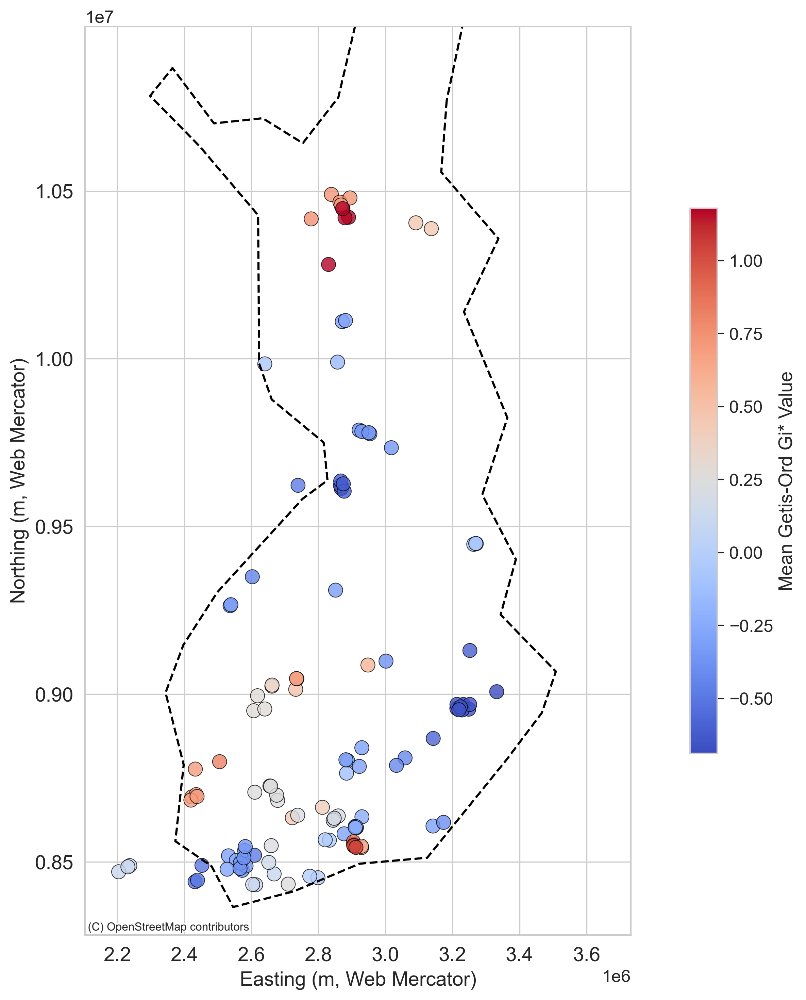

In [113]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt
import seaborn as sns
import contextily as ctx
import logging
from sklearn.cluster import KMeans
from libpysal.weights import KNN
from esda.getisord import G_Local

# Set up logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Set up directories
output_dir = "./output"
figure_dir = "./figures"
os.makedirs(figure_dir, exist_ok=True)

# Styling
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Load data
csv_path = os.path.join(output_dir, "clusters_with_distance.csv")
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# Assign image_id using K-means clustering (125 clusters)
coords = df[['x', 'y']].values
kmeans = KMeans(n_clusters=125, random_state=42)
df['image_id'] = kmeans.fit_predict(coords)
logger.info(f"Assigned {df['image_id'].nunique()} unique image_ids")

# Aggregate by image_id
image_df = df.groupby('image_id').agg({
    'x': 'mean',
    'y': 'mean',
    'target': 'sum'
}).reset_index()
image_df.columns = ['image_id', 'centroid_x', 'centroid_y', 'cluster_count']
logger.info(f"Aggregated to {len(image_df)} image plots")

# Compute Gi* for images using KNN
coords = image_df[['centroid_x', 'centroid_y']].values
w = KNN.from_array(coords, k=5)
logger.info(f"Spatial weights created with {len(w.neighbors)} patches having neighbors")
g_local = G_Local(image_df['cluster_count'].values, w, transform='R', star=True)
gi_stars = g_local.Zs

# Create hotspot_df
hotspot_df = pd.DataFrame({
    'image_id': image_df['image_id'],
    'centroid_x': image_df['centroid_x'],
    'centroid_y': image_df['centroid_y'],
    'mean_GiStar': gi_stars
})

# Debug data
print("\nHotspot Data Preview:")
print(hotspot_df.head())
print("\nAggregated Hotspot Analysis Results:")
print(hotspot_df[['mean_GiStar']].describe())
logger.info(f"Hotspot_df has {len(hotspot_df)} rows")

# Create GeoDataFrame
geometry = [Point(xy) for xy in zip(hotspot_df['centroid_x'], hotspot_df['centroid_y'])]
gdf_hotspots = gpd.GeoDataFrame(hotspot_df, geometry=geometry, crs="EPSG:3067")
gdf_hotspots = gdf_hotspots.to_crs(epsg=3857)

# Load Finland's boundary (download from Natural Earth: https://www.naturalearthdata.com/downloads/10m-cultural-vectors/)
# Replace with your local path to ne_10m_admin_0_countries.shp
finland_shp = gpd.read_file("data/ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp")
finland = finland_shp[finland_shp['NAME'] == 'Finland'].to_crs(epsg=3857)

# Plotting
fig, ax = plt.subplots(1, 1, figsize=(12, 10), dpi=300)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, zoom=10)
finland.boundary.plot(ax=ax, edgecolor='black', linewidth=1.5, linestyle='--')  # Finland contour
gdf_hotspots.plot(
    column='mean_GiStar', 
    cmap="coolwarm", 
    markersize=100, 
    edgecolor='black', 
    linewidth=0.5, 
    alpha=0.8, 
    legend=True,
    legend_kwds={'label': "Mean Getis-Ord Gi* Value", 'shrink': 0.6, 'location': 'right'},
    ax=ax
)
# ax.set_title("Aggregated Hotspot Analysis Across Sample Plots", fontsize=16)
ax.set_xlabel("Easting (m, Web Mercator)", fontsize=14)
ax.set_ylabel("Northing (m, Web Mercator)", fontsize=14)
ax.tick_params(axis='both', labelsize=14)
bounds = gdf_hotspots.total_bounds
buffer = 500000  # 10 km buffer
ax.set_xlim(bounds[0] - 100000, bounds[2] + 400000)
ax.set_ylim(bounds[1] - 150000, bounds[3] + 500000)
logger.info(f"Plot bounds: x={ax.get_xlim()}, y={ax.get_ylim()}")
plt.tight_layout()
plt.savefig(os.path.join(figure_dir, "aggregated_hotspots.png"), dpi=300)
plt.show()

Logistic Regression CV AUC Scores: [0.58936618 0.59111806 0.5721471  0.58229968 0.58018245]
Mean CV AUC: 0.583
Random Forest CV AUC Scores: [0.75437898 0.7498317  0.76135513 0.765209   0.75158114]
Mean CV AUC: 0.756


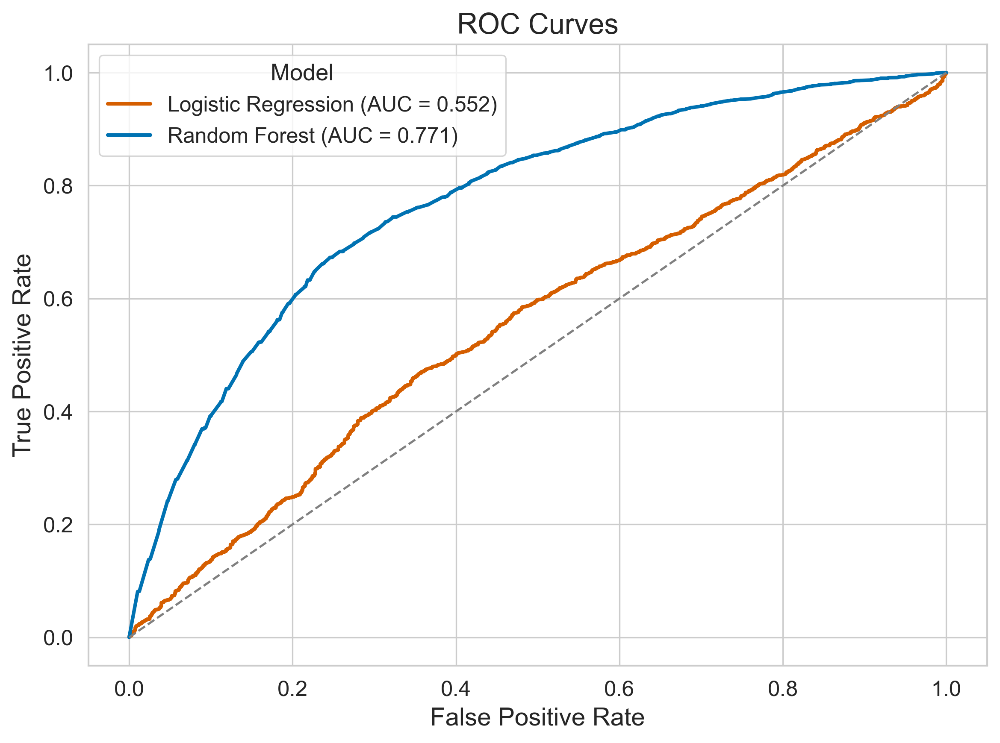

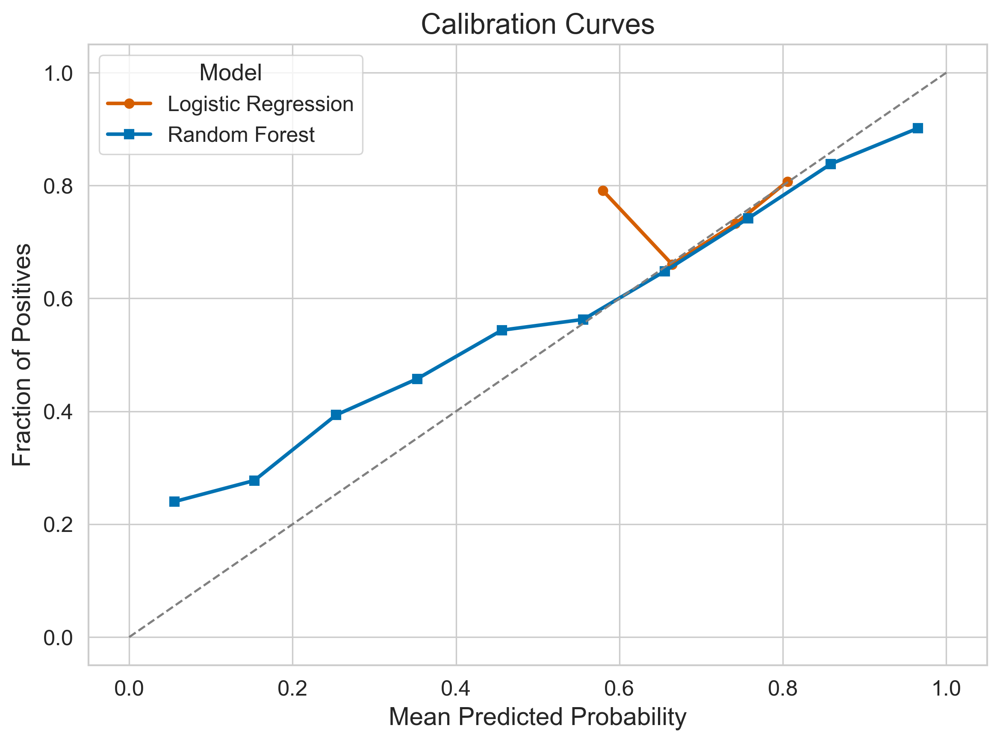

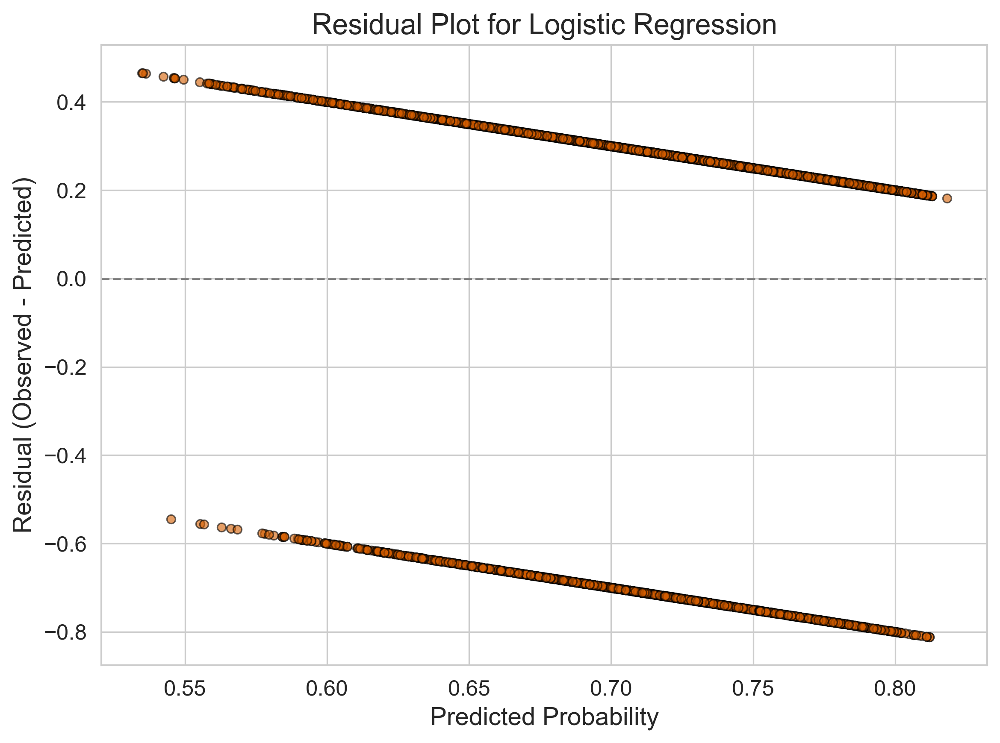

In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import StratifiedKFold, cross_val_score, train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (roc_curve, roc_auc_score, confusion_matrix, brier_score_loss)
from sklearn.calibration import calibration_curve

# Set up output directory
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Load and clean data
csv_path = "./output/clusters_with_distance.csv"  # Update as needed
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target']).reset_index(drop=True)
X = df_clean[features].values.astype(float)
y = df_clean['target'].values

# Split data for validation (70% train, 30% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# -------------------------
# Cross-Validation: Logistic Regression and Random Forest
# -------------------------
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Logistic Regression Pipeline
pipe_lr = make_pipeline(StandardScaler(), LogisticRegression(solver='liblinear', random_state=42))
lr_cv_scores = cross_val_score(pipe_lr, X_train, y_train, cv=cv, scoring='roc_auc')
print(f"Logistic Regression CV AUC Scores: {lr_cv_scores}")
print(f"Mean CV AUC: {lr_cv_scores.mean():.3f}")

# Random Forest Pipeline
pipe_rf = make_pipeline(StandardScaler(), RandomForestClassifier(n_estimators=100, random_state=42))
rf_cv_scores = cross_val_score(pipe_rf, X_train, y_train, cv=cv, scoring='roc_auc')
print(f"Random Forest CV AUC Scores: {rf_cv_scores}")
print(f"Mean CV AUC: {rf_cv_scores.mean():.3f}")

# -------------------------
# Model Fitting and Predictions
# -------------------------
# Fit models on training data
pipe_lr.fit(X_train, y_train)
pipe_rf.fit(X_train, y_train)

# Get predicted probabilities for test set
y_prob_lr = pipe_lr.predict_proba(X_test)[:, 1]
y_prob_rf = pipe_rf.predict_proba(X_test)[:, 1]

# -------------------------
# ROC Curves
# -------------------------
plt.figure(figsize=(8, 6), dpi=300)
fpr_lr, tpr_lr, _ = roc_curve(y_test, y_prob_lr)
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_prob_rf)
auc_lr = roc_auc_score(y_test, y_prob_lr)
auc_rf = roc_auc_score(y_test, y_prob_rf)

plt.plot(fpr_lr, tpr_lr, label=f"Logistic Regression (AUC = {auc_lr:.3f})", linewidth=2, color="#D55E00")
plt.plot(fpr_rf, tpr_rf, label=f"Random Forest (AUC = {auc_rf:.3f})", linewidth=2, color="#0072B2")
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")
plt.xlabel("False Positive Rate", fontsize=14)
plt.ylabel("True Positive Rate", fontsize=14)
plt.title("ROC Curves", fontsize=16)
plt.legend(title="Model", fontsize=12, title_fontsize=13)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "roc_curves.png"), dpi=300)
plt.show()

# -------------------------
# Calibration Plots
# -------------------------
from sklearn.calibration import calibration_curve

plt.figure(figsize=(8, 6), dpi=300)
prob_true_lr, prob_pred_lr = calibration_curve(y_test, y_prob_lr, n_bins=10)
prob_true_rf, prob_pred_rf = calibration_curve(y_test, y_prob_rf, n_bins=10)

plt.plot(prob_pred_lr, prob_true_lr, marker='o', label="Logistic Regression", color="#D55E00", linewidth=2)
plt.plot(prob_pred_rf, prob_true_rf, marker='s', label="Random Forest", color="#0072B2", linewidth=2)
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")
plt.xlabel("Mean Predicted Probability", fontsize=14)
plt.ylabel("Fraction of Positives", fontsize=14)
plt.title("Calibration Curves", fontsize=16)
plt.legend(title="Model", fontsize=12, title_fontsize=13)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "calibration_curves.png"), dpi=300)
plt.show()

# -------------------------
# Residual Plots for Logistic Regression
# -------------------------
# For logistic regression, compute residuals as observed - predicted probabilities
residuals_lr = y_test - y_prob_lr

plt.figure(figsize=(8, 6), dpi=300)
plt.scatter(y_prob_lr, residuals_lr, alpha=0.6, color="#D55E00", edgecolor="k")
plt.axhline(0, linestyle="--", color="gray")
plt.xlabel("Predicted Probability", fontsize=14)
plt.ylabel("Residual (Observed - Predicted)", fontsize=14)
plt.title("Residual Plot for Logistic Regression", fontsize=16)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "residual_plot_lr.png"), dpi=300)
plt.show()

INFO:__main__:Assigned 125 unique plot IDs.
INFO:__main__:Plot IDs have been computed and saved.
INFO:__main__:Computing Ripley's K for each sample plot in parallel...
Processing plots: 100%|██████████| 125/125 [57:14<00:00, 27.47s/it]
INFO:__main__:Simulating CSR per plot in parallel...
Simulating CSR: 100%|██████████| 125/125 [4:17:13<00:00, 123.47s/it] 


Distance 50 m: Observed K (mean) = 89574.56, Theoretical K = 11776.07, 95% Envelope (mean) = [4066.28, 26467.27]
Distance 100 m: Observed K (mean) = 132762.39, Theoretical K = 26496.15, 95% Envelope (mean) = [11823.12, 47971.62]
Distance 200 m: Observed K (mean) = 291742.76, Theoretical K = 144256.81, 95% Envelope (mean) = [95835.06, 184265.09]


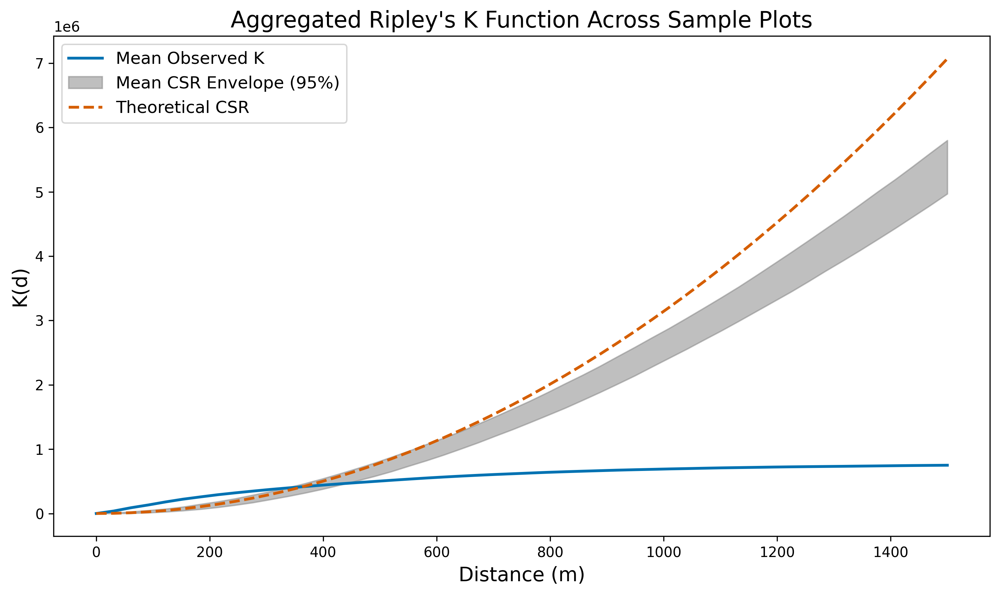

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, Point
from tqdm import tqdm
from pointpats.distance_statistics import k_test
from joblib import Parallel, delayed
import logging
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Set up logging for progress information
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Set up output directory
output_dir = "./figures"
os.makedirs(output_dir, exist_ok=True)

# Load the CSV file containing dead tree coordinates
csv_path = "./output/clusters_with_distance.csv"  # Update as needed
df = pd.read_csv(csv_path)

# Ensure required columns exist and drop missing values
df = df[['x', 'y']].dropna()

# Convert coordinates to float32 for improved performance and stability
coords = df[['x', 'y']].values.astype(np.float32)

# Standardize the coordinates before clustering
scaler = StandardScaler()
coords_scaled = scaler.fit_transform(coords)

# Apply KMeans clustering to generate plot IDs
n_clusters = 125
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['plot_id'] = kmeans.fit_predict(coords_scaled)
logger.info(f"Assigned {df['plot_id'].nunique()} unique plot IDs.")

# Save the updated dataframe
df.to_csv("./output/clusters_with_distance_with_plots.csv", index=False)
logger.info("Plot IDs have been computed and saved.")

# Analysis parameters
plot_size = 6000   # each sample plot is 6 km x 6 km
max_dist = 1500    # maximum distance for analysis (in meters)
support = (0, max_dist, 50)  # support tuple: (start, stop, num_intervals)

def compute_plot_k(group, support, plot_size):
    """
    Compute Ripley's K statistic for a single plot.
    The study window is defined as a square Polygon of side `plot_size`
    centered on the group's centroid.
    """
    if len(group) < 3:
        return None
    xs = group['x'].values
    ys = group['y'].values
    centroid = Point(np.mean(xs), np.mean(ys))
    half = plot_size / 2
    # Define study window as a square Polygon
    study_area_poly = Polygon([
        (centroid.x - half, centroid.y - half),
        (centroid.x - half, centroid.y + half),
        (centroid.x + half, centroid.y + half),
        (centroid.x + half, centroid.y - half)
    ])
    coords_plot = group[['x', 'y']].values
    # Call k_test with the support tuple and study window provided as a Polygon
    k_result = k_test(coords_plot, support=support, hull=study_area_poly)
    return k_result.statistic

def simulate_plot_k(group, support, plot_size, n_sim):
    """
    Perform CSR simulations for a single plot.
    Returns the 2.5th and 97.5th percentiles of the simulated K functions.
    """
    xs = group['x'].values
    ys = group['y'].values
    centroid = Point(np.mean(xs), np.mean(ys))
    half = plot_size / 2
    study_area_poly = Polygon([
        (centroid.x - half, centroid.y - half),
        (centroid.x - half, centroid.y + half),
        (centroid.x + half, centroid.y + half),
        (centroid.x + half, centroid.y - half)
    ])
    k_simulations = np.zeros((n_sim, support[2]))  # support[2] is the number of intervals
    for i in range(n_sim):
        sim_x = np.random.uniform(study_area_poly.bounds[0], study_area_poly.bounds[2], len(group))
        sim_y = np.random.uniform(study_area_poly.bounds[1], study_area_poly.bounds[3], len(group))
        sim_points = np.column_stack((sim_x, sim_y))
        k_simulations[i, :] = k_test(sim_points, support=support, hull=study_area_poly).statistic
    return np.percentile(k_simulations, [2.5, 97.5], axis=0)

# Group the DataFrame by plot_id
grouped = list(df.groupby('plot_id'))

# Parallelize the computation of observed K for each sample plot
logger.info("Computing Ripley's K for each sample plot in parallel...")
K_obs_list = Parallel(n_jobs=-1)(
    delayed(compute_plot_k)(group, support, plot_size) for _, group in tqdm(grouped, desc="Processing plots")
)
K_obs_list = [k for k in K_obs_list if k is not None]
if len(K_obs_list) == 0:
    raise ValueError("No plot had enough points to compute K.")
K_obs_mean = np.mean(K_obs_list, axis=0)

# Parallelize CSR simulations per plot
logger.info("Simulating CSR per plot in parallel...")
n_simulations = 10  # Adjust as needed for speed/accuracy
sim_results = Parallel(n_jobs=-1)(
    delayed(simulate_plot_k)(group, support, plot_size, n_simulations) for _, group in tqdm(grouped, desc="Simulating CSR")
)
# Remove None results and aggregate envelopes
K_lower_list = []
K_upper_list = []
for res in sim_results:
    if res is not None:
        K_lower_list.append(res[0])
        K_upper_list.append(res[1])
if len(K_lower_list) > 0:
    K_lower_mean = np.mean(K_lower_list, axis=0)
    K_upper_mean = np.mean(K_upper_list, axis=0)
else:
    K_lower_mean = np.zeros(support[2])
    K_upper_mean = np.zeros(support[2])

# Compute theoretical CSR function: K_theo = πd²
d_vals = np.linspace(support[0], support[1], support[2])
K_theo = np.pi * d_vals**2

for d in [50, 100, 200]:
    idx = np.argmin(np.abs(d_vals - d))
    print(f"Distance {d} m: Observed K (mean) = {K_obs_mean[idx]:.2f}, "
          f"Theoretical K = {K_theo[idx]:.2f}, "
          f"95% Envelope (mean) = [{K_lower_mean[idx]:.2f}, {K_upper_mean[idx]:.2f}]")

# Plot the aggregated Ripley's K function with simulation envelopes
fig, ax = plt.subplots(figsize=(10, 6), dpi=300)
ax.plot(d_vals, K_obs_mean, label="Mean Observed K", color='#0072B2', linewidth=2)
ax.fill_between(d_vals, K_lower_mean, K_upper_mean, color='gray', alpha=0.5, label="Mean CSR Envelope (95%)")
ax.plot(d_vals, K_theo, linestyle="--", color='#D55E00', linewidth=2, label="Theoretical CSR")
ax.set_xlabel("Distance (m)", fontsize=14)
ax.set_ylabel("K(d)", fontsize=14)
ax.set_xlim(0, 400)
ax.set_title("Aggregated Ripley's K Function Across Sample Plots", fontsize=16)
ax.legend(fontsize=12, title_fontsize=13)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "aggregated_ripleyK.png"), dpi=300)
plt.show()

# Distance 50 m: Observed K (mean) = 89574.56, Theoretical K = 11776.07, 95% Envelope (mean) = [4066.28, 26467.27]
# Distance 100 m: Observed K (mean) = 132762.39, Theoretical K = 26496.15, 95% Envelope (mean) = [11823.12, 47971.62]
# Distance 200 m: Observed K (mean) = 291742.76, Theoretical K = 144256.81, 95% Envelope (mean) = [95835.06, 184265.09]

# Ripley’s K function is a statistical method used to determine whether points—in your case, mortality events—are randomly distributed or exhibit clustering (or dispersion) across various spatial scales. It does this by measuring how many other events fall within increasing distances of each event, then comparing that count to what would be expected under a random (complete spatial randomness) distribution.
# 	•	If the observed curve rises above the theoretical (random) curve, it indicates clustering at those distances.
# 	•	If it falls below, it suggests dispersion (events are spaced out).
# 	•	If it closely follows the random curve, the distribution is consistent with complete spatial randomness.

# By examining how the observed ￼ differs from the theoretical ￼ at multiple distances, you can see whether mortality events are more clustered at small distances (e.g., within tens of meters) or at broader scales (e.g., hundreds of meters). In simpler terms, Ripley’s K helps you figure out how tightly or loosely your mortality events are packed across the landscape, and whether that pattern is unlikely to have occurred by chance.

In [114]:
output_dir

'./output'

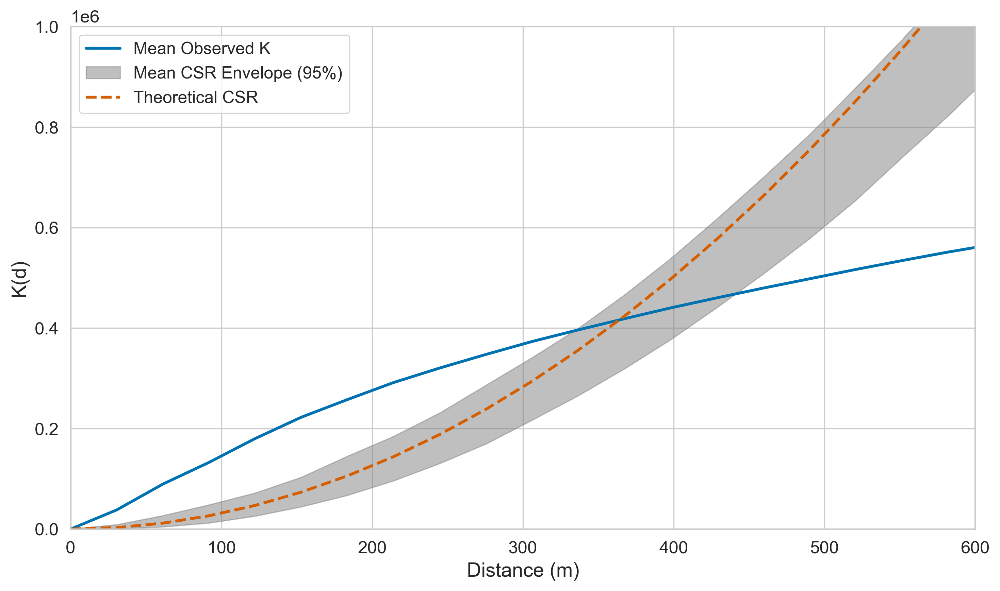

In [92]:
# Plot the aggregated Ripley's K function with simulation envelopes
fig, ax = plt.subplots(figsize=(10, 6), dpi=300)
ax.plot(d_vals, K_obs_mean, label="Mean Observed K", color='#0072B2', linewidth=2)
ax.fill_between(d_vals, K_lower_mean, K_upper_mean, color='gray', alpha=0.5, label="Mean CSR Envelope (95%)")
ax.plot(d_vals, K_theo, linestyle="--", color='#D55E00', linewidth=2, label="Theoretical CSR")
ax.set_xlabel("Distance (m)", fontsize=14)
ax.set_ylabel("K(d)", fontsize=14)
ax.set_xlim(0, 600)
ax.set_ylim(0, 1000000)
# ax.set_title("Aggregated Ripley's K Function Across Sample Plots", fontsize=16)
ax.legend(fontsize=12, title_fontsize=13)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "aggregated_ripleyK.png"), dpi=300)
plt.show()


INFO:__main__:Assigned 125 unique plot IDs.
INFO:__main__:Plot IDs computed and saved.
INFO:__main__:Computing centered Kriging interpolation for each plot in parallel...
Processing plots:  39%|███▉      | 49/125 [00:00<00:00, 125.25it/s]Kriging failed for a plot: singular matrix
Kriging failed for a plot: singular matrix
Processing plots:  77%|███████▋  | 96/125 [00:00<00:00, 100.67it/s]Kriging failed for a plot: Each lower bound must be strictly less than each upper bound.
Kriging failed for a plot: singular matrix
Kriging failed for a plot: Each lower bound must be strictly less than each upper bound.
Kriging failed for a plot: singular matrix
Processing plots: 100%|██████████| 125/125 [00:01<00:00, 104.96it/s]
Plot skipped: insufficient points for Kriging.
Kriging failed for a plot: Each lower bound must be strictly less than each upper bound.
Kriging failed for a plot: singular matrix
Kriging failed for a plot: singular matrix
INFO:__main__:Number of valid plots with centered Krig

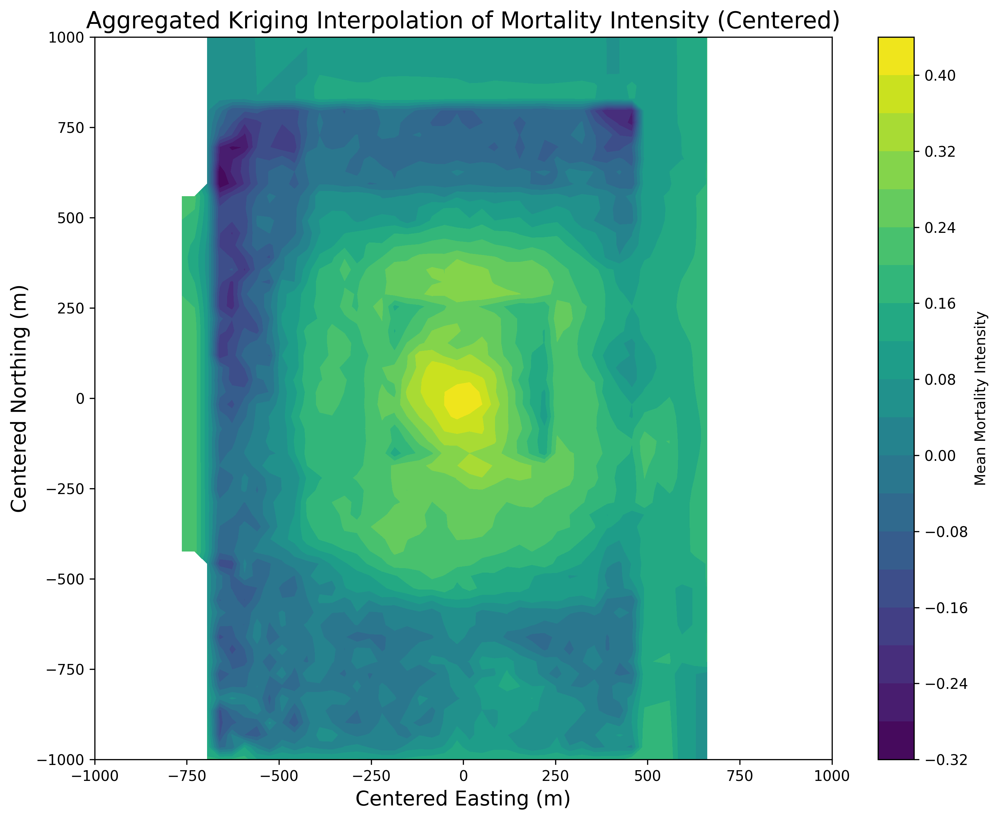

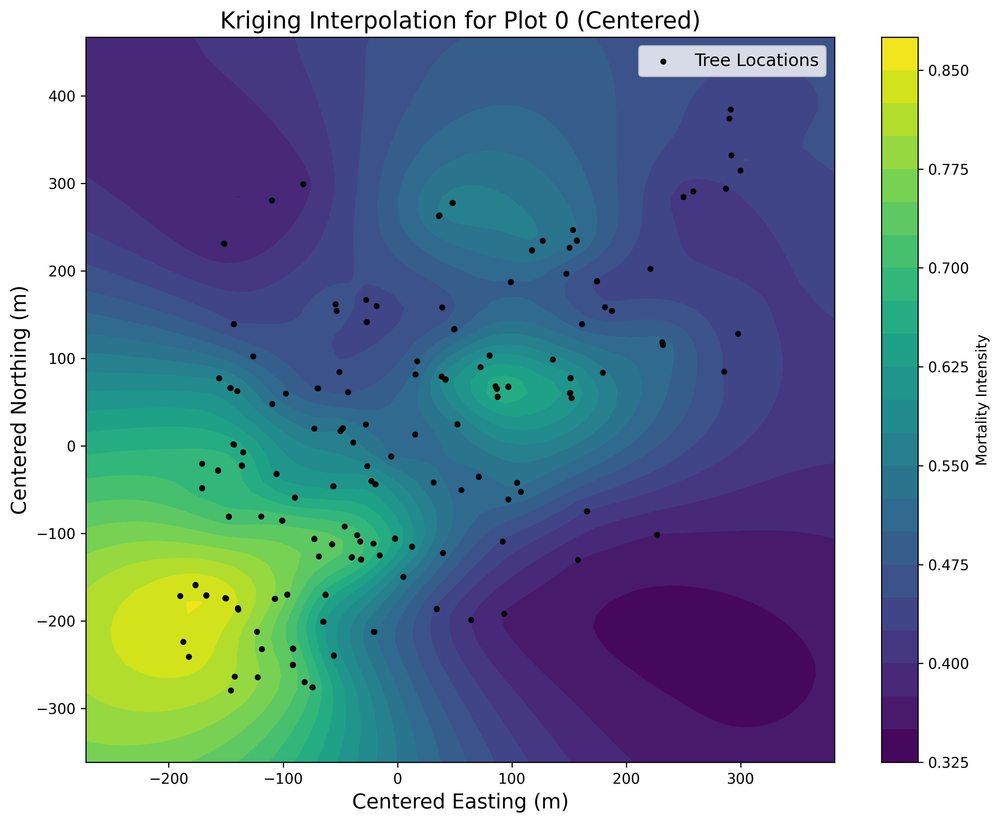

INFO:__main__:Summary Statistics for Centered Kriging Interpolation:
INFO:__main__:Plot 0: Mean Mortality Intensity = 0.500
INFO:__main__:Plot 1: Mean Mortality Intensity = 0.664
INFO:__main__:Plot 2: Mean Mortality Intensity = 0.172
INFO:__main__:Plot 3: Mean Mortality Intensity = -5.382
INFO:__main__:Plot 4: Mean Mortality Intensity = 0.413
INFO:__main__:Plot 5: Mean Mortality Intensity = 0.763
INFO:__main__:Plot 7: Mean Mortality Intensity = 0.446
INFO:__main__:Plot 8: Mean Mortality Intensity = 0.741
INFO:__main__:Plot 9: Mean Mortality Intensity = 0.276
INFO:__main__:Plot 10: Mean Mortality Intensity = 0.273
INFO:__main__:Plot 11: Mean Mortality Intensity = 0.305
INFO:__main__:Plot 12: Mean Mortality Intensity = 0.341
INFO:__main__:Plot 13: Mean Mortality Intensity = 0.395
INFO:__main__:Plot 14: Mean Mortality Intensity = 0.251
INFO:__main__:Plot 15: Mean Mortality Intensity = 0.256
INFO:__main__:Plot 16: Mean Mortality Intensity = 0.509
INFO:__main__:Plot 17: Mean Mortality Inten

In [28]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, Point, MultiPoint
from tqdm import tqdm
from pykrige.ok import OrdinaryKriging
from joblib import Parallel, delayed
import logging
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from scipy.interpolate import RegularGridInterpolator

# Set up logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Set up output directory
output_dir = "./figures"
os.makedirs(output_dir, exist_ok=True)

# Load CSV file containing dead tree coordinates and event indicators
csv_path = "./output/clusters_with_distance.csv"  # Adjust as needed
df = pd.read_csv(csv_path)

# Ensure required columns and derive target (1 for Clustered, 0 for Isolated)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)
required_cols = ['x', 'y', 'distance_to_nearest_wetland', 'distance_to_forest_edge', 
                 'distance_to_rocky_outcrop', 'target']
df = df[required_cols].dropna()

# Convert coordinates to float32 for performance
coords = df[['x', 'y']].values.astype(np.float32)

# Standardize coordinates and assign plot IDs via KMeans (125 clusters)
scaler = StandardScaler()
coords_scaled = scaler.fit_transform(coords)
n_clusters = 125
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['plot_id'] = kmeans.fit_predict(coords_scaled)
logger.info(f"Assigned {df['plot_id'].nunique()} unique plot IDs.")
df.to_csv("./output/clusters_with_distance_with_plots.csv", index=False)
logger.info("Plot IDs computed and saved.")

# Analysis parameters
grid_resolution = 60  # local grid resolution for each plot's kriging
# Define a fixed common grid (centered at (0,0)) with desired extent.
fixed_extent = 1000  # from -3000 to 3000 m in both directions
common_gridx = np.linspace(-fixed_extent, fixed_extent, grid_resolution)
common_gridy = np.linspace(-fixed_extent, fixed_extent, grid_resolution)
buffer_factor = 0.1   # Buffer convex hull by 10% of its diagonal

def get_buffered_bounds(group, buffer_factor=0.1):
    """Compute buffered bounds (xmin, ymin, xmax, ymax) from the convex hull of points."""
    xs = group['x'].values
    ys = group['y'].values
    points = np.column_stack((xs, ys))
    hull = MultiPoint(points).convex_hull
    minx, miny, maxx, maxy = hull.bounds
    diag = np.hypot(maxx - minx, maxy - miny)
    buffered_hull = hull.buffer(buffer_factor * diag)
    return buffered_hull.bounds  # (xmin, ymin, xmax, ymax)

def compute_plot_kriging_centered(group, grid_resolution, buffer_factor):
    """
    Perform Ordinary Kriging for a single plot using its buffered convex hull,
    then re-center the resulting grid so that the plot's centroid is at (0,0).
    Returns (z_pred, xx_centered, yy_centered, centroid).
    """
    if len(group) < 5:
        logger.warning("Plot skipped: insufficient points for Kriging.")
        return None, None, None, None
    xs = group['x'].values
    ys = group['y'].values
    z = group['target'].values  # Mortality intensity (0 or 1)
    
    # Compute centroid of the plot
    centroid_x = np.mean(xs)
    centroid_y = np.mean(ys)
    centroid = (centroid_x, centroid_y)
    
    # Compute buffered bounds from convex hull
    bounds = get_buffered_bounds(group, buffer_factor)
    xmin, ymin, xmax, ymax = bounds
    if xmin >= xmax or ymin >= ymax:
        logger.error("Invalid bounds computed; skipping plot.")
        return None, None, None, None

    # Create local grid for kriging
    gridx = np.linspace(xmin, xmax, grid_resolution)
    gridy = np.linspace(ymin, ymax, grid_resolution)
    try:
        ok = OrdinaryKriging(xs, ys, z, variogram_model='spherical', verbose=False)
        z_pred, ss = ok.execute('grid', gridx, gridy)
    except Exception as e:
        logger.error(f"Kriging failed for a plot: {e}")
        return None, None, None, None

    # Create meshgrid for local grid and re-center by subtracting the centroid
    xx, yy = np.meshgrid(gridx, gridy)
    xx_centered = xx - centroid_x
    yy_centered = yy - centroid_y
    return z_pred, xx_centered, yy_centered, centroid

# Parallelize kriging with centering for each plot
grouped = list(df.groupby('plot_id'))
logger.info("Computing centered Kriging interpolation for each plot in parallel...")
kriging_centered_results = Parallel(n_jobs=-1)(
    delayed(compute_plot_kriging_centered)(group, grid_resolution, buffer_factor)
    for _, group in tqdm(grouped, desc="Processing plots")
)

# Filter valid results (non-None outputs)
valid_centered = [res for res in kriging_centered_results if res[0] is not None]
logger.info(f"Number of valid plots with centered Kriging results: {len(valid_centered)}")
if not valid_centered:
    raise ValueError("No plots had enough points for Kriging.")

# Regrid each centered surface onto the fixed common grid.
def regrid_centered(z_pred, xx_centered, yy_centered, common_gridx, common_gridy):
    """Interpolate z_pred from its local centered grid onto the fixed common grid."""
    # Assume the local grid is defined by unique x and y values in the centered arrays.
    local_x = np.unique(xx_centered[0, :])
    local_y = np.unique(yy_centered[:, 0])
    interp_func = RegularGridInterpolator((local_y, local_x), z_pred, bounds_error=False, fill_value=np.nan)
    xx_common, yy_common = np.meshgrid(common_gridx, common_gridy)
    pts = np.column_stack((yy_common.ravel(), xx_common.ravel()))
    return interp_func(pts).reshape(len(common_gridy), len(common_gridx))

from scipy.interpolate import RegularGridInterpolator

regridded_surfaces = []
for z_pred, xx_centered, yy_centered, centroid in valid_centered:
    try:
        regridded = regrid_centered(z_pred, xx_centered, yy_centered, common_gridx, common_gridy)
        if not np.isnan(regridded).all():
            regridded_surfaces.append(regridded)
        else:
            logger.warning("Regridded surface is entirely NaN; skipping.")
    except Exception as e:
        logger.error(f"Regridding failed for a plot: {e}")

if not regridded_surfaces:
    raise ValueError("Regridding failed for all plots.")

# Compute the aggregated (mean) surface across plots
aggregated_surface = np.nanmean(np.stack(regridded_surfaces, axis=0), axis=0)
if np.isnan(aggregated_surface).all():
    raise ValueError("Aggregated surface is empty; check regridding and centering.")

# Plot the aggregated kriging surface on the fixed common grid
fig, ax = plt.subplots(figsize=(10, 8), dpi=300)
contour = ax.contourf(common_gridx, common_gridy, aggregated_surface, cmap='viridis', levels=20)
cbar = plt.colorbar(contour, label='Mean Mortality Intensity', ax=ax)
ax.set_xlabel("Centered Easting (m)", fontsize=14)
ax.set_ylabel("Centered Northing (m)", fontsize=14)
ax.set_title("Aggregated Kriging Interpolation of Mortality Intensity (Centered)", fontsize=16)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "aggregated_kriging_interpolation_centered.png"), dpi=300)
plt.show()

# Plot an example interpolation for the first valid plot using its local centered grid
for plot_id, group in grouped:
    result = compute_plot_kriging_centered(group, grid_resolution, buffer_factor)
    if result[0] is not None:
        z_pred_ex, xx_centered_ex, yy_centered_ex, centroid_ex = result
        fig, ax = plt.subplots(figsize=(10, 8), dpi=300)
        contour = ax.contourf(xx_centered_ex, yy_centered_ex, z_pred_ex, cmap='viridis', levels=20)
        # Re-center tree locations manually
        x_centered = group['x'] - np.mean(group['x'])
        y_centered = group['y'] - np.mean(group['y'])
        ax.scatter(x_centered, y_centered, c='black', s=10, label='Tree Locations')
        cbar = plt.colorbar(contour, label='Mortality Intensity', ax=ax)
        ax.set_xlabel("Centered Easting (m)", fontsize=14)
        ax.set_ylabel("Centered Northing (m)", fontsize=14)
        ax.set_title(f"Kriging Interpolation for Plot {plot_id} (Centered)", fontsize=16)
        ax.legend(fontsize=12)
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"example_kriging_interpolation_centered_plot_{plot_id}.png"), dpi=300)
        plt.show()
        break  # Display only the first valid example

# Print summary statistics for each plot's kriging interpolation
logger.info("Summary Statistics for Centered Kriging Interpolation:")
for i, result in enumerate(kriging_centered_results):
    if result[0] is not None:
        mean_intensity = np.mean(result[0])
        logger.info(f"Plot {i}: Mean Mortality Intensity = {mean_intensity:.3f}")

Processing plots:  38%|███▊      | 48/125 [00:06<00:08,  8.80it/s]Plot 53 failed: Each lower bound must be strictly less than each upper bound.; trying exponential variogram.
Plot 53 failed: Each lower bound must be strictly less than each upper bound.
Plot 75 failed: Each lower bound must be strictly less than each upper bound.; trying exponential variogram.
Plot 75 failed: Each lower bound must be strictly less than each upper bound.
Plot 80 failed: Each lower bound must be strictly less than each upper bound.; trying exponential variogram.
Plot 80 failed: Each lower bound must be strictly less than each upper bound.
Plot 88 failed: Each lower bound must be strictly less than each upper bound.; trying exponential variogram.
Plot 88 failed: Each lower bound must be strictly less than each upper bound.
Processing plots:  90%|████████▉ | 112/125 [00:06<00:00, 28.53it/s]Plot 98 failed: Each lower bound must be strictly less than each upper bound.; trying exponential variogram.
Plot 98 fa

count    105.000000
mean     227.741823
std       74.177963
min       70.401823
25%      173.915427
50%      230.044747
75%      299.467010
max      339.614337
Name: distance_to_forest_edge, dtype: float64
Correlation with Forest Edge Distance: r = -0.095, p = 3.328e-01
Correlation with Wetland Distance: r = -0.135, p = 1.712e-01
Correlation with Rocky Outcrop Distance: r = -0.023, p = 8.189e-01


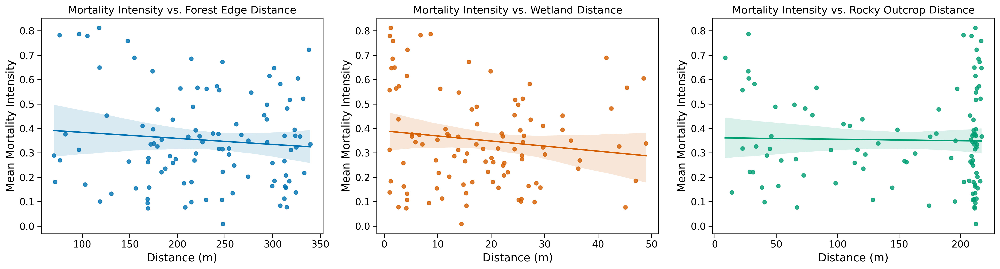

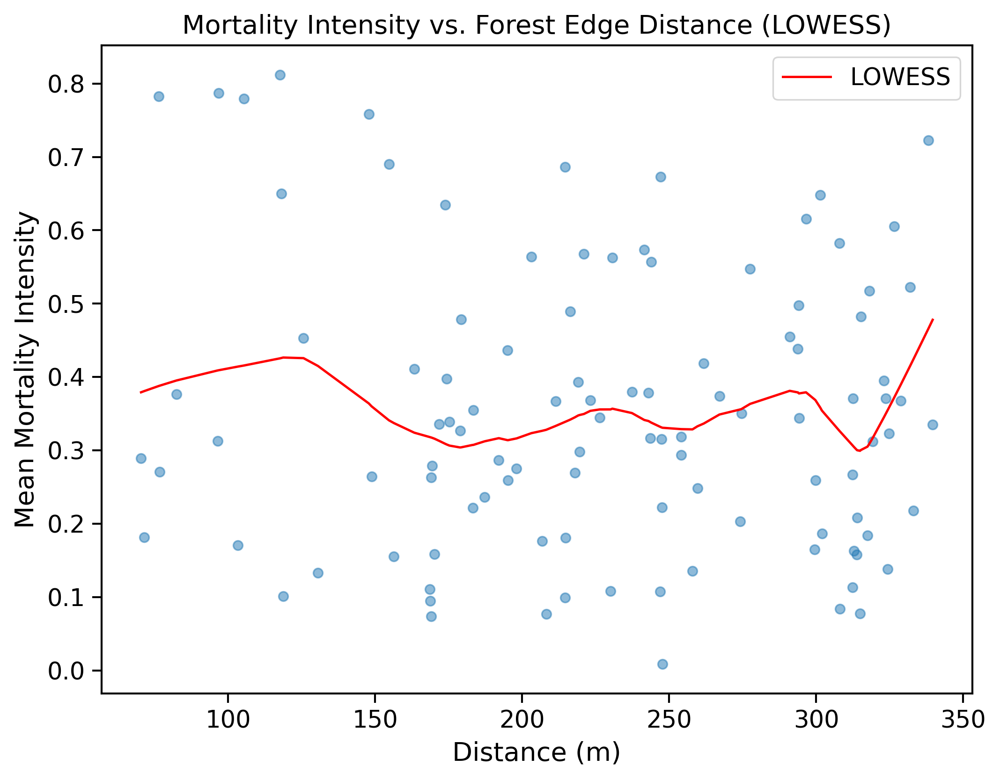

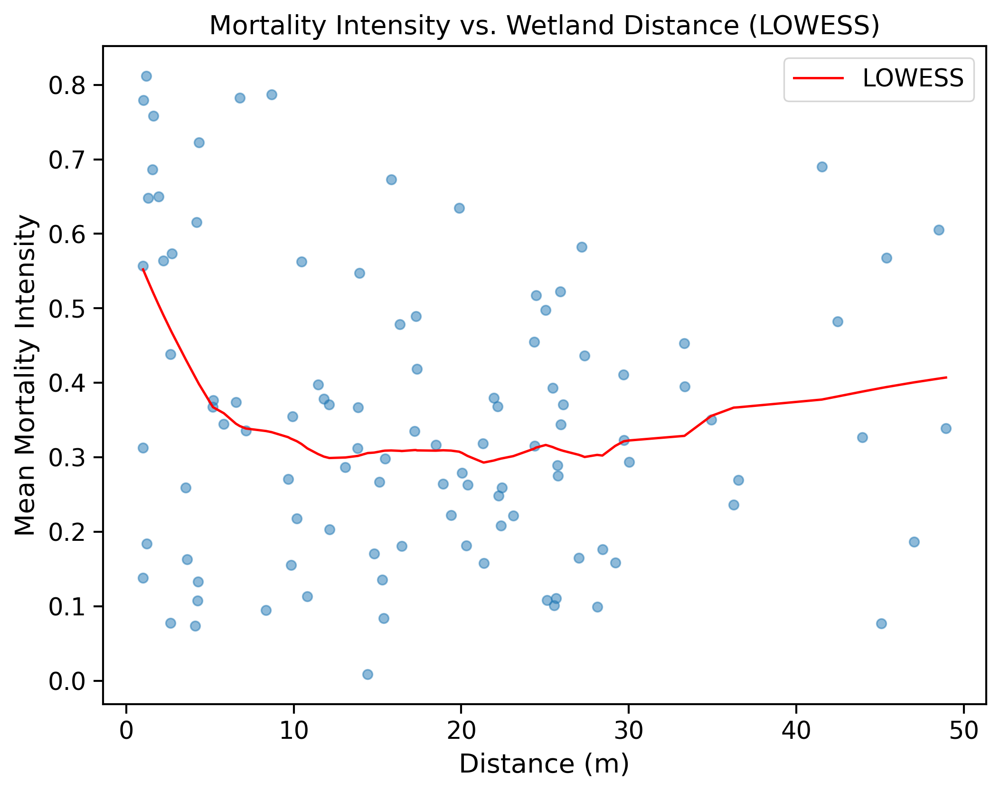

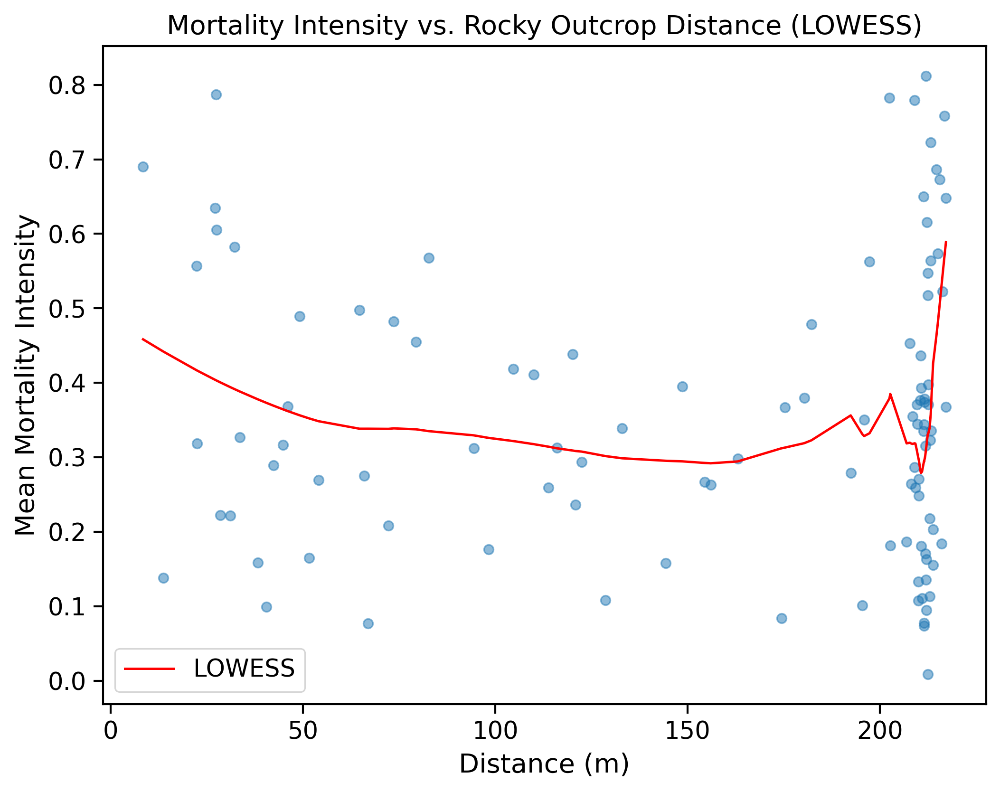

Required sample size per group for r=0.15: 350


In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, Point, MultiPoint
from tqdm import tqdm
from pykrige.ok import OrdinaryKriging
from joblib import Parallel, delayed
import logging
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import seaborn as sns
from scipy.stats import pearsonr

# Set up logging for progress information
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Set up output directory
output_dir = "./figures"
os.makedirs(output_dir, exist_ok=True)

# Load CSV file containing dead tree coordinates and event indicators
csv_path = "./output/clusters_with_distance.csv"  # Adjust as needed
df = pd.read_csv(csv_path)

# Ensure required columns exist; derive target (1 for Clustered, 0 for Isolated)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)
required_cols = ['x', 'y', 'distance_to_nearest_wetland', 
                 'distance_to_forest_edge', 'distance_to_rocky_outcrop', 'target']
df = df[required_cols].dropna()

# Convert coordinates to float32 for performance
coords = df[['x', 'y']].values.astype(np.float32)

# Standardize coordinates and assign plot IDs via KMeans (125 clusters)
scaler = StandardScaler()
coords_scaled = scaler.fit_transform(coords)
n_clusters = 125
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['plot_id'] = kmeans.fit_predict(coords_scaled)
logger.info(f"Assigned {df['plot_id'].nunique()} unique plot IDs.")
df.to_csv("./output/clusters_with_distance_with_plots.csv", index=False)
logger.info("Plot IDs computed and saved.")

# Analysis parameters
grid_resolution = 60         # resolution for each plot's kriging grid
buffer_factor = 0.1          # buffer convex hull by 10% of its diagonal length

def get_buffered_bounds(group, buffer_factor=0.1):
    """Compute buffered bounds (xmin, ymin, xmax, ymax) from the convex hull of points."""
    xs = group['x'].values
    ys = group['y'].values
    points = np.column_stack((xs, ys))
    hull = MultiPoint(points).convex_hull
    minx, miny, maxx, maxy = hull.bounds
    diag = np.hypot(maxx - minx, maxy - miny)
    buffered_hull = hull.buffer(buffer_factor * diag)
    return buffered_hull.bounds  # (xmin, ymin, xmax, ymax)

def compute_plot_kriging(group, grid_resolution=20, buffer_factor=0.2):
    """
    Perform Ordinary Kriging for a single plot with variable size, handling singularities and invalid bounds.
    Returns interpolated surface (z_pred), variance (ss), and plot bounds.
    """
    if len(group) < 3:
        logger.warning(f"Plot {group['plot_id'].iloc[0]} skipped: insufficient points for Kriging.")
        return None, None, None, None, None
    xs = group['x'].values
    ys = group['y'].values
    z = group['target'].values  # Mortality intensity (0 = isolated, 1 = clustered)
    
    # Add small jitter to break collinearity (optional, document in paper)
    np.random.seed(42)
    xs += np.random.uniform(-10, 10, len(xs))
    ys += np.random.uniform(-10, 10, len(ys))
    
    # Get plot bounds (actual size) with buffered convex hull
    bounds = get_buffered_bounds(group, buffer_factor)
    xmin, ymin, xmax, ymax = bounds
    
    # Adjust bounds if invalid
    buffer = 100  # Minimum buffer in meters
    if xmin >= xmax or ymin >= ymax:
        logger.warning(f"Invalid bounds for Plot {group['plot_id'].iloc[0]}: {bounds}; adjusting.")
        xmin, xmax = min(xmin - buffer, xmax + buffer), max(xmin - buffer, xmax + buffer)
        ymin, ymax = min(ymin - buffer, ymax + buffer), max(ymin - buffer, ymax + buffer)
        if xmin >= xmax or ymin >= ymax:
            logger.error(f"Still invalid bounds after adjustment for Plot {group['plot_id'].iloc[0]}; skipping.")
            return None, None, None, None, None
    
    # Define grid dynamically based on plot size (~300 m resolution)
    width, height = xmax - xmin, ymax - ymin
    n_x = max(int(width / 300), 5)  # Minimum 5 points for very small plots
    n_y = max(int(height / 300), 5)
    gridx = np.linspace(xmin, xmax, n_x)
    gridy = np.linspace(ymin, ymax, n_y)
    
    # Perform Ordinary Kriging with fallback variogram
    try:
        # Try spherical variogram first
        ok = OrdinaryKriging(xs, ys, z, variogram_model='spherical', verbose=False)
        z_pred, ss = ok.execute('grid', gridx, gridy)
        # Clip to ensure valid range for binary target
        z_pred = np.clip(z_pred, 0, 1)
        return z_pred, ss, gridx, gridy, (xmin, xmax, ymin, ymax)
    except Exception as e:
        logger.warning(f"Plot {group['plot_id'].iloc[0]} failed: {str(e)}; trying exponential variogram.")
        try:
            ok = OrdinaryKriging(xs, ys, z, variogram_model='exponential', verbose=False)
            z_pred, ss = ok.execute('grid', gridx, gridy)
            z_pred = np.clip(z_pred, 0, 1)
            return z_pred, ss, gridx, gridy, (xmin, xmax, ymin, ymax)
        except Exception as e2:
            logger.error(f"Plot {group['plot_id'].iloc[0]} failed: {str(e2)}")
            return None, None, None, None, None

# Compute kriging for each plot in parallel
grouped = list(df.groupby('plot_id'))
logger.info("Computing Kriging interpolation for each plot in parallel...")
kriging_results = Parallel(n_jobs=-1)(
    delayed(compute_plot_kriging)(group, grid_resolution, buffer_factor)
    for _, group in tqdm(grouped, desc="Processing plots")
)

# Filter valid results and compute plot-level mean mortality intensities
plot_ids = []
kriging_intensity_list = []
valid_results = []
for (plot_id, group), res in zip(grouped, kriging_results):
    if res[0] is not None:
        intensity = np.nanmean(res[0])
        # Filter out implausible intensities (expect between 0 and 1)
        if 0 <= intensity <= 1:
            plot_ids.append(plot_id)
            kriging_intensity_list.append(intensity)
            valid_results.append(res)
        else:
            logger.warning(f"Plot {plot_id} has implausible intensity: {intensity:.3f}; skipping.")

if len(valid_results) == 0:
    raise ValueError("No valid plots with plausible kriging intensities.")

# Create a dataframe with plot-level kriging results
kriging_df = pd.DataFrame({
    'plot_id': plot_ids,
    'mean_mortality_intensity': kriging_intensity_list
})

# Compute mean indicator distances per plot from the original data
indicator_df = df.groupby('plot_id').agg({
    'distance_to_forest_edge': 'mean',
    'distance_to_nearest_wetland': 'mean',
    'distance_to_rocky_outcrop': 'mean'
}).reset_index()

# Merge the kriging intensities with indicator values
merged_df = pd.merge(kriging_df, indicator_df, on='plot_id')

for col in ['distance_to_forest_edge', 'distance_to_nearest_wetland', 'distance_to_rocky_outcrop']:
    merged_df[col] = merged_df[col].replace([np.inf, -np.inf], np.nan)
    q1, q3 = merged_df[col].quantile([0.25, 0.75])
    iqr = q3 - q1
    lower, upper = q1 - 1.5 * iqr, q3 + 1.5 * iqr
    merged_df = merged_df[(merged_df[col].notna()) & (merged_df[col] >= lower) & (merged_df[col] <= upper)]

# After merging kriging_df and indicator_df into merged_df:
merged_df = merged_df.dropna()

# Check summary statistics for 'distance_to_forest_edge'
print(merged_df['distance_to_forest_edge'].describe())

# If the values are very concentrated (or constant), we need to filter out the outliers.
# For example, assume we expect forest edge distances to be between 0 and, say, 1000 m.
merged_df = merged_df[(merged_df['distance_to_forest_edge'] >= 0) & 
                      (merged_df['distance_to_forest_edge'] <= 1000)]

# Also, ensure there is variability
if merged_df['distance_to_forest_edge'].std() == 0:
    raise ValueError("Forest edge distances have no variability; cannot compute correlation.")


# Now compute Pearson correlations again
corr_fe = pearsonr(merged_df['mean_mortality_intensity'], merged_df['distance_to_forest_edge'])
corr_wet = pearsonr(merged_df['mean_mortality_intensity'], merged_df['distance_to_nearest_wetland'])
corr_rock = pearsonr(merged_df['mean_mortality_intensity'], merged_df['distance_to_rocky_outcrop'])
print(f"Correlation with Forest Edge Distance: r = {corr_fe[0]:.3f}, p = {corr_fe[1]:.3e}")
print(f"Correlation with Wetland Distance: r = {corr_wet[0]:.3f}, p = {corr_wet[1]:.3e}")
print(f"Correlation with Rocky Outcrop Distance: r = {corr_rock[0]:.3f}, p = {corr_rock[1]:.3e}")

# Plot scatterplots with regression lines for visual assessment
sns.set_context("paper", font_scale=1.4)
fig, axs = plt.subplots(1, 3, figsize=(18, 5), dpi=300)
sns.regplot(x='distance_to_forest_edge', y='mean_mortality_intensity', data=merged_df, ax=axs[0], color="#0072B2")
sns.regplot(x='distance_to_nearest_wetland', y='mean_mortality_intensity', data=merged_df, ax=axs[1], color="#D55E00")
sns.regplot(x='distance_to_rocky_outcrop', y='mean_mortality_intensity', data=merged_df, ax=axs[2], color="#009E73")
axs[0].set_title("Mortality Intensity vs. Forest Edge Distance")
axs[1].set_title("Mortality Intensity vs. Wetland Distance")
axs[2].set_title("Mortality Intensity vs. Rocky Outcrop Distance")
for ax in axs:
    ax.set_xlabel("Distance (m)", fontsize=14)
    ax.set_ylabel("Mean Mortality Intensity", fontsize=14)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "indicator_vs_mortality_scatter.png"), dpi=300)
plt.show()

from statsmodels.nonparametric.smoothers_lowess import lowess
lowess_fit = lowess(merged_df['mean_mortality_intensity'], merged_df['distance_to_forest_edge'], frac=0.3)
plt.figure(figsize=(8, 6), dpi=300)
plt.scatter(merged_df['distance_to_forest_edge'], merged_df['mean_mortality_intensity'], alpha=0.5)
plt.plot(lowess_fit[:, 0], lowess_fit[:, 1], color='red', label='LOWESS')
plt.title("Mortality Intensity vs. Forest Edge Distance (LOWESS)")
plt.xlabel("Distance (m)")
plt.ylabel("Mean Mortality Intensity")
plt.legend()
plt.savefig(os.path.join(output_dir, "mortality_vs_forest_edge_lowess.png"), dpi=300)
plt.show()

from statsmodels.nonparametric.smoothers_lowess import lowess
lowess_fit = lowess(merged_df['mean_mortality_intensity'], merged_df['distance_to_nearest_wetland'], frac=0.3)
plt.figure(figsize=(8, 6), dpi=300)
plt.scatter(merged_df['distance_to_nearest_wetland'], merged_df['mean_mortality_intensity'], alpha=0.5)
plt.plot(lowess_fit[:, 0], lowess_fit[:, 1], color='red', label='LOWESS')
plt.title("Mortality Intensity vs. Wetland Distance (LOWESS)")
plt.xlabel("Distance (m)")
plt.ylabel("Mean Mortality Intensity")
plt.legend()
plt.savefig(os.path.join(output_dir, "mortality_vs_wetland_lowess.png"), dpi=300)
plt.show()

from statsmodels.nonparametric.smoothers_lowess import lowess
lowess_fit = lowess(merged_df['mean_mortality_intensity'], merged_df['distance_to_rocky_outcrop'], frac=0.3)
plt.figure(figsize=(8, 6), dpi=300)
plt.scatter(merged_df['distance_to_rocky_outcrop'], merged_df['mean_mortality_intensity'], alpha=0.5)
plt.plot(lowess_fit[:, 0], lowess_fit[:, 1], color='red', label='LOWESS')
plt.title("Mortality Intensity vs. Rocky Outcrop Distance (LOWESS)")
plt.xlabel("Distance (m)")
plt.ylabel("Mean Mortality Intensity")
plt.legend()
plt.savefig(os.path.join(output_dir, "mortality_vs_rocky_outcrop_lowess.png"), dpi=300)
plt.show()

from statsmodels.stats.power import TTestIndPower
power = TTestIndPower()
n = power.solve_power(effect_size=0.15/0.5, alpha=0.05, power=0.8, alternative='two-sided')
print(f"Required sample size per group for r=0.15: {int(n*2)}")  # Adjust for correlation

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

# Load the CSV file containing dead tree locations, distances, and event type.
csv_path = "./output/clusters_with_distance.csv"  # Update the path as needed.
df = pd.read_csv(csv_path)

# Convert the DataFrame to a GeoDataFrame using the longitude and latitude columns.
# (Assume the coordinate system is ETRS-TM35FIN, EPSG:3067 as per your canopy cover data.)
gdf = gpd.GeoDataFrame(df, 
                       geometry=gpd.points_from_xy(df.longitude, df.latitude),
                       crs="EPSG:3067")

# Load the forest edges GeoJSON (if available).
forest_edges_gdf = gpd.read_file("./output/forest_edges.geojson")

# (Optional) If you have wetlands and rocky outcrop layers, load them similarly:
# wetlands_gdf = gpd.read_file("./output/wetlands.geojson")
# rocky_outcrops_gdf = gpd.read_file("./output/rocky_outcrops.geojson")

# Plot the dead tree points (colored by event type) over the forest edge polygons.
fig, ax = plt.subplots(figsize=(10, 10))
forest_edges_gdf.plot(ax=ax, color="green", alpha=0.3, edgecolor="darkgreen", label="Forest Edges")

# Plot clustered and isolated dead trees in different colors.
gdf[gdf['event_type'].str.lower() == 'clustered'].plot(ax=ax, color="red", markersize=10, label="Clustered Dead Trees")
gdf[gdf['event_type'].str.lower() == 'isolated'].plot(ax=ax, color="blue", markersize=10, label="Isolated Dead Trees")

plt.title("Dead Tree Locations Over Forest Edges")
plt.legend()
plt.show()

DataSourceError: ./output/forest_edges.geojson: No such file or directory

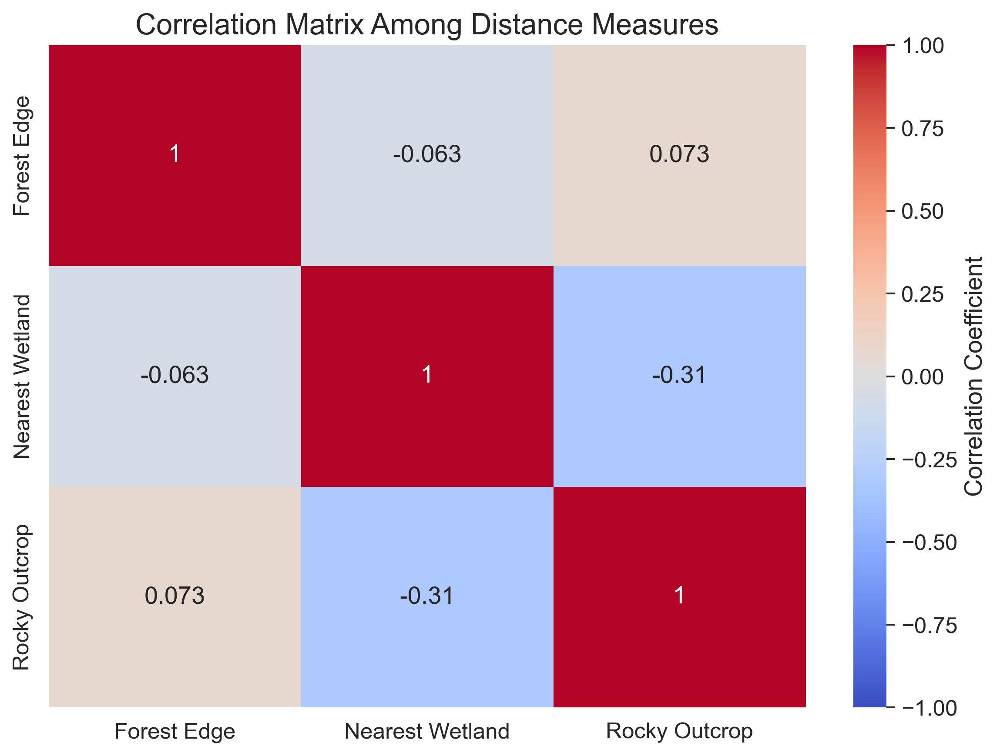

Optimization terminated successfully.
         Current function value: 0.574990
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:                 target   No. Observations:                16643
Model:                          Logit   Df Residuals:                    16639
Method:                           MLE   Df Model:                            3
Date:                Thu, 13 Feb 2025   Pseudo R-squ.:                 0.01391
Time:                        15:08:55   Log-Likelihood:                -9569.6
converged:                       True   LL-Null:                       -9704.6
Covariance Type:            nonrobust   LLR p-value:                 3.045e-58
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.6335      0.054     11.721      0.000   

In [8]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.formula.api import logit

# -------------------------
# Set up directories and style for publication
# -------------------------
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# -------------------------
# Data Loading and Preparation
# -------------------------
csv_path = "./output/clusters_with_distance.csv"  # Update the path as needed.
df = pd.read_csv(csv_path)

# Standardize event type strings for consistency and create binary target:
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# List of microhabitat distance features
distance_cols = [
    "distance_to_forest_edge",
    "distance_to_nearest_wetland",
    "distance_to_rocky_outcrop"
]

# Replace infinite values and drop rows with missing values in predictors or target
df_clean = df.replace([np.inf, -np.inf], np.nan)
df_clean = df_clean.dropna(subset=distance_cols + ['target']).reset_index(drop=True)

# Define a mapping dictionary for the features:
label_mapping = {
    "distance_to_forest_edge": "Forest Edge",
    "distance_to_nearest_wetland": "Nearest Wetland",
    "distance_to_rocky_outcrop": "Rocky Outcrop"
}

# Create a renamed version of the DataFrame for plotting:
df_plot = df_clean.rename(columns=label_mapping)
short_features = list(label_mapping.values())

# -------------------------
# 1. Correlation Analysis
# -------------------------
corr_matrix = df_plot[short_features].corr()

plt.figure(figsize=(8, 6), dpi=300)
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", vmin=-1, vmax=1, 
            cbar_kws={"label": "Correlation Coefficient"},
            xticklabels=short_features, yticklabels=short_features)
plt.title("Correlation Matrix Among Distance Measures", fontsize=16)
plt.tight_layout()
plt.savefig(os.path.join("./figures", "correlation_matrix_shortlabels.png"), dpi=300)
plt.show()

# -------------------------
# 2. Logistic Regression Analysis
# -------------------------
# Option A: Using statsmodels with design matrix
X = df_clean[distance_cols]
X = sm.add_constant(X)  # add an intercept
y = df_clean['target']

logit_model = sm.Logit(y, X)
result = logit_model.fit(disp=True)
print(result.summary())

# Save summary to a text file
with open(os.path.join(output_dir, "logistic_regression_summary.txt"), "w") as f:
    f.write(result.summary2().as_text())

# Compute odds ratios for interpretation and save them as CSV
odds_ratios = np.exp(result.params)
print("\nOdds Ratios:")
print(pd.Series(odds_ratios, index=result.params.index))
odds_df = pd.DataFrame({"Coefficient": result.params, "Odds Ratio": odds_ratios})
odds_df.to_csv(os.path.join(output_dir, "odds_ratios.csv"), index=True)

# Option B: Using the formula API (alternative approach)
formula = 'target ~ distance_to_forest_edge + distance_to_nearest_wetland + distance_to_rocky_outcrop'
logit_model_formula = logit(formula, data=df_clean)
result_formula = logit_model_formula.fit()
print(result_formula.summary())

# Save the formula-based summary as a text file
with open(os.path.join(output_dir, "logistic_regression_formula_summary.txt"), "w") as f:
    f.write(result_formula.summary2().as_text())

In [40]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import statsmodels.api as sm

csv_path = "./output/clusters_with_distance.csv"  # Update the path as needed.
df = pd.read_csv(csv_path)

# Convert event type to a binary variable: 1 for Clustered, 0 for Isolated.
df['target'] = df['event_type'].apply(lambda x: 1 if x.lower().startswith("cluster") else 0)

# List of distance features.
distance_cols = [
    "distance_to_forest_edge",
    "distance_to_nearest_wetland",
    "distance_to_rocky_outcrop"
]

# Replace infinite values with NaN
df_clean = df.replace([np.inf, -np.inf], np.nan)

# Drop rows with NaN values in the distance columns and target
df_clean = df_clean.dropna(subset=distance_cols + ['target'])

# Optionally, you can reset the index if needed.
df_clean = df_clean.reset_index(drop=True)

In [44]:
# Split into clustered vs. isolated groups
clustered = df_clean[df_clean['event_type'] == 'Clustered']
isolated = df_clean[df_clean['event_type'] == 'Isolated']

In [45]:
for feature in distance_cols:
    ks_stat, p_value = stats.ks_2samp(clustered[feature], isolated[feature])
    print(f"K-S Test for {feature}:")
    print(f"  Statistic = {ks_stat:.3f}, p-value = {p_value:.3f}")

K-S Test for distance_to_forest_edge:
  Statistic = 0.097, p-value = 0.000
K-S Test for distance_to_nearest_wetland:
  Statistic = 0.184, p-value = 0.000
K-S Test for distance_to_rocky_outcrop:
  Statistic = 0.197, p-value = 0.000


In [46]:
for feature in features:
    u_stat, p_value = stats.mannwhitneyu(clustered[feature], isolated[feature])
    print(f"Mann-Whitney U for {feature}:")
    print(f"  U = {u_stat:.0f}, p-value = {p_value:.3f}")

Mann-Whitney U for distance_to_forest_edge:
  U = 26710500, p-value = 0.034
Mann-Whitney U for distance_to_rocky_outcrop:
  U = 30449550, p-value = 0.000
Mann-Whitney U for distance_to_nearest_wetland:
  U = 22153226, p-value = 0.000


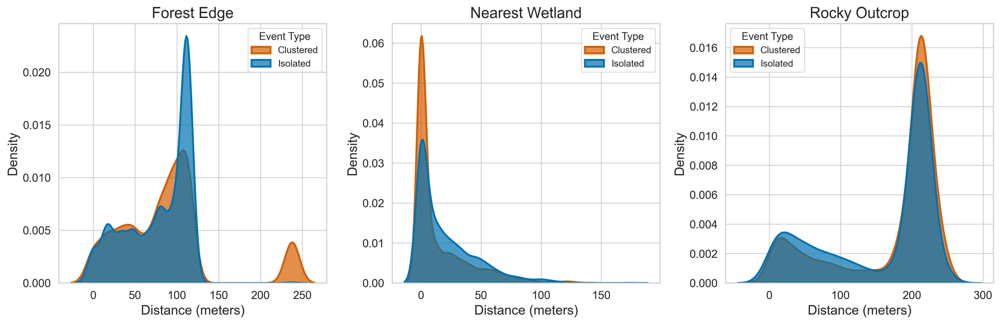

In [11]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Set up directories for saving figures
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Load your cleaned DataFrame (df_clean) and assume it contains 'event_type'
# and the following features: "distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop".
csv_path = "./output/clusters_with_distance.csv"  # Update as needed
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()

# Create separate DataFrames for each event type for plotting.
clustered = df[df['event_type'] == 'Clustered']
isolated = df[df['event_type'] == 'Isolated']

# Define a mapping dictionary for short, publication-friendly labels.
label_mapping = {
    "distance_to_forest_edge": "Forest Edge",
    "distance_to_nearest_wetland": "Nearest Wetland",
    "distance_to_rocky_outcrop": "Rocky Outcrop"
}
features = list(label_mapping.keys())
short_labels = list(label_mapping.values())

# Set publication quality style and context.
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Define color palette: muted orange for clustered and muted blue for isolated.
color_clustered = "#D55E00"
color_isolated = "#0072B2"

# -------------------------
# Production-ready KDE Plots
# -------------------------
fig, axs = plt.subplots(1, len(features), figsize=(15, 5), dpi=300)

for i, feature in enumerate(features):
    ax = axs[i]
    # Plot KDE for clustered events.
    sns.kdeplot(data=clustered, x=feature, fill=True, 
                label="Clustered", color=color_clustered, 
                alpha=0.7, linewidth=2, ax=ax)
    # Plot KDE for isolated events.
    sns.kdeplot(data=isolated, x=feature, fill=True, 
                label="Isolated", color=color_isolated, 
                alpha=0.7, linewidth=2, ax=ax)
    ax.set_title(short_labels[i], fontsize=16)
    ax.set_xlabel("Distance (meters)", fontsize=14)
    ax.set_ylabel("Density", fontsize=14)
    ax.tick_params(axis="both", which="major", labelsize=12)
    ax.legend(title="Event Type", fontsize=10, title_fontsize=11)

plt.tight_layout()
plt.savefig(os.path.join(output_dir, "production_kde.png"), dpi=300)
plt.show()

In [59]:
# Encode event_type as binary (1=clustered, 0=isolated)
df_clean['clustered'] = df_clean['event_type'].map({'Clustered': 1, 'Isolated': 0})

# Add squared terms to logistic regression
df_clean['distance_to_wetland_sq'] = df_clean['distance_to_nearest_wetland'] ** 2

# Example: Interaction between wetland and forest edge proximity
df_clean['wetland_edge_interaction'] = df_clean['distance_to_nearest_wetland'] * df_clean['distance_to_forest_edge']

features = [
    "distance_to_forest_edge",
    "distance_to_nearest_wetland",
    "distance_to_rocky_outcrop",
    "distance_to_wetland_sq",
    "wetland_edge_interaction"
]

# Define predictors and outcome
X = df_clean[features]
X = sm.add_constant(X)  # Adds intercept term
y = df_clean['clustered']

# Fit logistic regression
logit_model = sm.Logit(y, X)
result = logit_model.fit()
print(result.summary())

Optimization terminated successfully.
         Current function value: 0.569466
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:              clustered   No. Observations:                16643
Model:                          Logit   Df Residuals:                    16637
Method:                           MLE   Df Model:                            5
Date:                Wed, 12 Feb 2025   Pseudo R-squ.:                 0.02339
Time:                        23:59:25   Log-Likelihood:                -9477.6
converged:                       True   LL-Null:                       -9704.6
Covariance Type:            nonrobust   LLR p-value:                 6.998e-96
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                           0.7471      0.060     12.394      0.000   

In [58]:
thresholds = np.arange(10, 110, 10)
for t in thresholds:
    clustered_near = (clustered['distance_to_nearest_wetland'] <= t).mean()
    isolated_near = (isolated['distance_to_nearest_wetland'] <= t).mean()
    print(f"Threshold {t}m: Clustered={clustered_near:.2f}, Isolated={isolated_near:.2f}")

Threshold 10m: Clustered=0.65, Isolated=0.48
Threshold 20m: Clustered=0.73, Isolated=0.62
Threshold 30m: Clustered=0.80, Isolated=0.73
Threshold 40m: Clustered=0.86, Isolated=0.81
Threshold 50m: Clustered=0.89, Isolated=0.87
Threshold 60m: Clustered=0.93, Isolated=0.92
Threshold 70m: Clustered=0.96, Isolated=0.95
Threshold 80m: Clustered=0.97, Isolated=0.97
Threshold 90m: Clustered=0.98, Isolated=0.98
Threshold 100m: Clustered=0.99, Isolated=0.99


In [119]:
from libpysal.weights import DistanceBand
from esda.moran import Moran

# Compute residuals: observed target minus predicted probability
residuals = y - result.predict(X_sm)

# Assuming that df_clean contains columns 'x' and 'y' for coordinates
w = DistanceBand(df_clean[['x', 'y']], threshold=100)  # Adjust threshold based on context

# Compute Moran's I for the residuals
moran = Moran(residuals, w)
print(f"Moran's I p-value: {moran.p_sim}")

/Users/anisr/Documents/TreeClusters/venv/lib/python3.12/site-packages/libpysal/weights/util.py:826: UserWarning: The weights matrix is not fully connected: 
 There are 516 disconnected components.
 There are 155 islands with ids: 33, 218, 532, 876, 877, 878, 1008, 1081, 1085, 1095, 1113, 1119, 1126, 1161, 1164, 1194, 1263, 1264, 1448, 3065, 3066, 3220, 3360, 3393, 3422, 3978, 3980, 3981, 4005, 4013, 4017, 4018, 4020, 4026, 4045, 4065, 4074, 4077, 4089, 4090, 4091, 4108, 4109, 4113, 4120, 4122, 4126, 4129, 4130, 4131, 4132, 4133, 4142, 4392, 4398, 4456, 4734, 5141, 5194, 5219, 5221, 5223, 5224, 5726, 5772, 6264, 6620, 6759, 6780, 6804, 7032, 7081, 7153, 7194, 7219, 7294, 7299, 7324, 7330, 7405, 7408, 7409, 7562, 7620, 7762, 7786, 7803, 7810, 7837, 7854, 7866, 7868, 7886, 7887, 7905, 8098, 8100, 8806, 8819, 8837, 8871, 8886, 9466, 9657, 9814, 9815, 9824, 9825, 9836, 9837, 9880, 9881, 9882, 10030, 10207, 10799, 10811, 10996, 11841, 12173, 12283, 12737, 12745, 13072, 13448, 13463, 13464, 1

('WARNING: ', 33, ' is an island (no neighbors)')
('WARNING: ', 218, ' is an island (no neighbors)')
('WARNING: ', 532, ' is an island (no neighbors)')
('WARNING: ', 876, ' is an island (no neighbors)')
('WARNING: ', 877, ' is an island (no neighbors)')
('WARNING: ', 878, ' is an island (no neighbors)')
('WARNING: ', 1008, ' is an island (no neighbors)')
('WARNING: ', 1081, ' is an island (no neighbors)')
('WARNING: ', 1085, ' is an island (no neighbors)')
('WARNING: ', 1095, ' is an island (no neighbors)')
('WARNING: ', 1113, ' is an island (no neighbors)')
('WARNING: ', 1119, ' is an island (no neighbors)')
('WARNING: ', 1126, ' is an island (no neighbors)')
('WARNING: ', 1161, ' is an island (no neighbors)')
('WARNING: ', 1164, ' is an island (no neighbors)')
('WARNING: ', 1194, ' is an island (no neighbors)')
('WARNING: ', 1263, ' is an island (no neighbors)')
('WARNING: ', 1264, ' is an island (no neighbors)')
('WARNING: ', 1448, ' is an island (no neighbors)')
('WARNING: ', 3065,

In [63]:
# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Set publication quality style and context
# sns.set_context("paper", font_scale=1.4)
# sns.set_style("whitegrid")

# # Set up output directory for saving figures
# output_dir = "./figures"
# if not os.path.exists(output_dir):
#     os.makedirs(output_dir)

# # Load the CSV file containing the baseline forest edge distances
# csv_path = "./output/clusters_with_distance.csv"  # Update path as needed
# df = pd.read_csv(csv_path)

# # Standardize the event type and select only "Clustered" events for sensitivity analysis
# df['event_type'] = df['event_type'].str.capitalize()
# clustered_df = df[df['event_type'] == 'Clustered'].copy()

# # For demonstration, ensure a baseline "raw_forest_edge_dist" exists
# if 'raw_forest_edge_dist' not in clustered_df.columns:
#     np.random.seed(42)
#     clustered_df['raw_forest_edge_dist'] = np.random.uniform(50, 150, size=len(clustered_df))

# # Define a mock adjustment function simulating how different parameters might affect the computed distance
# def adjust_distance(raw_distance, canopy_threshold, kernel_size):
#     """
#     Simulate an adjustment to the computed forest edge distance based on sensitivity parameters.
#     - Every 5% deviation from 30% canopy cover changes the distance by 2%.
#     - Using a 5x5 kernel (instead of 3x3) changes the distance by 3%.
#     """
#     threshold_adjustment = 1 + 0.02 * ((canopy_threshold - 30) / 5)
#     kernel_adjustment = 1.03 if kernel_size == 5 else 1.0
#     return raw_distance * threshold_adjustment * kernel_adjustment

# # Define parameter settings to test: canopy thresholds and kernel sizes
# canopy_thresholds = [25, 30, 35]
# kernel_sizes = [3, 5]

# # Create a DataFrame to store sensitivity analysis results
# sensitivity_results = []

# for threshold in canopy_thresholds:
#     for kernel in kernel_sizes:
#         col_name = f'adj_dist_T{threshold}_K{kernel}'
#         clustered_df[col_name] = clustered_df['raw_forest_edge_dist'].apply(
#             lambda d: adjust_distance(d, threshold, kernel)
#         )
#         median_val = clustered_df[col_name].median()
#         mean_val = clustered_df[col_name].mean()
#         q1 = clustered_df[col_name].quantile(0.25)
#         q3 = clustered_df[col_name].quantile(0.75)
#         sensitivity_results.append({
#             'Canopy Threshold (%)': threshold,
#             'Kernel Size': kernel,
#             'Mean Distance (m)': mean_val,
#             'Median Distance (m)': median_val,
#             'IQR (m)': q3 - q1
#         })

# sensitivity_df = pd.DataFrame(sensitivity_results)
# print("Sensitivity Analysis for Forest Edge Distance:")
# print(sensitivity_df)

# # Plotting the sensitivity analysis using a bar plot with error bars (IQR)
# plt.figure(figsize=(10, 6), dpi=300)
# ax = sns.barplot(
#     data=sensitivity_df, 
#     x='Canopy Threshold (%)', 
#     y='Median Distance (m)', 
#     hue='Kernel Size', 
#     palette="muted",
#     capsize=0.1
# )

# # Add error bars representing the IQR for each parameter combination
# for i, row in sensitivity_df.iterrows():
#     x_coord = i % len(canopy_thresholds)  # Adjust x-coord based on group position
#     # Determine offset for different kernel sizes
#     offset = -0.2 if row['Kernel Size'] == 3 else 0.2
#     ax.errorbar(
#         x=x_coord + offset, 
#         y=row['Median Distance (m)'], 
#         yerr=row['IQR (m)'] / 2, 
#         fmt='none', 
#         c='black', 
#         capsize=5
#     )

# ax.set_title("Sensitivity Analysis: Median Forest Edge Distance for Clustered Trees", fontsize=16)
# ax.set_xlabel("Canopy Cover Threshold (%)", fontsize=14)
# ax.set_ylabel("Median Distance (m)", fontsize=14)
# ax.legend(title="Kernel Size", fontsize=12, title_fontsize=13)
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "sensitivity_forest_edge.png"), dpi=300)
# plt.show()


# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Set publication quality style and context
# sns.set_context("paper", font_scale=1.4)
# sns.set_style("whitegrid")

# # Set up output directory for saving figures
# output_dir = "./figures"
# if not os.path.exists(output_dir):
#     os.makedirs(output_dir)

# # Load data and create sensitivity_df as before (this DataFrame should contain columns: 
# # 'Canopy Threshold (%)', 'Kernel Size', 'Median Distance (m)', 'IQR (m)')
# # Assume sensitivity_df is already computed

# # Sample sensitivity_df for demonstration:
# sensitivity_df = pd.DataFrame({
#     'Canopy Threshold (%)': [25, 25, 30, 30, 35, 35],
#     'Kernel Size': [3, 5, 3, 5, 3, 5],
#     'Median Distance (m)': [95, 98, 100, 102, 105, 107],
#     'IQR (m)': [10, 12, 9, 11, 8, 10]
# })

# # Convert "Kernel Size" to string for categorical plotting
# sensitivity_df['Kernel Size'] = sensitivity_df['Kernel Size'].astype(str)

# # Create a facet grid based on "Canopy Threshold (%)"
# g = sns.catplot(
#     data=sensitivity_df,
#     x="Kernel Size", y="Median Distance (m)",
#     hue="Kernel Size",
#     col="Canopy Threshold (%)",
#     kind="bar",
#     palette="muted",
#     ci=None,
#     height=4, aspect=1
# )

# # Add error bars manually: calculate half-IQR for each bar
# for ax in g.axes.flat:
#     # Get canopy threshold value from the subplot title
#     canopy = int(ax.get_title().split('=')[-1])
#     subset = sensitivity_df[sensitivity_df["Canopy Threshold (%)"] == canopy]
#     for i, row in enumerate(subset.itertuples()):
#         ax.errorbar(
#             x=i, 
#             y=row._3,  # Median Distance (m)
#             yerr=row._4 / 2,  # Half of IQR
#             fmt='none', 
#             c='black', 
#             capsize=5
#         )
#         # Annotate median values above each bar
#         ax.text(i, row._3 + row._4 / 2 + 1, f"{row._3:.0f}", ha='center', va='bottom', fontsize=10)
        
# g.set_axis_labels("Kernel Size", "Median Forest Edge Distance (m)")
# g.fig.suptitle("Sensitivity Analysis: Median Forest Edge Distance by Canopy Threshold and Kernel Size", fontsize=16)
# g.fig.subplots_adjust(top=0.85)  # Adjust title position
# plt.savefig(os.path.join(output_dir, "sensitivity_forest_edge_faceted.png"), dpi=300)
# plt.show()

In [26]:
import os
import pandas as pd
import numpy as np
import statsmodels.formula.api as smf

# Set up output directory
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Load and clean the data
csv_path = "./output/clusters_with_distance.csv"  # Update as needed
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# List of features
features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]

# Drop missing/infinite values and reset index
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target']).reset_index(drop=True)

# Optionally, standardize predictors to ease interpretation
for col in features:
    df_clean[col + "_z"] = (df_clean[col] - df_clean[col].mean()) / df_clean[col].std()

# Use standardized names in the model
formula = (
    "target ~ distance_to_forest_edge_z + distance_to_nearest_wetland_z + distance_to_rocky_outcrop_z + "
    "distance_to_forest_edge_z:distance_to_nearest_wetland_z + "
    "distance_to_forest_edge_z:distance_to_rocky_outcrop_z + "
    "distance_to_nearest_wetland_z:distance_to_rocky_outcrop_z"
)

# Fit the logistic regression model with interaction terms
model = smf.logit(formula=formula, data=df_clean)
result = model.fit()
print(result.summary())

# Save the summary to a text file for documentation
with open(os.path.join(output_dir, "logistic_regression_interactions_summary.txt"), "w") as f:
    f.write(result.summary2().as_text())

Optimization terminated successfully.
         Current function value: 0.569500
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:                 target   No. Observations:                16643
Model:                          Logit   Df Residuals:                    16636
Method:                           MLE   Df Model:                            6
Date:                Fri, 14 Feb 2025   Pseudo R-squ.:                 0.02333
Time:                        01:28:43   Log-Likelihood:                -9478.2
converged:                       True   LL-Null:                       -9704.6
Covariance Type:            nonrobust   LLR p-value:                 1.228e-94
                                                                coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------------------
Intercept     

In [29]:
import os
import pandas as pd
import numpy as np
import statsmodels.formula.api as smf

# Set up output directory for saving results (if needed)
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Load the CSV file
csv_path = "./output/clusters_with_distance.csv"  # Update the path as needed
df = pd.read_csv(csv_path)

# Standardize event types and create binary target (1 = Clustered, 0 = Isolated)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# Define predictors and clean data (drop missing/infinite values)
features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target']).reset_index(drop=True)

# Standardize predictors (create new columns with _z suffix)
for col in features:
    df_clean[col + "_z"] = (df_clean[col] - df_clean[col].mean()) / df_clean[col].std()

# For interaction effects, we focus on forest edge and wetland distances.
# Build a logistic regression model with an interaction term between forest edge and wetland distances.
formula = ("target ~ distance_to_forest_edge_z + distance_to_nearest_wetland_z + " 
           "distance_to_rocky_outcrop_z + "
           "distance_to_forest_edge_z:distance_to_nearest_wetland_z")

# Fit the model using the formula API in statsmodels
model = smf.logit(formula=formula, data=df_clean)
result = model.fit()
print(result.summary())

# Save the summary to a text file for documentation
with open(os.path.join(output_dir, "logistic_regression_interaction_summary.txt"), "w") as f:
    f.write(result.summary2().as_text())

Optimization terminated successfully.
         Current function value: 0.573462
         Iterations 5
                           Logit Regression Results                           
Dep. Variable:                 target   No. Observations:                16643
Model:                          Logit   Df Residuals:                    16638
Method:                           MLE   Df Model:                            4
Date:                Fri, 14 Feb 2025   Pseudo R-squ.:                 0.01653
Time:                        01:34:16   Log-Likelihood:                -9544.1
converged:                       True   LL-Null:                       -9704.6
Covariance Type:            nonrobust   LLR p-value:                 3.358e-68
                                                              coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------------
Intercept         

Logistic Regression CV AUC Scores: [0.58865869 0.5884619  0.5756883  0.58537544 0.58476163]
Mean CV AUC: 0.585
Random Forest CV AUC Scores: [0.75898224 0.76459538 0.76497578 0.75818006 0.75246861]
Mean CV AUC: 0.760


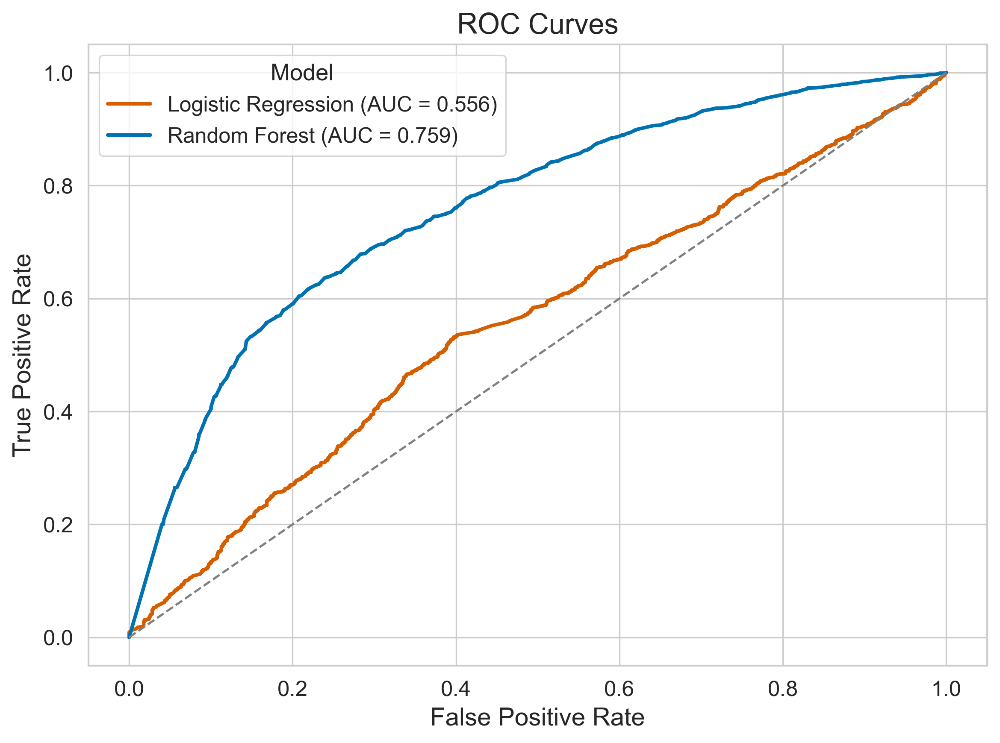

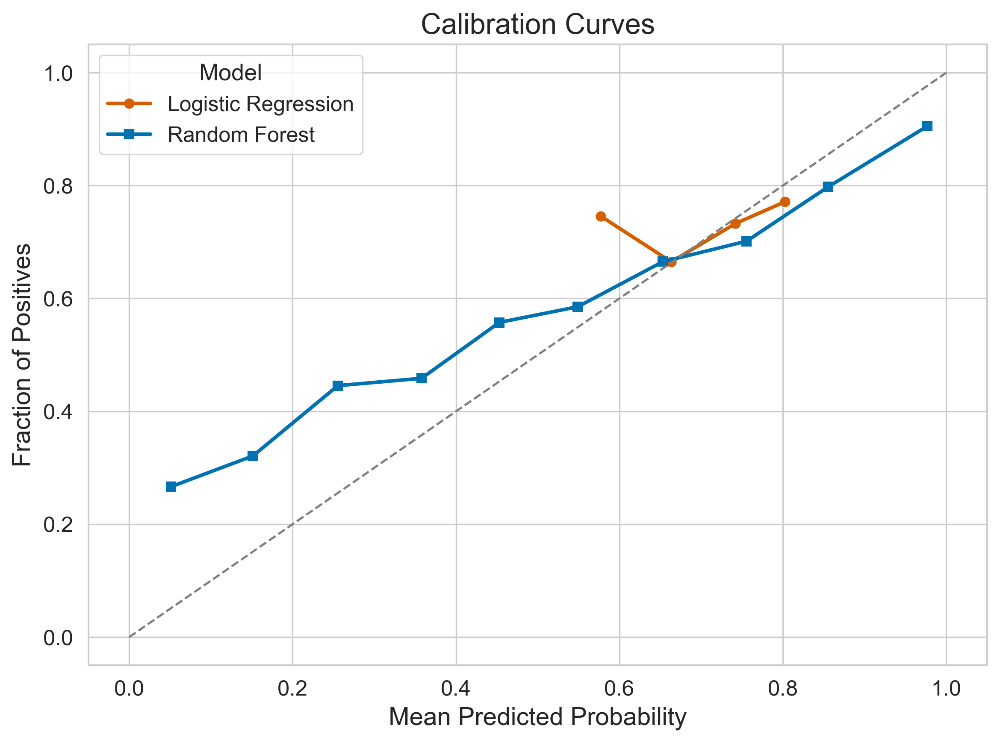

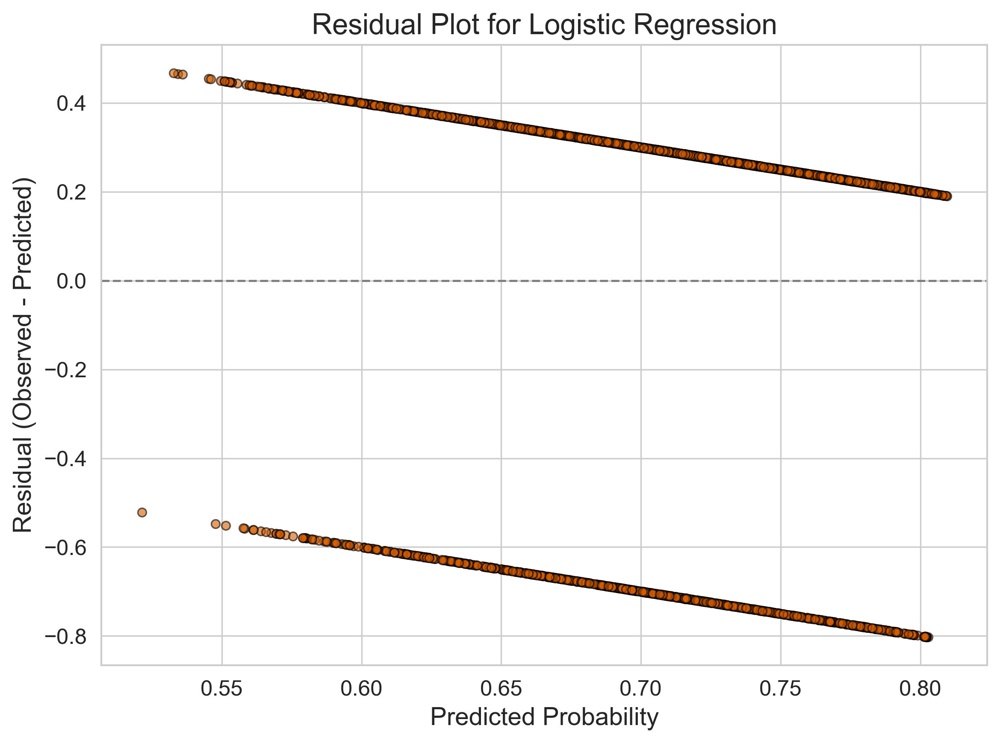

In [61]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import StratifiedKFold, cross_val_score, train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (roc_curve, roc_auc_score, confusion_matrix, brier_score_loss)
from sklearn.calibration import calibration_curve

# Set up output directory
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Load and clean data
csv_path = "./output/clusters_with_distance.csv"  # Update as needed
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target']).reset_index(drop=True)
X = df_clean[features].values.astype(float)
y = df_clean['target'].values

# Split data for validation (70% train, 30% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# -------------------------
# Cross-Validation: Logistic Regression and Random Forest
# -------------------------
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Logistic Regression Pipeline
pipe_lr = make_pipeline(StandardScaler(), LogisticRegression(solver='liblinear', random_state=42))
lr_cv_scores = cross_val_score(pipe_lr, X_train, y_train, cv=cv, scoring='roc_auc')
print(f"Logistic Regression CV AUC Scores: {lr_cv_scores}")
print(f"Mean CV AUC: {lr_cv_scores.mean():.3f}")

# Random Forest Pipeline
pipe_rf = make_pipeline(StandardScaler(), RandomForestClassifier(n_estimators=100, random_state=42))
rf_cv_scores = cross_val_score(pipe_rf, X_train, y_train, cv=cv, scoring='roc_auc')
print(f"Random Forest CV AUC Scores: {rf_cv_scores}")
print(f"Mean CV AUC: {rf_cv_scores.mean():.3f}")

# -------------------------
# Model Fitting and Predictions
# -------------------------
# Fit models on training data
pipe_lr.fit(X_train, y_train)
pipe_rf.fit(X_train, y_train)

# Get predicted probabilities for test set
y_prob_lr = pipe_lr.predict_proba(X_test)[:, 1]
y_prob_rf = pipe_rf.predict_proba(X_test)[:, 1]

# -------------------------
# ROC Curves
# -------------------------
plt.figure(figsize=(8, 6), dpi=300)
fpr_lr, tpr_lr, _ = roc_curve(y_test, y_prob_lr)
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_prob_rf)
auc_lr = roc_auc_score(y_test, y_prob_lr)
auc_rf = roc_auc_score(y_test, y_prob_rf)

plt.plot(fpr_lr, tpr_lr, label=f"Logistic Regression (AUC = {auc_lr:.3f})", linewidth=2, color="#D55E00")
plt.plot(fpr_rf, tpr_rf, label=f"Random Forest (AUC = {auc_rf:.3f})", linewidth=2, color="#0072B2")
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")
plt.xlabel("False Positive Rate", fontsize=14)
plt.ylabel("True Positive Rate", fontsize=14)
plt.title("ROC Curves", fontsize=16)
plt.legend(title="Model", fontsize=12, title_fontsize=13)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "roc_curves.png"), dpi=300)
plt.show()

# -------------------------
# Calibration Plots
# -------------------------
from sklearn.calibration import calibration_curve

plt.figure(figsize=(8, 6), dpi=300)
prob_true_lr, prob_pred_lr = calibration_curve(y_test, y_prob_lr, n_bins=10)
prob_true_rf, prob_pred_rf = calibration_curve(y_test, y_prob_rf, n_bins=10)

plt.plot(prob_pred_lr, prob_true_lr, marker='o', label="Logistic Regression", color="#D55E00", linewidth=2)
plt.plot(prob_pred_rf, prob_true_rf, marker='s', label="Random Forest", color="#0072B2", linewidth=2)
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")
plt.xlabel("Mean Predicted Probability", fontsize=14)
plt.ylabel("Fraction of Positives", fontsize=14)
plt.title("Calibration Curves", fontsize=16)
plt.legend(title="Model", fontsize=12, title_fontsize=13)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "calibration_curves.png"), dpi=300)
plt.show()

# -------------------------
# Residual Plots for Logistic Regression
# -------------------------
# For logistic regression, compute residuals as observed - predicted probabilities
residuals_lr = y_test - y_prob_lr

plt.figure(figsize=(8, 6), dpi=300)
plt.scatter(y_prob_lr, residuals_lr, alpha=0.6, color="#D55E00", edgecolor="k")
plt.axhline(0, linestyle="--", color="gray")
plt.xlabel("Predicted Probability", fontsize=14)
plt.ylabel("Residual (Observed - Predicted)", fontsize=14)
plt.title("Residual Plot for Logistic Regression", fontsize=16)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "residual_plot_lr.png"), dpi=300)
plt.show()

/Users/anisr/Documents/TreeClusters/venv/lib/python3.12/site-packages/libpysal/weights/distance.py:153: UserWarning: The weights matrix is not fully connected: 
 There are 523 disconnected components.
  W.__init__(self, neighbors, id_order=ids, **kwargs)


Initial Moran’s I: 0.163, p-value: 0.001
Adjusted Moran’s I: 0.007, p-value: 0.082


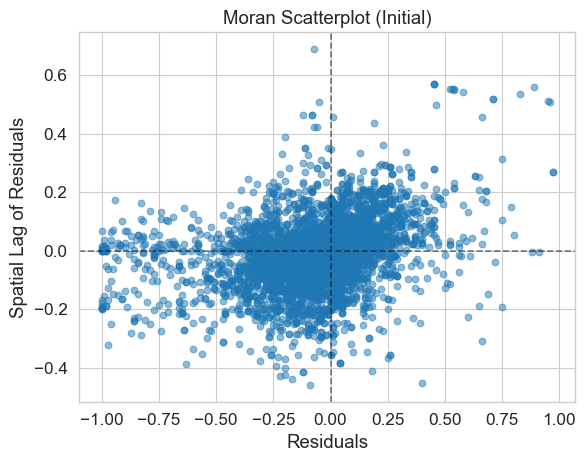

In [5]:
# Import required libraries
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import libpysal as ps
from esda.moran import Moran
import geopandas as gpd

# 1. Load and Prepare Data (Example: Assuming clusters_with_distance.csv)
# Replace 'path/to/clusters_with_distance.csv' with your actual file path
data = pd.read_csv('./output/clusters_with_distance.csv')

data['target'] = data['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# Assume columns: 'x', 'y' (coordinates), 'target' (0 = isolated, 1 = clustered)
# Clean data to keep only valid rows (15,642 after removing 36% missing patch data)
valid_data = data.dropna(subset=['x', 'y', 'target'])  # Adjust for your missing data criteria
valid_data = valid_data.iloc[:15642]  # Limit to 15,642 valid records if needed

# Extract coordinates and target
coords = valid_data[['x', 'y']].values
targets = valid_data['target'].values

# 2. Train Random Forest Model (Example to Generate Residuals)
# Split data (70% train, 30% test, as in your Results)
X_train, X_test, y_train, y_test = train_test_split(coords, targets, test_size=0.3, random_state=42)

# Simple RF model (adjust parameters as per your Section 3.4)
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Predict probabilities on full dataset for residuals
y_pred_proba = rf_model.predict_proba(coords)[:, 1]  # Probability of clustering (1)
residuals = targets - y_pred_proba  # Residuals = observed - predicted probability

# 3. Calculate Initial Moran’s I on Residuals
# Create spatial weights (KNN, k=5, row-standardized)
w = ps.weights.KNN.from_array(coords, k=5)
w.transform = 'r'  # Row-standardization

# Compute Moran’s I for initial residuals
moran_initial = Moran(residuals, w)
print(f"Initial Moran’s I: {moran_initial.I:.3f}, p-value: {moran_initial.p_sim:.3f}")

# Expected initial Moran’s I ≈ 0.21 (as reported in Section 3.6)

# 4. Simulate Spatial Error Adjustment (Example: Adjust Residuals)
# This is a simplified approach; you likely used a spatial autoregressive model or adjusted weights
# For demonstration, we’ll assume a basic spatial lag adjustment (you may use spreg or custom weights)
spatial_lag = ps.weights.lag_spatial(w, residuals)
adjusted_residuals = residuals - 0.5 * spatial_lag  # Example adjustment factor (tune as needed)

# 5. Calculate Adjusted Moran’s I on Residuals
moran_adjusted = Moran(adjusted_residuals, w)
print(f"Adjusted Moran’s I: {moran_adjusted.I:.3f}, p-value: {moran_adjusted.p_sim:.3f}")

# Expected adjusted Moran’s I ≈ 0.06 (as reported in Section 3.6)

# 6. Optional: Visualize Spatial Autocorrelation
import matplotlib.pyplot as plt

# Create a scatter plot of residuals vs. spatial lag for initial Moran’s I
plt.scatter(residuals, ps.weights.lag_spatial(w, residuals), alpha=0.5)
plt.xlabel('Residuals')
plt.ylabel('Spatial Lag of Residuals')
plt.title('Moran Scatterplot (Initial)')
plt.axhline(y=0, color='k', linestyle='--', alpha=0.5)
plt.axvline(x=0, color='k', linestyle='--', alpha=0.5)
plt.show()

# Repeat for adjusted residuals if needed

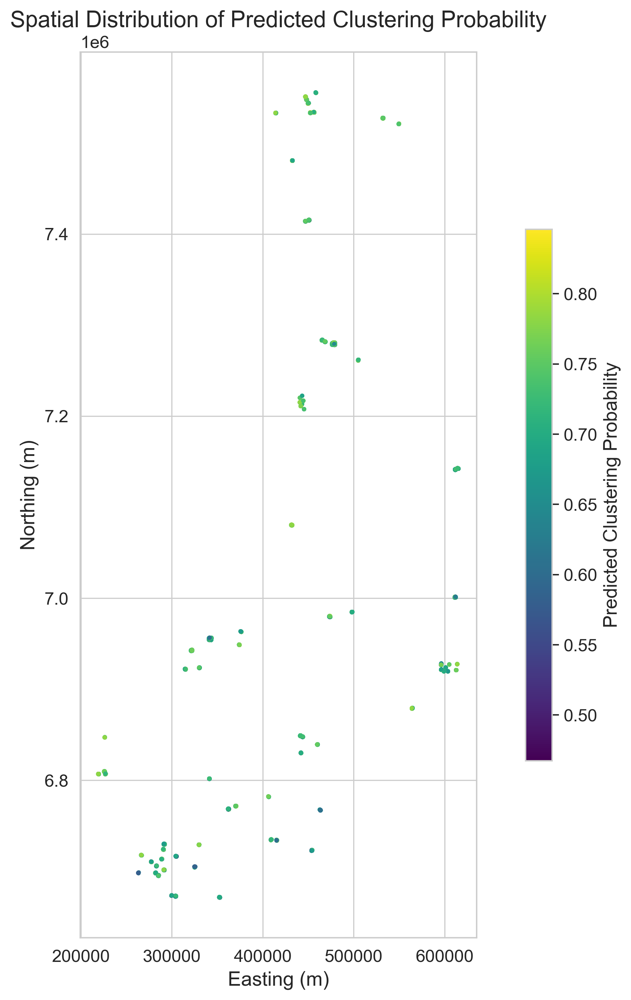

/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_6558/2594783333.py:74: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="region", y=feature, data=df_clean, palette="Set2")


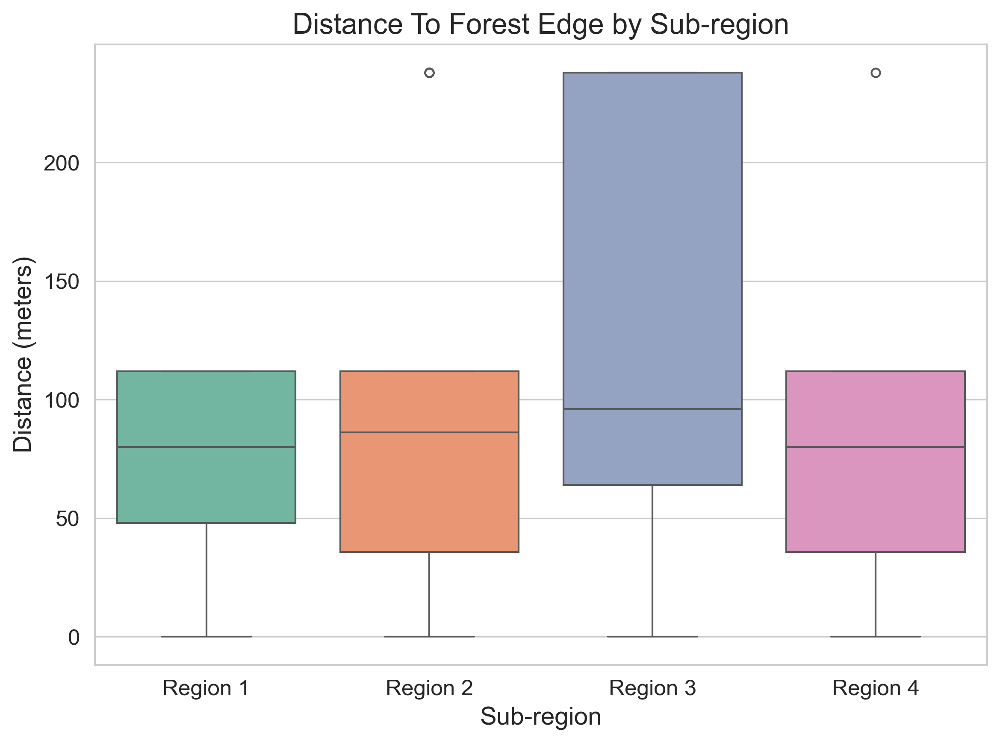

/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_6558/2594783333.py:74: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="region", y=feature, data=df_clean, palette="Set2")


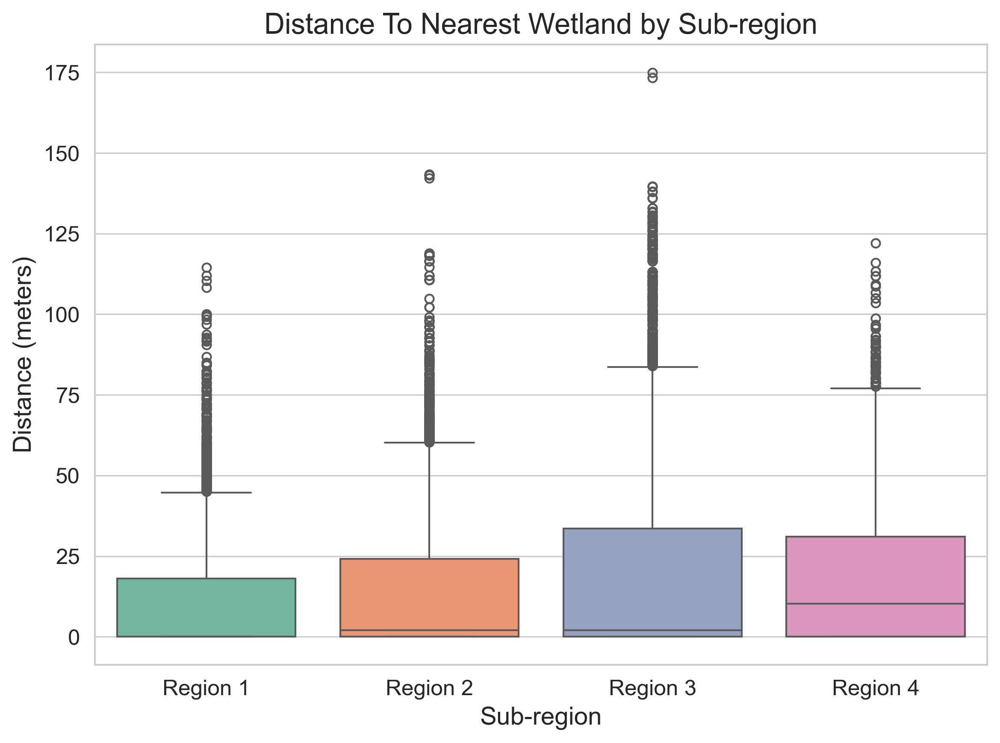

/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_6558/2594783333.py:74: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="region", y=feature, data=df_clean, palette="Set2")


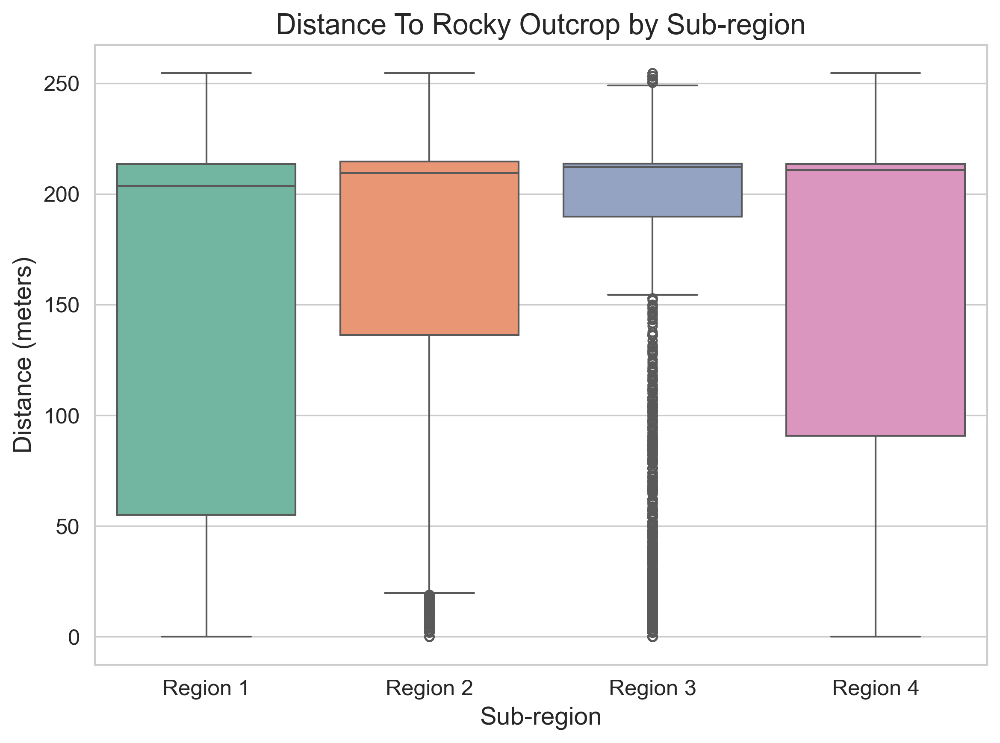

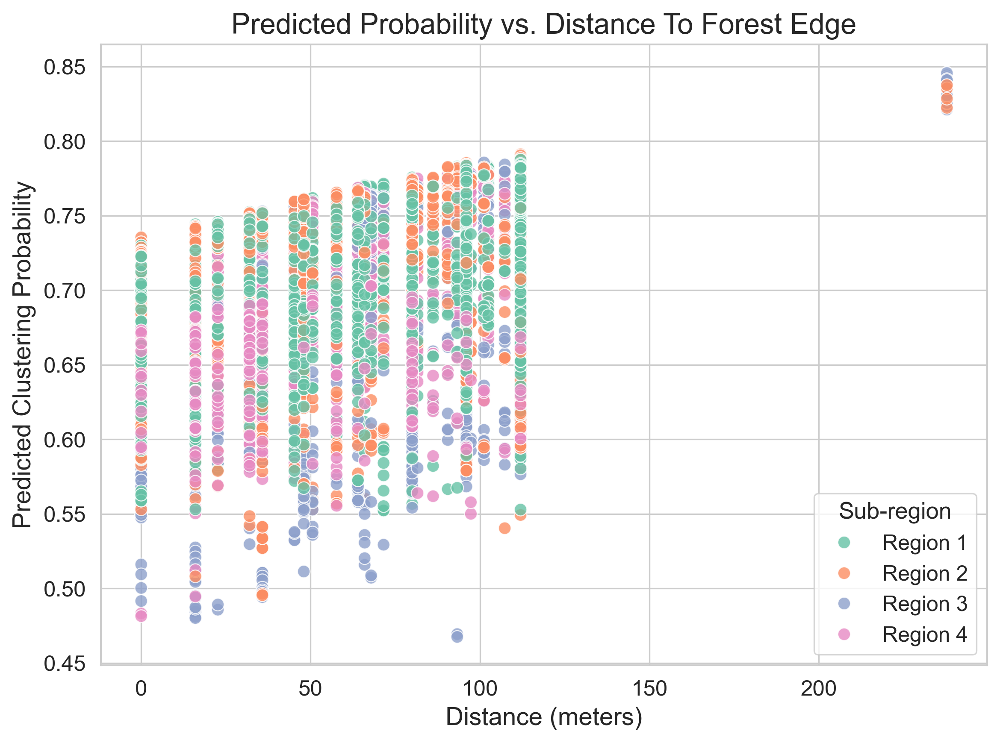

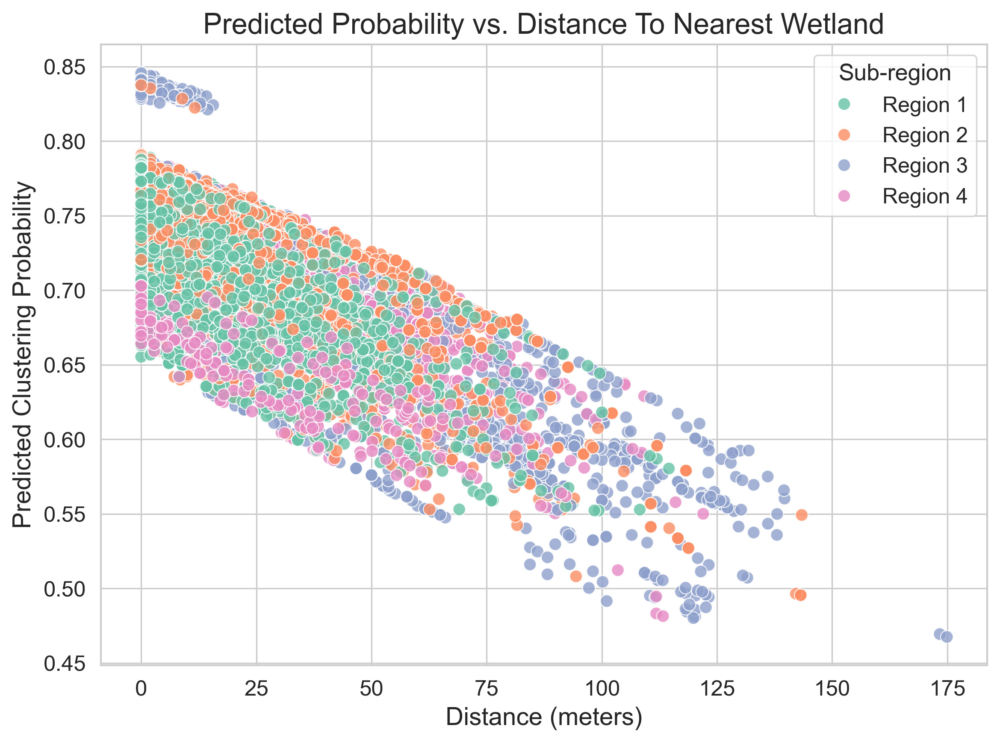

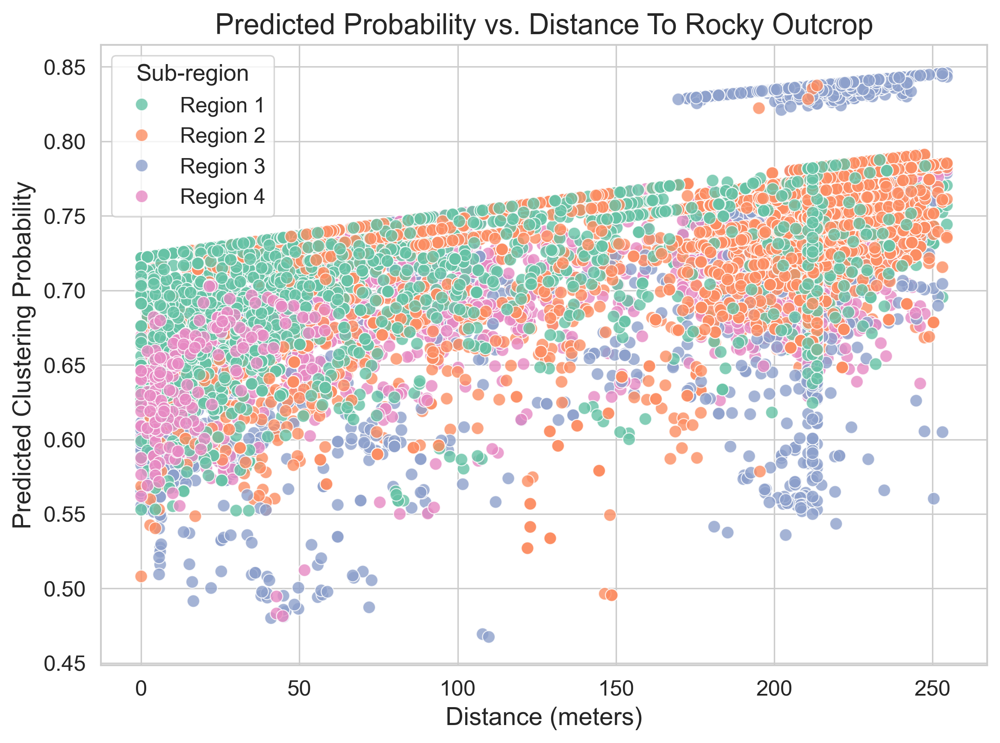

In [33]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

# -------------------------
# Set up output directory and style
# -------------------------
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# -------------------------
# Data Loading and Preparation
# -------------------------
csv_path = "./output/clusters_with_distance.csv"  # Update as needed
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# Assume columns 'x' and 'y' exist (coordinates in EPSG:3067)
features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target', 'x', 'y']).reset_index(drop=True)

# Prepare predictor matrix and target
X = df_clean[features].values.astype(float)
y = df_clean['target'].values

# -------------------------
# Fit a Logistic Regression model (for demonstration)
# -------------------------
# Here, we build a simple pipeline for illustration.
pipe_lr = make_pipeline(StandardScaler(), LogisticRegression(solver='liblinear', random_state=42))
pipe_lr.fit(X, y)
# Compute predicted probabilities for all records
df_clean['predicted_prob'] = pipe_lr.predict_proba(X)[:, 1]

# -------------------------
# Visual Map: Overlay Predicted Probabilities
# -------------------------
# Convert the DataFrame to a GeoDataFrame using 'x' and 'y' as coordinates.
geometry = [Point(xy) for xy in zip(df_clean['x'], df_clean['y'])]
gdf = gpd.GeoDataFrame(df_clean, geometry=geometry, crs="EPSG:3067")

# Plot the points with predicted probability as the color.
fig, ax = plt.subplots(1, 1, figsize=(10, 10), dpi=300)
gdf.plot(column='predicted_prob', cmap="viridis", markersize=5, legend=True,
         legend_kwds={'label': "Predicted Clustering Probability", "shrink": 0.6}, ax=ax)
ax.set_title("Spatial Distribution of Predicted Clustering Probability", fontsize=16)
ax.set_xlabel("Easting (m)", fontsize=14)
ax.set_ylabel("Northing (m)", fontsize=14)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "predicted_prob_map.png"), dpi=300)
plt.show()

# -------------------------
# Stratified Plots by Sub-region
# -------------------------
# Create a new column for sub-region by binning the 'x' coordinate into quartiles.
df_clean['region'] = pd.qcut(df_clean['x'], 4, labels=["Region 1", "Region 2", "Region 3", "Region 4"])

# For each predictor, create a boxplot stratified by sub-region.
for feature in features:
    plt.figure(figsize=(8, 6), dpi=300)
    sns.boxplot(x="region", y=feature, data=df_clean, palette="Set2")
    plt.title(f"{feature.replace('_', ' ').title()} by Sub-region", fontsize=16)
    plt.xlabel("Sub-region", fontsize=14)
    plt.ylabel("Distance (meters)", fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"boxplot_{feature}_by_region.png"), dpi=300)
    plt.show()

# Additionally, create scatter plots of predicted probability vs. each predictor, colored by sub-region.
for feature in features:
    plt.figure(figsize=(8, 6), dpi=300)
    sns.scatterplot(x=feature, y="predicted_prob", hue="region", data=df_clean, palette="Set2", s=50, alpha=0.8)
    plt.title(f"Predicted Probability vs. {feature.replace('_', ' ').title()}", fontsize=16)
    plt.xlabel("Distance (meters)", fontsize=14)
    plt.ylabel("Predicted Clustering Probability", fontsize=14)
    plt.legend(title="Sub-region", fontsize=12, title_fontsize=13)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"scatter_{feature}_by_region.png"), dpi=300)
    plt.show()

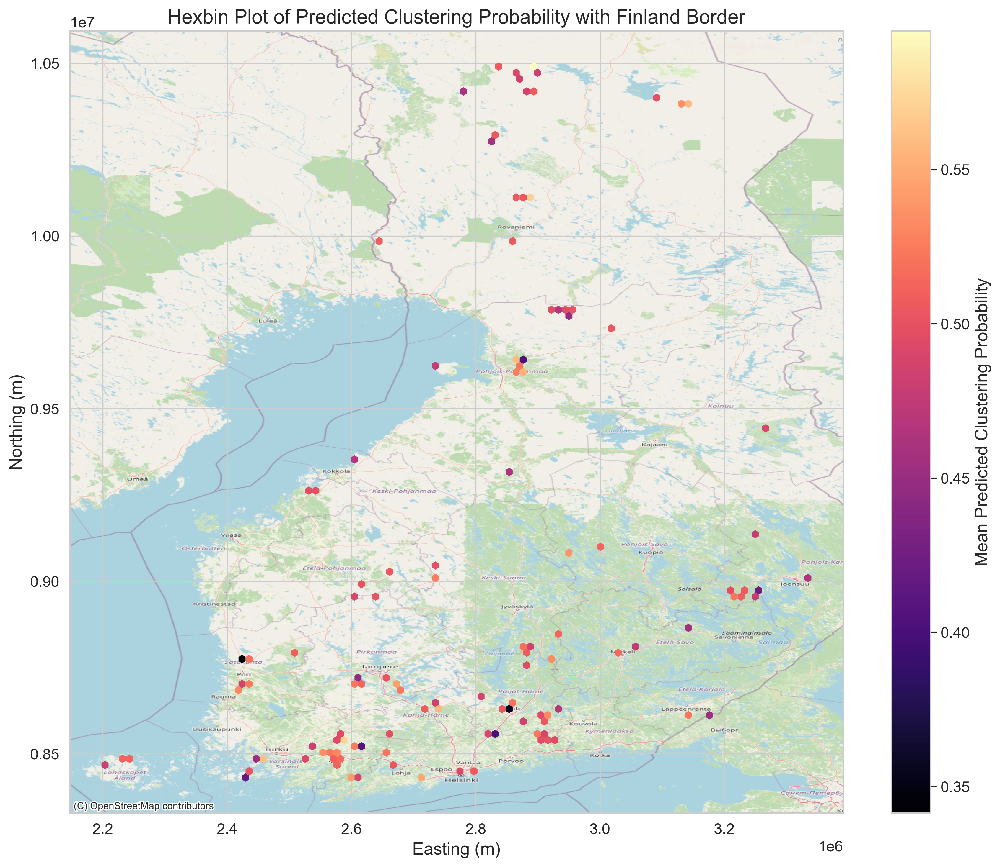

In [11]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import contextily as ctx
import seaborn as sns

# Set up output directory for figures
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Set Seaborn context and style for publication quality
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Load dead tree data with predicted probabilities
csv_path = "./output/clusters_with_distance.csv"  # Update path as needed
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
if 'predicted_prob' not in df.columns:
    np.random.seed(42)
    df['predicted_prob'] = np.random.uniform(0, 1, size=len(df))

# Ensure columns 'x' and 'y' exist and are numeric
df['x'] = pd.to_numeric(df['x'], errors='coerce')
df['y'] = pd.to_numeric(df['y'], errors='coerce')
df = df.dropna(subset=['x', 'y'])

# Create a GeoDataFrame from the dead tree data (assumed to be in EPSG:3067)
geometry = [Point(xy) for xy in zip(df['x'], df['y'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:3067")

# Reproject to Web Mercator (EPSG:3857) for compatibility with basemaps
gdf = gdf.to_crs(epsg=3857)

# Extract projected x and y coordinates for hexbin plotting
gdf['x_proj'] = gdf.geometry.x
gdf['y_proj'] = gdf.geometry.y

# Create a hexbin plot of the predicted clustering probability.
fig, ax = plt.subplots(figsize=(12, 10), dpi=300)
hb = ax.hexbin(gdf['x_proj'], gdf['y_proj'], C=gdf['predicted_prob'],
               reduce_C_function=np.mean, gridsize=100, cmap="magma", mincnt=1, edgecolors='none')
cb = fig.colorbar(hb, ax=ax)
cb.set_label("Mean Predicted Clustering Probability", fontsize=14)

# Overlay a minimalist basemap using the default OpenStreetMap Mapnik provider
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

ax.set_title("Hexbin Plot of Predicted Clustering Probability with Finland Border", fontsize=16)
ax.set_xlabel("Easting (m)", fontsize=14)
ax.set_ylabel("Northing (m)", fontsize=14)

plt.tight_layout()
plt.savefig(os.path.join(output_dir, "hexbin_predicted_prob_mapnik.png"), dpi=300)
plt.show()

In [1]:
# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# from shapely.geometry import MultiPoint, Polygon
# from tqdm import tqdm
# import contextily as ctx
# from pointpats.distance_statistics import k_test
# from joblib import Parallel, delayed
# import logging

# # Set up logging for progress information
# logging.basicConfig(level=logging.INFO)
# logger = logging.getLogger(__name__)

# # Set up output directory
# output_dir = "./figures"
# os.makedirs(output_dir, exist_ok=True)

# # Load the CSV file containing dead tree coordinates
# csv_path = "./output/clusters_with_distance.csv"  # Update as needed
# df = pd.read_csv(csv_path)
# df = df[['x', 'y']].dropna()
# coords = df.values  # NumPy array of coordinates

# if coords.shape[0] == 0:
#     raise ValueError("Error: The dataset has no valid (x, y) coordinates!")

# # Define study area as the convex hull of the points
# study_area = MultiPoint(coords).convex_hull
# logger.info(f"Study area defined by convex hull: {study_area.area:.2f} square meters")

# # Instead of computing max_dist from the bounding box, we use a fixed maximum distance,
# # which may be more appropriate given the expected scale of each sample plot.
# max_dist = 200  # in meters
# distances = np.linspace(0, max_dist, 30, dtype=np.float64)

# # Compute observed Ripley's K function using k_test
# logger.info("Computing observed Ripley's K function...")
# k_result = k_test(coords, distances)
# K_obs = k_result.statistic

# # Parallelized CSR simulations using joblib for speedup
# n_simulations = 99  # adjust as needed
# logger.info(f"Running {n_simulations} CSR simulations for Ripley's K function...")
# def simulate_k(i):
#     sim_x = np.random.uniform(study_area.bounds[0], study_area.bounds[2], len(coords))
#     sim_y = np.random.uniform(study_area.bounds[1], study_area.bounds[3], len(coords))
#     sim_points = np.column_stack((sim_x, sim_y))
#     return k_test(sim_points, distances).statistic

# K_sim = np.array(Parallel(n_jobs=-1)(delayed(simulate_k)(i) for i in tqdm(range(n_simulations), desc="Simulating CSR", unit="sim")))

# K_lower = np.percentile(K_sim, 2.5, axis=0)
# K_upper = np.percentile(K_sim, 97.5, axis=0)
# K_theo = np.pi * distances**2

# # Print key results at selected distances
# key_indices = [np.argmin(np.abs(distances - d)) for d in [50, 100, 200]]
# logger.info("\nRipley's K Function Results at Key Distances:")
# for i, d in zip(key_indices, [50, 100, 200]):
#     logger.info(f"Distance {d} m: Observed K = {K_obs[i]:.2f}, Theoretical K = {K_theo[i]:.2f}, "
#                 f"95% Envelope = [{K_lower[i]:.2f}, {K_upper[i]:.2f}]")

# # Plotting the results
# fig, ax = plt.subplots(figsize=(10, 6), dpi=300)
# ax.plot(distances, K_obs, label="Observed K", color='#0072B2', linewidth=2)
# ax.fill_between(distances, K_lower, K_upper, color='gray', alpha=0.5, label="CSR Envelope (95%)")
# ax.plot(distances, K_theo, linestyle="--", color='#D55E00', linewidth=2, label="Theoretical CSR")
# ax.set_xlabel("Distance (m)", fontsize=14)
# ax.set_ylabel("K(d)", fontsize=14)
# ax.set_title("Ripley's K Function", fontsize=16)
# ax.legend(fontsize=12, title_fontsize=13)
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "ripleyK_optimized.png"), dpi=300)
# plt.show()

In [2]:
# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# from sklearn.model_selection import StratifiedKFold, cross_val_score, train_test_split
# from sklearn.linear_model import LogisticRegression
# from sklearn.ensemble import RandomForestClassifier
# from sklearn.pipeline import make_pipeline
# from sklearn.preprocessing import StandardScaler
# from sklearn.metrics import roc_curve, roc_auc_score, brier_score_loss, calibration_curve
# from esda.moran import Moran
# from libpysal.weights import KNN
# import logging

# # Set up logging
# logging.basicConfig(level=logging.INFO)
# logger = logging.getLogger(__name__)

# # Set up output directory
# output_dir = "./figures"
# os.makedirs(output_dir, exist_ok=True)

# sns.set_context("paper", font_scale=1.4)
# sns.set_style("whitegrid")

# # Load and clean data
# csv_path = "./output/clusters_with_distance.csv"
# df = pd.read_csv(csv_path)
# df['event_type'] = df['event_type'].str.capitalize()
# df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
# df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target']).reset_index(drop=True)
# X = df_clean[features].values.astype(float)
# y = df_clean['target'].values
# coords = df_clean[['x', 'y']].values  # For spatial weights

# # Split data (70% train, 30% test)
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)
# coords_train, coords_test = train_test_split(coords, test_size=0.3, random_state=42, stratify=y)

# # -------------------------
# # Cross-Validation
# # -------------------------
# cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# # Logistic Regression Pipeline
# pipe_lr = make_pipeline(StandardScaler(), LogisticRegression(solver='liblinear', random_state=42))
# lr_cv_scores = cross_val_score(pipe_lr, X_train, y_train, cv=cv, scoring='roc_auc')
# print(f"Logistic Regression CV AUC Scores: {lr_cv_scores}")
# print(f"Mean CV AUC: {lr_cv_scores.mean():.3f} ± {lr_cv_scores.std():.3f}")

# # Random Forest Pipeline
# pipe_rf = make_pipeline(StandardScaler(), RandomForestClassifier(n_estimators=100, random_state=42))
# rf_cv_scores = cross_val_score(pipe_rf, X_train, y_train, cv=cv, scoring='roc_auc')
# print(f"Random Forest CV AUC Scores: {rf_cv_scores}")
# print(f"Mean CV AUC: {rf_cv_scores.mean():.3f} ± {rf_cv_scores.std():.3f}")

# # -------------------------
# # Model Fitting and Predictions
# # -------------------------
# pipe_lr.fit(X_train, y_train)
# pipe_rf.fit(X_train, y_train)
# y_prob_lr = pipe_lr.predict_proba(X_test)[:, 1]
# y_prob_rf = pipe_rf.predict_proba(X_test)[:, 1]

# # -------------------------
# # ROC Curves
# # -------------------------
# plt.figure(figsize=(8, 6), dpi=300)
# fpr_lr, tpr_lr, _ = roc_curve(y_test, y_prob_lr)
# fpr_rf, tpr_rf, _ = roc_curve(y_test, y_prob_rf)
# auc_lr = roc_auc_score(y_test, y_prob_lr)
# auc_rf = roc_auc_score(y_test, y_prob_rf)
# plt.plot(fpr_lr, tpr_lr, label=f"Logistic Regression (AUC = {auc_lr:.3f})", linewidth=2, color="#D55E00")
# plt.plot(fpr_rf, tpr_rf, label=f"Random Forest (AUC = {auc_rf:.3f})", linewidth=2, color="#0072B2")
# plt.plot([0, 1], [0, 1], linestyle="--", color="gray")
# plt.xlabel("False Positive Rate", fontsize=14)
# plt.ylabel("True Positive Rate", fontsize=14)
# plt.title("ROC Curves", fontsize=16)
# plt.legend(title="Model", fontsize=12, title_fontsize=13)
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "roc_curves.png"), dpi=300)
# plt.show()

# # -------------------------
# # Calibration Plots with Brier Score
# # -------------------------
# plt.figure(figsize=(8, 6), dpi=300)
# prob_true_lr, prob_pred_lr = calibration_curve(y_test, y_prob_lr, n_bins=10)
# prob_true_rf, prob_pred_rf = calibration_curve(y_test, y_prob_rf, n_bins=10)
# brier_lr = brier_score_loss(y_test, y_prob_lr)
# brier_rf = brier_score_loss(y_test, y_prob_rf)
# plt.plot(prob_pred_lr, prob_true_lr, marker='o', label=f"Logistic Regression (Brier = {brier_lr:.3f})", color="#D55E00", linewidth=2)
# plt.plot(prob_pred_rf, prob_true_rf, marker='s', label=f"Random Forest (Brier = {brier_rf:.3f})", color="#0072B2", linewidth=2)
# plt.plot([0, 1], [0, 1], linestyle="--", color="gray")
# plt.xlabel("Mean Predicted Probability", fontsize=14)
# plt.ylabel("Fraction of Positives", fontsize=14)
# plt.title("Calibration Curves", fontsize=16)
# plt.legend(title="Model", fontsize=12, title_fontsize=13)
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "calibration_curves.png"), dpi=300)
# plt.show()

# # -------------------------
# # Residual Plots for Both Models
# # -------------------------
# residuals_lr = y_test - y_prob_lr
# residuals_rf = y_test - y_prob_rf
# wetland_dist_test = X_test[:, 1]  # distance_to_nearest_wetland

# # Logistic Regression Residuals
# plt.figure(figsize=(8, 6), dpi=300)
# plt.scatter(y_prob_lr, residuals_lr, c=wetland_dist_test, cmap='viridis', alpha=0.6, edgecolor="k")
# plt.colorbar(label="Distance to Nearest Wetland (m)")
# plt.axhline(0, linestyle="--", color="gray")
# plt.xlabel("Predicted Probability", fontsize=14)
# plt.ylabel("Residual (Observed - Predicted)", fontsize=14)
# plt.title("Residual Plot for Logistic Regression", fontsize=16)
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "residual_plot_lr.png"), dpi=300)
# plt.show()

# # Random Forest Residuals
# plt.figure(figsize=(8, 6), dpi=300)
# plt.scatter(y_prob_rf, residuals_rf, c=wetland_dist_test, cmap='viridis', alpha=0.6, edgecolor="k")
# plt.colorbar(label="Distance to Nearest Wetland (m)")
# plt.axhline(0, linestyle="--", color="gray")
# plt.xlabel("Predicted Probability", fontsize=14)
# plt.ylabel("Residual (Observed - Predicted)", fontsize=14)
# plt.title("Residual Plot for Random Forest", fontsize=16)
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "residual_plot_rf.png"), dpi=300)
# plt.show()

# # -------------------------
# # Moran’s I on Residuals
# # -------------------------
# w = KNN.from_array(coords_test, k=5)
# moran_lr = Moran(residuals_lr, w)
# moran_rf = Moran(residuals_rf, w)
# print(f"Moran’s I on Logistic Regression Residuals: {moran_lr.I:.3f}, p-value: {moran_lr.p_sim:.3f}")
# print(f"Moran’s I on Random Forest Residuals: {moran_rf.I:.3f}, p-value: {moran_rf.p_sim:.3f}")

In [3]:
# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# from shapely.geometry import Polygon
# from tqdm import tqdm
# import contextily as ctx

# # Use k_test from pointpats.distance_statistics (as it worked in your existing code)
# from pointpats.distance_statistics import k_test
# from pointpats import PointPattern  # We'll try to use this for PCF if available

# # Set up output directory
# output_dir = "./figures"
# if not os.path.exists(output_dir):
#     os.makedirs(output_dir)

# # Load the CSV file that contains the dead tree coordinates
# csv_path = "./output/clusters_with_distance.csv"  # Update as needed
# df = pd.read_csv(csv_path)
# # Use only the x and y coordinates and drop any rows with missing values
# df = df[['x', 'y']].dropna()
# coords = df.values  # NumPy array of coordinates

# if coords.shape[0] == 0:
#     raise ValueError("Error: The dataset has no valid (x, y) coordinates!")

# # Define the study region as the bounding box of the points
# xmin, ymin = coords.min(axis=0)
# xmax, ymax = coords.max(axis=0)
# study_area = Polygon([(xmin, ymin), (xmin, ymax), (xmax, ymax), (xmax, ymin)])

# # Define a reasonable maximum distance for analysis (e.g., one quarter of the study area diagonal)
# max_dist = np.hypot(xmax - xmin, ymax - ymin) / 4
# if max_dist <= 0 or np.isnan(max_dist):
#     raise ValueError(f"Invalid max_dist value: {max_dist}")

# # Define distance range for analysis (50 equally spaced points)
# distances = np.linspace(0, max_dist, 50, dtype=np.float64)

# # Compute observed Ripley's K function using k_test
# K_obs = k_test(coords, distances)

# # Perform CSR simulations with tqdm for progress tracking
# n_simulations = 30  # Reduced number for faster runtime
# K_sim = np.zeros((n_simulations, len(distances)))

# print("Running CSR simulations for Ripley's K function...")
# for i in tqdm(range(n_simulations), desc="Simulating CSR", unit="simulation"):
#     # Generate random points uniformly within the bounding box
#     sim_x = np.random.uniform(xmin, xmax, len(coords))
#     sim_y = np.random.uniform(ymin, ymax, len(coords))
#     sim_points = np.column_stack((sim_x, sim_y))
#     K_sim[i, :] = k_test(sim_points, distances)

# # Compute simulation envelopes (2.5th and 97.5th percentiles)
# K_lower = np.percentile(K_sim, 2.5, axis=0)
# K_upper = np.percentile(K_sim, 97.5, axis=0)

# # Compute the theoretical CSR function (πd²)
# K_theo = np.pi * distances**2

# # Attempt to compute the Pair Correlation Function (PCF) using PointPattern if available
# pattern = PointPattern(coords)
# if hasattr(pattern, 'pcf'):
#     pcf_values = pattern.pcf(distances, method="kernel", bandwidth=max_dist/10)
#     pcf_available = True
# else:
#     print("Warning: PCF method not available; skipping PCF plot.")
#     pcf_available = False

# # Create subplots: if PCF is available, create a two-panel plot; otherwise, only plot Ripley's K.
# if pcf_available:
#     fig, axs = plt.subplots(1, 2, figsize=(16, 6), dpi=300)
# else:
#     fig, axs = plt.subplots(1, 1, figsize=(10, 6), dpi=300)
#     axs = [axs]  # convert to list for uniform processing

# # ----------------------------
# # Panel A: Ripley's K Function
# # ----------------------------
# axs[0].plot(distances, K_obs, label="Observed K", color='#0072B2', linewidth=2)
# axs[0].fill_between(distances, K_lower, K_upper, color='gray', alpha=0.5, label="CSR Envelope (95%)")
# axs[0].plot(distances, K_theo, linestyle="--", color='#D55E00', linewidth=2, label="Theoretical CSR")
# axs[0].set_xlabel("Distance (m)", fontsize=14)
# axs[0].set_ylabel("K(d)", fontsize=14)
# axs[0].set_title("Ripley's K Function", fontsize=16)
# axs[0].legend(fontsize=12, title_fontsize=13)

# # Annotate key distance scales where observed K deviates from the CSR envelope
# deviation_indices = np.where(K_obs > (K_upper + 0.1 * K_theo))[0]
# if deviation_indices.size > 0:
#     key_index = deviation_indices[0]
#     key_distance = distances[key_index]
#     axs[0].axvline(key_distance, color='black', linestyle=':', linewidth=1.5)
#     axs[0].text(key_distance, K_obs[key_index] + 0.05*K_theo[key_index], 
#                 f"Deviation at {key_distance:.1f} m", fontsize=12, ha='center')

# # ----------------------------
# # Panel B: Pair Correlation Function (PCF), if available
# # ----------------------------
# if pcf_available:
#     axs[1].plot(distances, pcf_values, label="PCF", color='green', linewidth=2)
#     axs[1].set_xlabel("Distance (m)", fontsize=14)
#     axs[1].set_ylabel("Pair Correlation", fontsize=14)
#     axs[1].set_title("Pair Correlation Function (PCF)", fontsize=16)
#     axs[1].legend(fontsize=12, title_fontsize=13)

# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "ripleyK_and_pcf.png"), dpi=300)
# plt.show()

In [4]:
# import os
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# import geopandas as gpd
# from esda.getisord import G_Local
# from libpysal.weights import DistanceBand

# # Set up output directory
# output_dir = "./figures"
# if not os.path.exists(output_dir):
#     os.makedirs(output_dir)

# # Load dead tree data as a GeoDataFrame; assume columns 'x', 'y', and 'predicted_prob' exist
# csv_path = "./output/clusters_with_distance.csv"  # Update path as needed
# df = pd.read_csv(csv_path)
# df['x'] = df['x'].astype(float)
# df['y'] = df['y'].astype(float)
# # Standardize event type and assume predicted probabilities have been computed already
# df['event_type'] = df['event_type'].str.capitalize()
# if 'predicted_prob' not in df.columns:
#     # Fallback: simulate predicted probabilities if necessary (for demonstration)
#     np.random.seed(42)
#     df['predicted_prob'] = np.random.uniform(0, 1, size=len(df))

# # Create GeoDataFrame
# geometry = [gpd.points_from_xy(df['x'], df['y'])[i] for i in range(len(df))]
# gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:3067")

# # Create spatial weights using DistanceBand (threshold of 500 m; adjust based on study area)
# coords = np.array(list(zip(gdf.geometry.x, gdf.geometry.y)))
# w = DistanceBand.from_dataframe(gdf, threshold=500, silence_warnings=True)
# w.transform = 'R'  # Row-standardized weights

# # Compute Getis-Ord Gi* statistic for the variable of interest, e.g., predicted probabilities
# g_local = G_Local(gdf['predicted_prob'].values, w, transform='B')
# gdf['GiStar'] = g_local.Zs

# # Plot the Getis-Ord Gi* statistic
# fig, ax = plt.subplots(1, 1, figsize=(10, 10), dpi=300)
# gdf.plot(column='GiStar', cmap='coolwarm', markersize=5, legend=True,
#          legend_kwds={'label': "Getis-Ord Gi* Statistic", "shrink": 0.6}, ax=ax)
# ax.set_title("Hotspot Analysis: Getis-Ord Gi* Statistic", fontsize=16)
# ax.set_xlabel("Easting (m)", fontsize=14)
# ax.set_ylabel("Northing (m)", fontsize=14)
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "getis_ord_gistar.png"), dpi=300)
# plt.show()

In [5]:
# # Import the SaTScan results from CSV
# satscan_results = pd.read_csv("./output/satscan_results.csv")

# # Assume the results contain 'x', 'y' coordinates and a 'p_value' column for hotspot significance
# gdf_hotspots = gpd.GeoDataFrame(satscan_results,
#                                 geometry=gpd.points_from_xy(satscan_results['x'], satscan_results['y']),
#                                 crs="EPSG:3067")

# # Plot the SaTScan hotspots
# fig, ax = plt.subplots(1, 1, figsize=(10, 10), dpi=300)
# gdf_hotspots.plot(column='p_value', cmap='Reds', markersize=50, legend=True,
#                   legend_kwds={'label': "SaTScan p-value", "shrink": 0.6}, ax=ax)
# ax.set_title("Hotspot Analysis using Kulldorff's Spatial Scan Statistic", fontsize=16)
# ax.set_xlabel("Easting (m)", fontsize=14)
# ax.set_ylabel("Northing (m)", fontsize=14)
# plt.tight_layout()
# plt.savefig(os.path.join(output_dir, "satscan_hotspots.png"), dpi=300)
# plt.show()

In [40]:
import os
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN
from shapely.geometry import Point
import geopandas as gpd

# Load the CSV file containing dead tree coordinates
csv_path = "./output/clusters_with_distance.csv"  # Update path as needed
df = pd.read_csv(csv_path)

# Ensure coordinate columns are numeric and drop rows with missing coordinates
df['x'] = pd.to_numeric(df['x'], errors='coerce')
df['y'] = pd.to_numeric(df['y'], errors='coerce')
df = df.dropna(subset=['x', 'y'])

# Convert coordinates to a numpy array
coords = df[['x', 'y']].values

# Set the DBSCAN parameters.
# eps should be set based on the expected maximum distance within a plot.
# For instance, if each plot covers about 1.5 km x 1.5 km, an eps of 500-1000 meters might work.
# Here, we choose eps = 1000 meters (adjust as needed) and min_samples=3 to ensure at least 3 points per plot.
dbscan = DBSCAN(eps=1000, min_samples=3)
df['plot_id'] = dbscan.fit_predict(coords)

# Check the number of unique plot IDs (note: DBSCAN assigns -1 to noise points)
unique_plots = df['plot_id'].unique()
print(f"Found {len(unique_plots)} clusters (including noise if any, indicated by -1)")

# Optionally, remove noise points (plot_id == -1)
df = df[df['plot_id'] != -1].copy()

# Convert to a GeoDataFrame for further analysis if needed
geometry = [Point(xy) for xy in zip(df['x'], df['y'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:3067")

# Save the updated dataframe with computed plot_ids
df.to_csv("./output/clusters_with_distance_with_plots.csv", index=False)
print("Plot IDs have been computed and saved to clusters_with_distance_with_plots.csv")

Found 112 clusters (including noise if any, indicated by -1)
Plot IDs have been computed and saved to clusters_with_distance_with_plots.csv


In [49]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point
import contextily as ctx
from tqdm import tqdm

# Import the Getis-Ord Gi* statistic from PySAL
from esda.getisord import G_Local
from libpysal.weights import DistanceBand

# Set up output directory
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Load the CSV file (assumes columns: plot_id, x, y, and possibly other attributes)
csv_path = "./output/clusters_with_distance_with_plots.csv"  # Update as needed
df = pd.read_csv(csv_path)

# Check that 'plot_id' exists; if not, you'll need to assign sample plots externally.
if 'plot_id' not in df.columns:
    raise ValueError("The CSV must contain a 'plot_id' column indicating sample plot membership.")

# Ensure coordinate columns are numeric and drop rows with missing coordinates
df['x'] = pd.to_numeric(df['x'], errors='coerce')
df['y'] = pd.to_numeric(df['y'], errors='coerce')
df = df.dropna(subset=['x', 'y'])

# Standardize event type strings and convert to a binary target variable:
# 1 for "Clustered" events, 0 for "Isolated" events.
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target']).reset_index(drop=True)
X = df_clean[features].values.astype(float)
y = df_clean['target'].values

from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

# Assuming 'features' are defined and your DataFrame has these columns
# For demonstration, train a simple logistic regression (or load an existing model)
pipe_lr = make_pipeline(StandardScaler(), LogisticRegression(solver='liblinear', random_state=42))
# Fit the model using available data (you might have a training set already)
pipe_lr.fit(X, y)  # Ensure 'target' exists and is defined appropriately
df_clean['predicted_prob'] = pipe_lr.predict_proba(X)[:, 1]

# Convert to a GeoDataFrame (assumed to be in EPSG:3067)
geometry = [Point(xy) for xy in zip(df_clean['x'], df_clean['y'])]
gdf = gpd.GeoDataFrame(df_clean, geometry=geometry, crs="EPSG:3067")

# Group data by sample plot (plot_id)
plot_groups = gdf.groupby('plot_id')

# Prepare a list to store aggregated hotspot metrics per plot
plot_hotspots = []

# For each sample plot, compute local Gi* using a distance-based weights matrix.
# Here, we use a fixed threshold (e.g., 500 m) to define neighbors.
for plot_id, group in tqdm(plot_groups, desc="Processing plots", unit="plot"):
    if group.shape[0] < 3:
        # Too few points to compute a reliable local statistic; skip this plot.
        continue

    # Create a distance-based weights matrix for the points in this plot
    # The threshold should be chosen based on plot size; here we assume 500 m.
    w = DistanceBand.from_dataframe(group, threshold=500, silence_warnings=True)
    w.transform = 'R'  # Row-standardize

    # Compute Getis-Ord Gi* statistic for the points in the plot.
    # G_Local returns an array of Gi* statistics, one per point.
    gi_star = G_Local(group['predicted_prob'].values, w, transform='B').Zs

    # Compute a summary metric, for instance, the mean Gi* value.
    mean_gi_star = np.nanmean(gi_star)
    
    # Compute the plot centroid
    centroid = group.geometry.unary_union.centroid

    plot_hotspots.append({
        "plot_id": plot_id,
        "mean_GiStar": mean_gi_star,
        "centroid_x": centroid.x,
        "centroid_y": centroid.y,
        "n_points": group.shape[0]
    })

# Convert aggregated results to a DataFrame
hotspot_df = pd.DataFrame(plot_hotspots)
print(hotspot_df.head())

# Save the aggregated hotspot summary for future reference
hotspot_df.to_csv(os.path.join(output_dir, "plot_hotspot_summary.csv"), index=False)

Processing plots:   0%|          | 0/77 [00:00<?, ?plot/s]/Users/anisr/Documents/TreeClusters/venv/lib/python3.12/site-packages/esda/getisord.py:527: RuntimeWarning: invalid value encountered in divide
  z_scores = (statistic - expected_value) / np.sqrt(expected_variance)
/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_55632/2668381510.py:83: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  centroid = group.geometry.unary_union.centroid
/Users/anisr/Documents/TreeClusters/venv/lib/python3.12/site-packages/esda/getisord.py:527: RuntimeWarning: invalid value encountered in divide
  z_scores = (statistic - expected_value) / np.sqrt(expected_variance)
/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_55632/2668381510.py:83: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  centroid = group.geometry.unary_union.centroid
Processing plots:   3%|▎         | 2/77 [00:00

   plot_id  mean_GiStar     centroid_x    centroid_y  n_points
0        0    -0.212307  330445.015938  6.923657e+06       106
1        1     2.512879  314996.976949  6.922058e+06       319
2        8          inf  448350.636429  7.547621e+06       122
3       11         -inf  465305.384146  7.283478e+06       490
4       12    -0.528495  263352.159948  6.698282e+06        27


/Users/anisr/Documents/TreeClusters/venv/lib/python3.12/site-packages/matplotlib/colors.py:2293: RuntimeWarning: invalid value encountered in subtract
  resdat -= vmin
/Users/anisr/Documents/TreeClusters/venv/lib/python3.12/site-packages/matplotlib/colors.py:2294: RuntimeWarning: invalid value encountered in divide
  resdat /= (vmax - vmin)


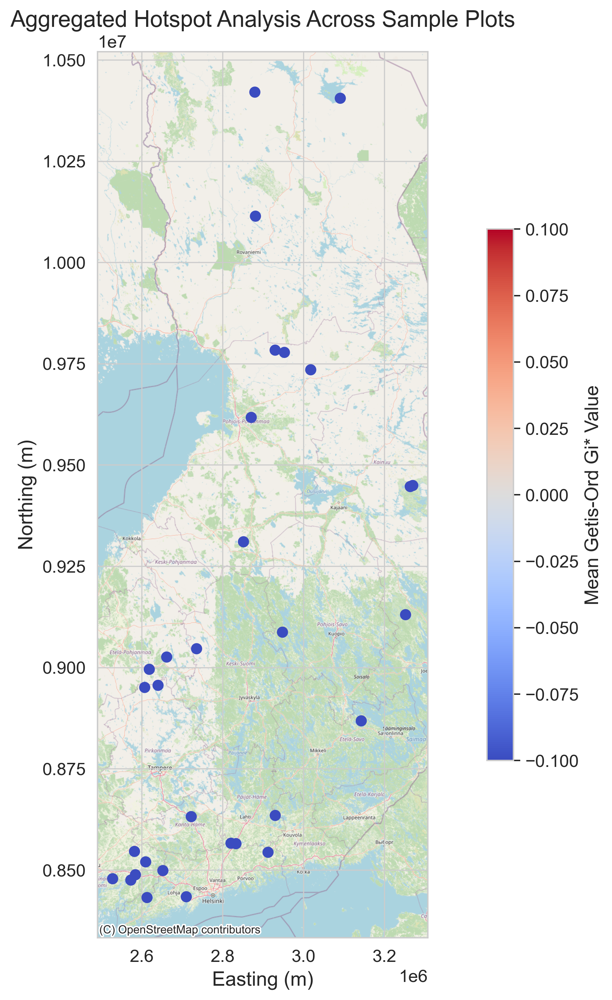

In [50]:
# Create a GeoDataFrame from the aggregated hotspot summary
geometry = [Point(xy) for xy in zip(hotspot_df['centroid_x'], hotspot_df['centroid_y'])]
gdf_hotspots = gpd.GeoDataFrame(hotspot_df, geometry=geometry, crs="EPSG:3067")

# Reproject to Web Mercator (EPSG:3857) for compatibility with OSM basemap
gdf_hotspots = gdf_hotspots.to_crs(epsg=3857)

# Plot the aggregated hotspots on a map
fig, ax = plt.subplots(1, 1, figsize=(12, 10), dpi=300)
# Use a diverging colormap to highlight high and low values (e.g., coolwarm)
gdf_hotspots.plot(
    column='mean_GiStar', 
    cmap="coolwarm", 
    markersize=50, 
    legend=True,
    legend_kwds={'label': "Mean Getis-Ord Gi* Value", "shrink": 0.6},
    ax=ax
)

ax.set_title("Aggregated Hotspot Analysis Across Sample Plots", fontsize=16)
ax.set_xlabel("Easting (m)", fontsize=14)
ax.set_ylabel("Northing (m)", fontsize=14)

# Add an OpenStreetMap basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

plt.tight_layout()
plt.savefig(os.path.join(output_dir, "aggregated_hotspots.png"), dpi=300)
plt.show()

Adjusting data for anisotropy...
Initializing variogram model...
Coordinates type: 'euclidean' 

Using 'power' Variogram Model
Scale: 0.002641498645188745
Exponent: 0.0221135916315491
Nugget: 0.0796472498668519 

Calculating statistics on variogram model fit...
Executing Ordinary Kriging...



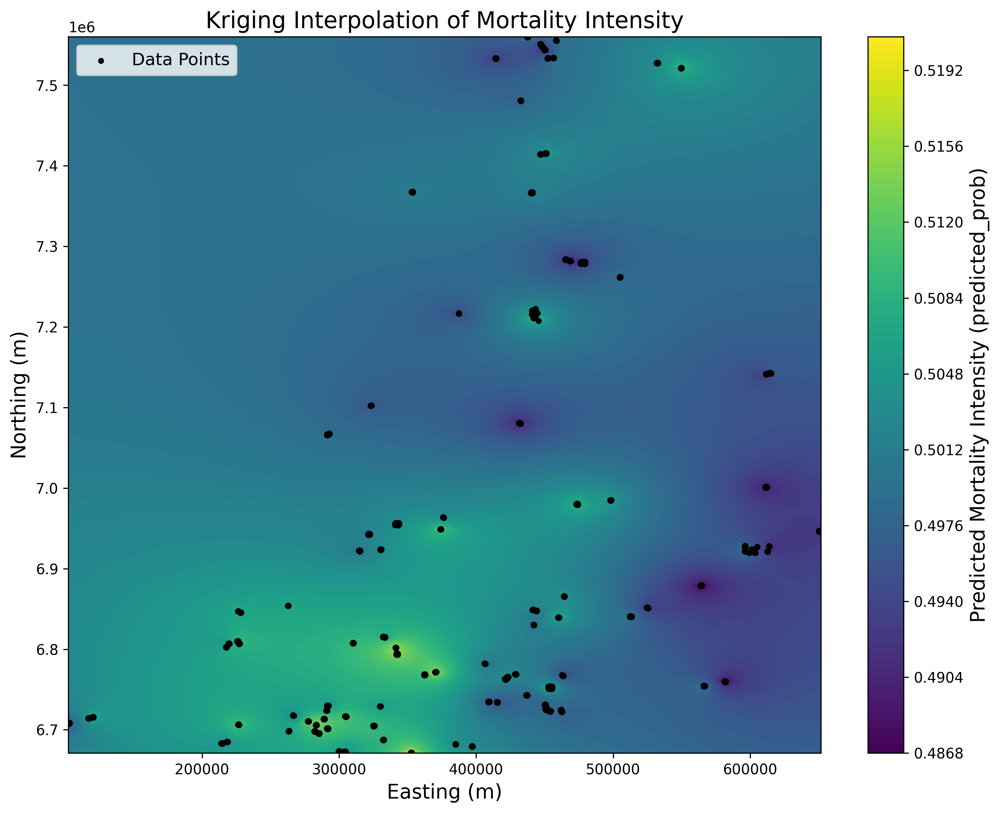

Fitted Variogram Parameters:
[0.0026415  0.02211359 0.07964725]
Variogram Model: power


In [5]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from pykrige.ok import OrdinaryKriging

# -------------------------
# Set up output directory and style
# -------------------------
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# -------------------------
# Data Loading and Preparation
# -------------------------
csv_path = "./output/clusters_with_distance.csv"  # Update as needed
df = pd.read_csv(csv_path)

# Ensure spatial coordinates exist and are in EPSG:3067; also ensure a measure of mortality intensity is available.
# Here we assume 'x', 'y', and 'predicted_prob' are present.
if 'predicted_prob' not in df.columns:
    # If not available, simulate predicted probabilities for demonstration.
    np.random.seed(42)
    df['predicted_prob'] = np.random.uniform(0, 1, size=len(df))

# Extract coordinates and the variable of interest
x = df['x'].values
y = df['y'].values
z = df['predicted_prob'].values

# Define the study area bounds based on the data coordinates.
xmin, xmax = x.min(), x.max()
ymin, ymax = y.min(), y.max()

# -------------------------
# Kriging Interpolation and Variogram Analysis
# -------------------------
# Define a grid for kriging interpolation: here, we use a 100x100 grid.
gridx = np.linspace(xmin, xmax, 100)
gridy = np.linspace(ymin, ymax, 100)

# Fit an Ordinary Kriging model using a power variogram model.
# The choice of variogram model (e.g., "power", "spherical", "exponential") can be refined via sensitivity analysis.
ok = OrdinaryKriging(x, y, z, variogram_model='power', verbose=True, enable_plotting=False)

# Execute kriging to obtain a predicted surface and kriging variance.
z_pred, ss = ok.execute('grid', gridx, gridy)

# -------------------------
# Plot the Kriged Surface
# -------------------------
plt.figure(figsize=(10, 8), dpi=300)
contour = plt.contourf(gridx, gridy, z_pred, cmap='viridis', levels=100)
plt.scatter(x, y, c='k', s=10, label='Data Points')
cbar = plt.colorbar(contour)
cbar.set_label('Predicted Mortality Intensity (predicted_prob)', fontsize=14)
plt.title("Kriging Interpolation of Mortality Intensity", fontsize=16)
plt.xlabel("Easting (m)", fontsize=14)
plt.ylabel("Northing (m)", fontsize=14)
plt.legend(fontsize=12)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "kriging_interpolation.png"), dpi=300)
plt.show()

# -------------------------
# Variogram Analysis Information
# -------------------------
# Although pykrige does not directly provide an empirical variogram plot,
# we can print the fitted variogram model parameters for further interpretation.
print("Fitted Variogram Parameters:")
print(ok.variogram_model_parameters)
print("Variogram Model:", ok.variogram_model)

# Note: For a more detailed empirical variogram analysis and plot,
# you could use additional libraries such as GSTools.

In [23]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import arviz as az
import pymc as pm
import aesara.tensor as at
import geopandas as gpd

# Set up output directory
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Load the CSV file
csv_path = "./output/clusters_with_distance.csv"  # Update path as needed
df = pd.read_csv(csv_path)

# Standardize event type and create binary target (1 = Clustered, 0 = Isolated)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# Ensure spatial coordinates exist; assume columns 'x' and 'y' are in EPSG:3067.
# Also, check if a 'stand_id' column exists; if not, simulate one (e.g., 50 random stands)
if 'stand_id' not in df.columns:
    np.random.seed(42)
    df['stand_id'] = np.random.randint(0, 50, size=len(df))

# Define features for analysis
features = ["distance_to_forest_edge", "distance_to_nearest_wetland", "distance_to_rocky_outcrop"]

# Drop missing or infinite values
df_clean = df.replace([np.inf, -np.inf], np.nan).dropna(subset=features + ['target', 'x', 'y', 'stand_id']).reset_index(drop=True)

# Standardize predictors (create new columns ending with '_z')
for col in features:
    df_clean[col + '_z'] = (df_clean[col] - df_clean[col].mean()) / df_clean[col].std()

# Prepare data arrays
coords = df_clean[['x', 'y']].values
X = df_clean[['distance_to_forest_edge_z', 'distance_to_nearest_wetland_z', 'distance_to_rocky_outcrop_z']].values
y = df_clean['target'].values

# Map stand_id to consecutive indices for hierarchical modeling
unique_stands = np.sort(df_clean['stand_id'].unique())
n_stands = len(unique_stands)
stand_idx = pd.Categorical(df_clean['stand_id'], categories=unique_stands).codes

# Build the Bayesian Hierarchical Model using PyMC (v4)
with pm.Model() as model:
    # Global intercept
    intercept = pm.Normal("intercept", mu=0, sigma=10)
    
    # Fixed effects for standardized predictors
    beta = pm.Normal("beta", mu=0, sigma=5, shape=X.shape[1])
    
    # Random intercept for stands (hierarchical effect)
    sigma_stand = pm.HalfNormal("sigma_stand", sigma=1)
    stand_effect = pm.Normal("stand_effect", mu=0, sigma=sigma_stand, shape=n_stands)
    
    # Spatial Gaussian Process for spatial autocorrelation
    ℓ = pm.Gamma("ℓ", alpha=2, beta=1)
    η = pm.HalfNormal("η", sigma=1)
    cov_func = η**2 * pm.gp.cov.Matern52(2, ℓ)
    gp = pm.gp.Latent(cov_func=cov_func)
    f = gp.prior("f", X=coords)
    
    # Linear predictor combining global, fixed, random, and spatial effects
    mu = intercept + at.dot(X, beta) + stand_effect[stand_idx] + f
    
    # Logistic likelihood for binary outcome
    p = pm.math.sigmoid(mu)
    likelihood = pm.Bernoulli("likelihood", p=p, observed=y)
    
    # Sample from the posterior using NUTS
    trace = pm.sample(1000, tune=1000, target_accept=0.9, cores=2, return_inferencedata=True)
    
    # Posterior predictive sampling (optional)
    ppc = pm.sample_posterior_predictive(trace)

# Summarize and plot the results
print(az.summary(trace, var_names=["intercept", "beta", "sigma_stand", "ℓ", "η"]))
az.plot_trace(trace, var_names=["intercept", "beta", "sigma_stand", "ℓ", "η"])
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "bayesian_model_trace.png"), dpi=300)
plt.show()

ModuleNotFoundError: No module named 'numpy.distutils'

Fixed GeoDataFrame:
                x             y  cluster event_type  patch_id      Filename  \
0  330314.623992  6.923407e+06       -1   Isolated  943348e2  943348e2.tif   
1  330378.590535  6.923331e+06       -1   Isolated  52e65afd  52e65afd.tif   
2  330558.152174  6.923341e+06       -1   Isolated  b3cf4315  b3cf4315.tif   
3  330363.006550  6.923373e+06       -1   Isolated  7762826c  7762826c.tif   
4  330553.576491  6.923469e+06       -1   Isolated  96f7ae1c  96f7ae1c.tif   

   distance_to_forest_edge  distance_to_rocky_outcrop  \
0                     48.0                  97.672924   
1                     16.0                   2.000000   
2                    112.0                 172.742583   
3                      0.0                  39.395431   
4                      0.0                 114.542569   

   distance_to_nearest_wetland  target                        geometry  \
0                    71.021124       0   POINT (330314.624 6923407.16)   
1                  

/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_32161/1456947152.py:80: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="event_type", y=f'density_{r}m', data=gdf, palette="Set2",


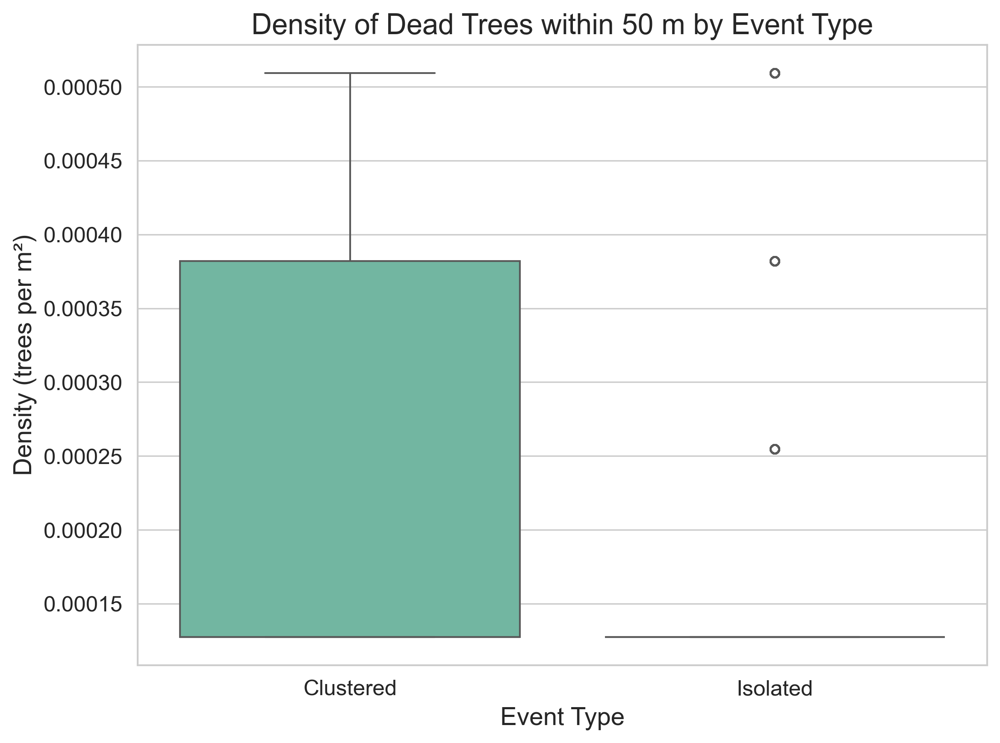

/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_32161/1456947152.py:80: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="event_type", y=f'density_{r}m', data=gdf, palette="Set2",


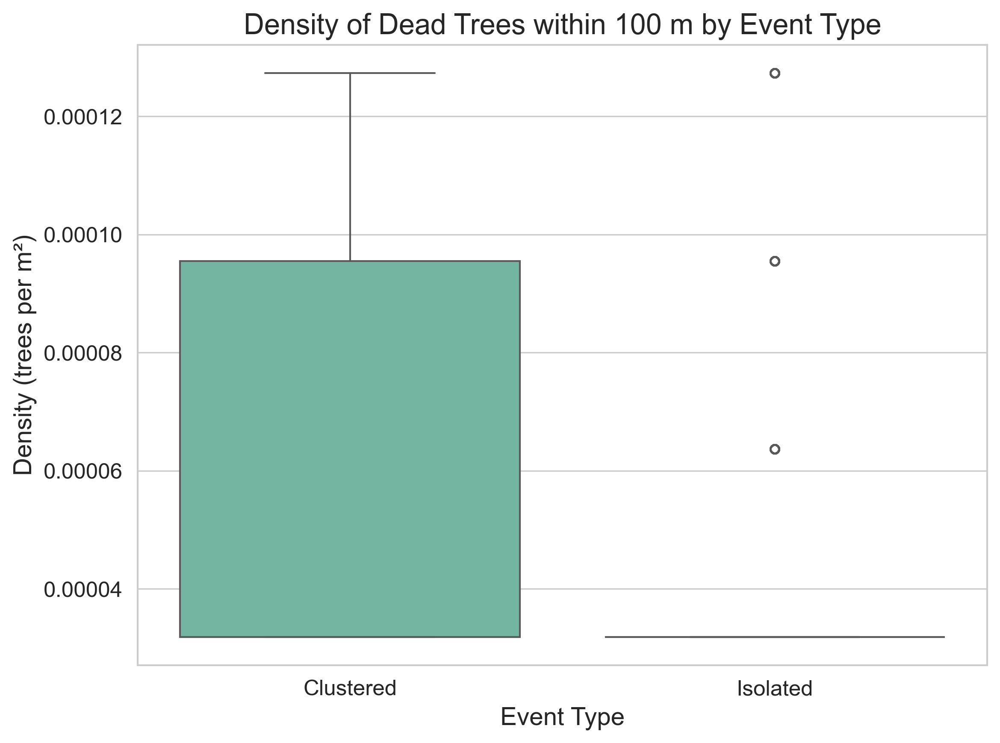

/var/folders/b1/qgbsvl0n4hlf_mxy5hyf7_740000gn/T/ipykernel_32161/1456947152.py:80: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="event_type", y=f'density_{r}m', data=gdf, palette="Set2",


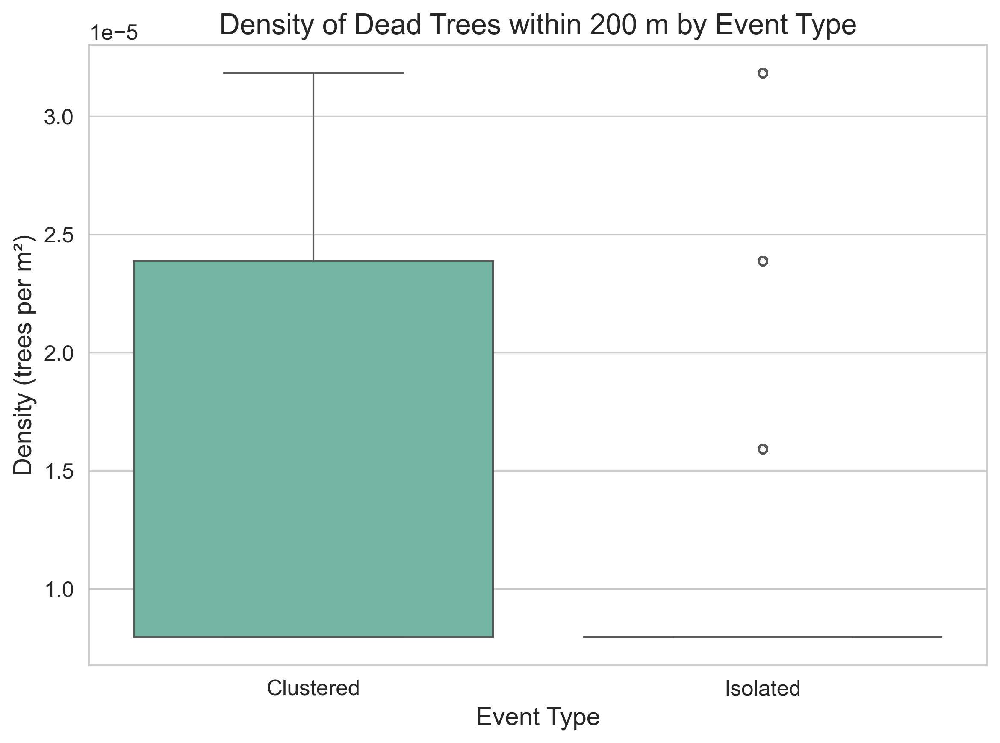

In [20]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Point

# -------------------------
# Set up output directory and style
# -------------------------
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# -------------------------
# Data Loading and Preparation
# -------------------------
csv_path = "./output/clusters_with_distance.csv"
df = pd.read_csv(csv_path)

# Capitalize event type and assign target labels
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# ✅ Ensure spatial coordinates exist; define geometry column
geometry = [Point(xy) for xy in zip(df['x'], df['y'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:3067")
gdf.set_geometry("geometry", inplace=True)

# -------------------------
# Multiscale Analysis: Compute Local Density within Different Buffer Radii
# -------------------------
buffer_radii = [50, 100, 200]
density_results = pd.DataFrame()

for r in buffer_radii:
    # ✅ Ensure buffer geometry is created and assigned correctly
    gdf[f'buffer_{r}m'] = gdf.geometry.buffer(r)

    # ✅ Ensure gdf has geometry before spatial join
    gdf.set_geometry("geometry", inplace=True)

    # ✅ Fix spatial join: Include both buffer and geometry in gdf selection
    join_gdf = gpd.sjoin(gdf[[f'buffer_{r}m', 'geometry']], gdf[['geometry']], how='left', predicate='intersects')

    # ✅ Check if spatial join succeeded
    if 'geometry' not in join_gdf.columns:
        raise ValueError("Spatial join failed: 'geometry' column missing.")

    # Group by original tree and count occurrences
    counts = join_gdf.groupby(join_gdf.index).size()

    # Compute density (count per area)
    area = np.pi * r**2
    density = counts / area

    # Add density results
    gdf[f'density_{r}m'] = density
    density_results[f'density_{r}m'] = density

# ✅ Remove temporary buffer columns
buffer_cols = [f'buffer_{r}m' for r in buffer_radii]
gdf.drop(columns=buffer_cols, inplace=True)

# ✅ Ensure final GeoDataFrame has active geometry
gdf.set_geometry("geometry", inplace=True)
gdf = gdf.set_crs("EPSG:3067", allow_override=True)

print("Fixed GeoDataFrame:\n", gdf.head())

# -------------------------
# Visualization: Boxplots of Density by Event Type
# -------------------------
for r in buffer_radii:
    plt.figure(figsize=(8, 6), dpi=300)
    sns.boxplot(x="event_type", y=f'density_{r}m', data=gdf, palette="Set2",
                showfliers=True, order=["Clustered", "Isolated"])
    plt.yscale("linear")  # Ensure linear scale
    plt.title(f"Density of Dead Trees within {r} m by Event Type", fontsize=16)
    plt.xlabel("Event Type", fontsize=14)
    plt.ylabel("Density (trees per m²)", fontsize=14)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"boxplot_density_{r}m.png"), dpi=300)
    plt.show()

In [13]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Point

# Set up directories and style for publication-quality figures
output_dir = "./figures"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
sns.set_context("paper", font_scale=1.4)
sns.set_style("whitegrid")

# Load the clusters_with_distance.csv containing dead tree points
csv_path = "./output/clusters_with_distance.csv"  # Update as needed
df = pd.read_csv(csv_path)
df['event_type'] = df['event_type'].str.capitalize()
df['target'] = df['event_type'].apply(lambda x: 1 if x.startswith("Cluster") else 0)

# Create GeoDataFrame from the mortality data (assume 'x' and 'y' columns in EPSG:3067)
geometry = [Point(xy) for xy in zip(df['x'], df['y'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:3067")

# Define file paths for additional environmental layers
soil_moisture_path = "./data/soil_moisture.tif"  # Example file path; update as needed
twi_path = "./data/topographic_wetness_index.tif"  # Example file path; update as needed
landcover_path = "./data/landcover_classification.tif"  # Example file path; update as needed

# Function to read and reproject a raster layer to EPSG:3067 if necessary
def load_raster(filepath, target_crs="EPSG:3067"):
    with rasterio.open(filepath) as src:
        if src.crs != target_crs:
            # Reproject if needed (this code assumes reprojecting using rasterio.warp.reproject, but here we keep it simple)
            # In production, use rasterio.warp.reproject to transform the data.
            print(f"Warning: Raster {filepath} is not in {target_crs}. Reprojection is required.")
        data = src.read(1)
        transform = src.transform
    return data, transform

# Load the environmental layers
soil_moisture, soil_transform = load_raster(soil_moisture_path)
twi, twi_transform = load_raster(twi_path)
landcover, lc_transform = load_raster(landcover_path)

# Plot the mortality clusters over each environmental layer
fig, axs = plt.subplots(1, 3, figsize=(18, 6), dpi=300)

# Plot Soil Moisture Layer with clusters
with rasterio.open(soil_moisture_path) as src:
    show(src, ax=axs[0], title="Soil Moisture", cmap="Blues")
gdf.plot(ax=axs[0], marker='o', color='red', markersize=5, label="Mortality Points")
axs[0].legend(fontsize=12)

# Plot Topographic Wetness Index (TWI) Layer with clusters
with rasterio.open(twi_path) as src:
    show(src, ax=axs[1], title="Topographic Wetness Index", cmap="viridis")
gdf.plot(ax=axs[1], marker='o', color='red', markersize=5, label="Mortality Points")
axs[1].legend(fontsize=12)

# Plot Landcover Classification Layer with clusters
with rasterio.open(landcover_path) as src:
    show(src, ax=axs[2], title="Landcover Classification", cmap="Set3")
gdf.plot(ax=axs[2], marker='o', color='red', markersize=5, label="Mortality Points")
axs[2].legend(fontsize=12)

plt.tight_layout()
plt.savefig(os.path.join(output_dir, "env_layers_with_clusters.png"), dpi=300)
plt.show()

# Optional: Post-hoc statistical analysis comparing mortality cluster intensity with environmental metrics
# For example, extract raster values at each dead tree location using rasterio.sample
def extract_raster_values(gdf, raster_path):
    values = []
    with rasterio.open(raster_path) as src:
        for geom in gdf.geometry:
            # Transform geometry to raster space coordinates
            for val in src.sample([(geom.x, geom.y)]):
                values.append(val[0])
    return np.array(values)

gdf['soil_moisture'] = extract_raster_values(gdf, soil_moisture_path)
gdf['twi'] = extract_raster_values(gdf, twi_path)
gdf['landcover'] = extract_raster_values(gdf, landcover_path)

# Plot distributions of soil moisture for clustered vs. isolated events
plt.figure(figsize=(8, 6), dpi=300)
sns.boxplot(x='event_type', y='soil_moisture', data=gdf, palette="Set2")
plt.title("Soil Moisture by Mortality Event Type", fontsize=16)
plt.xlabel("Event Type", fontsize=14)
plt.ylabel("Soil Moisture", fontsize=14)
plt.tight_layout()
plt.savefig(os.path.join(output_dir, "boxplot_soil_moisture.png"), dpi=300)
plt.show()

RasterioIOError: ./data/soil_moisture.tif: No such file or directory